# Credit Risk Modeling - credit risk using customer profile (with XAI)

<p> Dataset : German credit data with risk </p> ---

 AIM : perform credit risk analysis of Loan application with basic customer profile

In [1]:
import sys, os
import numpy as np 
import pandas as pd 
import seaborn as sns
import plotly.express as exp
import plotly.graph_objs as go 
import plotly.tools as tls
import plotly.offline as py 
import xai
import warnings
warnings.filterwarnings('ignore')
from collections import Counter
from matplotlib import pyplot as plt
%matplotlib inline
py.init_notebook_mode(connected=True)


# ======== Credit risk modelling with traditional ML ========

# Exploratory data analytics

In [2]:
df = pd.read_csv("../german-risk-data/SouthGermanCredit/SouthGermanCredit.csv")
df.reset_index(drop=True, inplace=True)
df.head()

,checking_account,duration,credit_history,purpose,amount,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,...,property,age,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,credit_risk
0,no checking account,18,all credits at this bank paid back duly,car (used),1049,unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,...,car or other,21,none,for free,1,skilled employee/official,0 to 2,no,no,good
1,no checking account,9,all credits at this bank paid back duly,others,2799,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,...,unknown / no property,36,none,for free,2-3,skilled employee/official,3 or more,no,no,good
2,... < 0 DM,12,no credits taken/all credits paid back duly,retraining,841,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,...,unknown / no property,23,none,for free,1,unskilled - resident,0 to 2,no,no,good
3,no checking account,12,all credits at this bank paid back duly,others,2122,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,...,unknown / no property,39,none,for free,2-3,unskilled - resident,3 or more,no,yes,good
4,no checking account,12,all credits at this bank paid back duly,others,2171,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,...,car or other,38,bank,rent,2-3,unskilled - resident,0 to 2,no,yes,good


In [3]:
df.isna().sum()

checking_account           0
duration                   0
credit_history             0
purpose                    0
amount                     0
savings_account            0
employment_duration        0
installment_rate           0
personal_status_sex        0
other_debtors              0
present_residence          0
property                   0
age                        0
other_installment_plans    0
housing                    0
number_credits             0
job                        0
people_liable              0
telephone                  0
foreign_worker             0
credit_risk                0
dtype: int64

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 21 columns):
checking_account           1000 non-null object
duration                   1000 non-null int64
credit_history             1000 non-null object
purpose                    1000 non-null object
amount                     1000 non-null int64
savings_account            1000 non-null object
employment_duration        1000 non-null object
installment_rate           1000 non-null object
personal_status_sex        1000 non-null object
other_debtors              1000 non-null object
present_residence          1000 non-null object
property                   1000 non-null object
age                        1000 non-null int64
other_installment_plans    1000 non-null object
housing                    1000 non-null object
number_credits             1000 non-null object
job                        1000 non-null object
people_liable              1000 non-null object
telephone                  1000 n

In [5]:
#categorical_cols = ['checking_account','credit_history','purpose','savings_account','employment_duration','installment_rate','personal_status_sex','other_debtors','present_residence','property','other_installment_plans','housing','number_credits','job','people_liable','telephone','foreign_worker']

In [6]:
categorical_cols = ['checking_account','credit_history','purpose','savings_account','employment_duration','installment_rate','personal_status_sex','other_debtors','present_residence','property','other_installment_plans','housing','number_credits','job','people_liable','telephone','foreign_worker']
ordinal_cols = ['duration','amount','age']
label = 'credit_risk'
print('Total columns considered {0}, Actual columns {1}'.format(len(categorical_cols+ordinal_cols+[label]),21))
df = df.reindex(columns=categorical_cols+ordinal_cols+[label])
df[categorical_cols+[label]] = df[categorical_cols+[label]].astype('category')
df.info()

Total columns considered 21, Actual columns 21
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 21 columns):
checking_account           1000 non-null category
credit_history             1000 non-null category
purpose                    1000 non-null category
savings_account            1000 non-null category
employment_duration        1000 non-null category
installment_rate           1000 non-null category
personal_status_sex        1000 non-null category
other_debtors              1000 non-null category
present_residence          1000 non-null category
property                   1000 non-null category
other_installment_plans    1000 non-null category
housing                    1000 non-null category
number_credits             1000 non-null category
job                        1000 non-null category
people_liable              1000 non-null category
telephone                  1000 non-null category
foreign_worker             1000 non-null catego

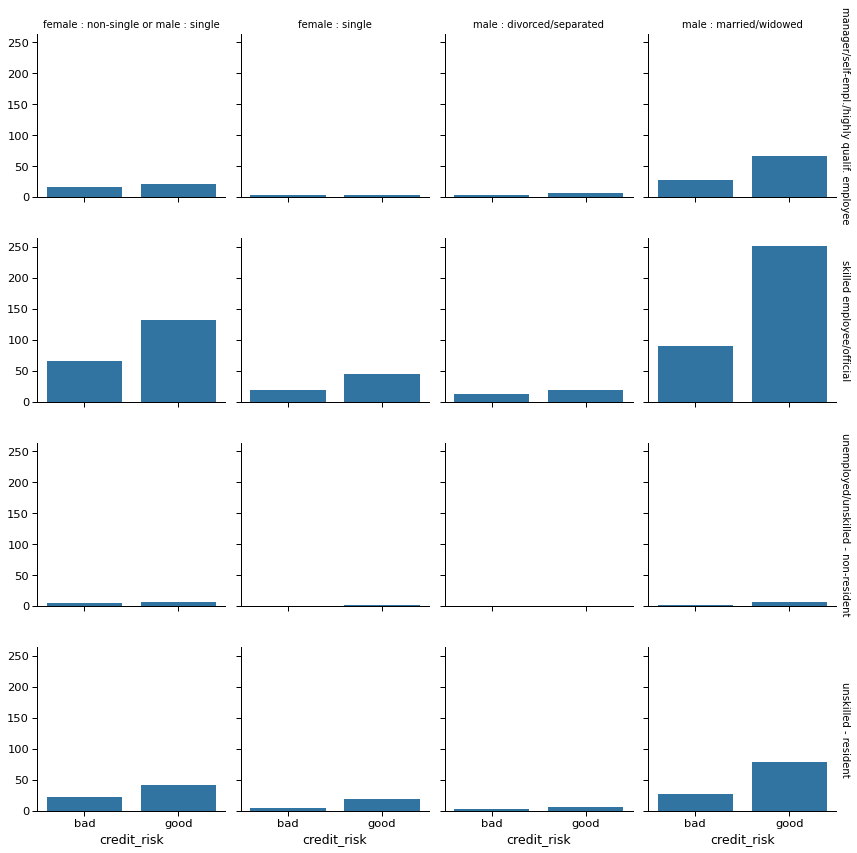

In [7]:
with sns.plotting_context('paper', font_scale = 1.3):
    g = sns.FacetGrid(data = df,
                      col = 'personal_status_sex',
                      row = 'job',
                      margin_titles=True)
g = g.map(sns.countplot, "credit_risk")
[plt.setp(ax.texts, text="") for ax in g.axes.flat] # remove the original texts
                                                    # important to add this before setting titles
g.set_titles(row_template = '{row_name}', col_template = '{col_name}')

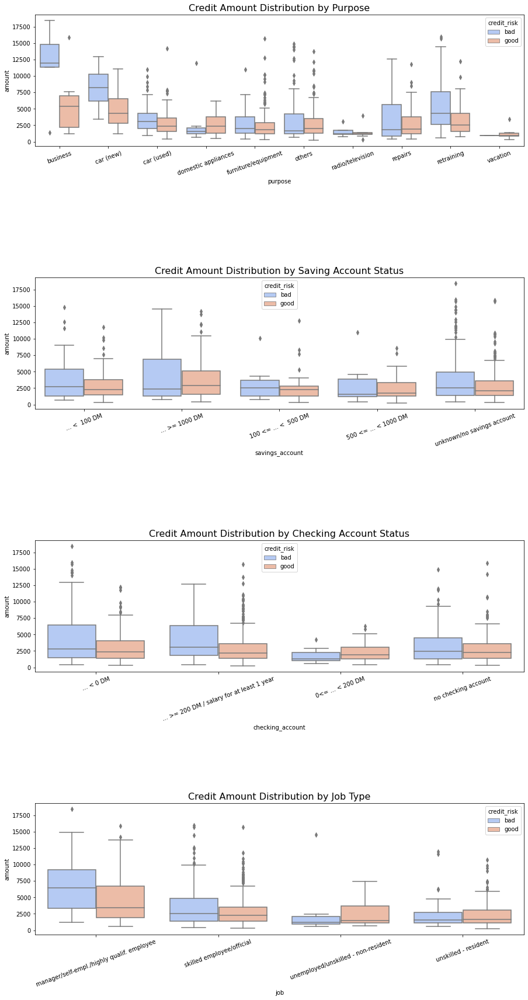

In [8]:
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4,1, figsize=(15,25))

sns.boxplot(x="purpose", y="amount", data=df, hue="credit_risk", palette="coolwarm", ax=ax1)
sns.boxplot(x="savings_account", y="amount", data=df, hue="credit_risk", palette="coolwarm", ax=ax2)
sns.boxplot(x="checking_account", y="amount", data=df, hue="credit_risk", palette="coolwarm", ax=ax3)
sns.boxplot(x="job", y="amount", data=df, hue="credit_risk", palette="coolwarm", ax=ax4)

ax1.set_title("Credit Amount Distribution by Purpose", fontsize=16)
ax2.set_title("Credit Amount Distribution by Saving Account Status", fontsize=16)
ax3.set_title("Credit Amount Distribution by Checking Account Status", fontsize=16)
ax4.set_title("Credit Amount Distribution by Job Type", fontsize=16)

ax1.set_xticklabels(ax1.get_xticklabels(), rotation=20)
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=20)
ax3.set_xticklabels(ax3.get_xticklabels(), rotation=20)
ax4.set_xticklabels(ax4.get_xticklabels(), rotation=20)

plt.subplots_adjust(hspace = 1, top = 1)
plt.show()

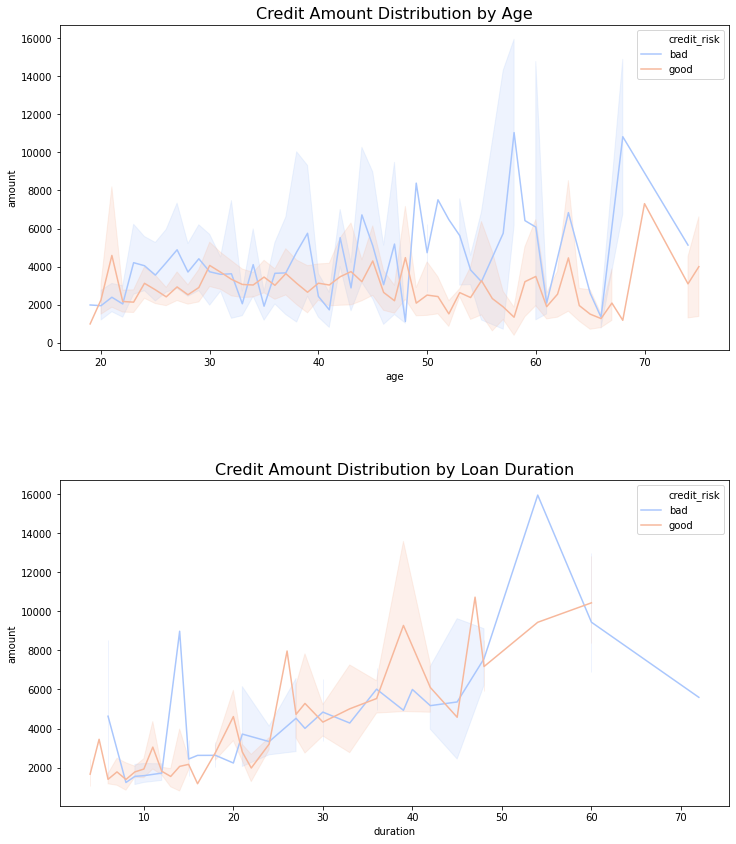

In [9]:
fig, (ax1, ax2) = plt.subplots(2,1, figsize=(12,14))

sns.lineplot(x="age", y="amount", data=df, hue="credit_risk", palette="coolwarm", ax=ax1)
sns.lineplot(x="duration", y="amount", data=df, hue="credit_risk", palette="coolwarm", ax=ax2)

ax1.set_title("Credit Amount Distribution by Age", fontsize=16)
ax2.set_title("Credit Amount Distribution by Loan Duration", fontsize=16)

plt.subplots_adjust(wspace = 0.4, hspace = 0.4,top = 0.9)
plt.show()

In [10]:
df.head(5)

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,...,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,...,for free,1,skilled employee/official,0 to 2,no,no,18,1049,21,good
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,for free,2-3,skilled employee/official,3 or more,no,no,9,2799,36,good
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,...,for free,1,unskilled - resident,0 to 2,no,no,12,841,23,good
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,for free,2-3,unskilled - resident,3 or more,no,yes,12,2122,39,good
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,...,rent,2-3,unskilled - resident,0 to 2,no,yes,12,2171,38,good


In [11]:
df1 = df.copy(deep=True)
df1.head(5)

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,...,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,...,for free,1,skilled employee/official,0 to 2,no,no,18,1049,21,good
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,for free,2-3,skilled employee/official,3 or more,no,no,9,2799,36,good
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,...,for free,1,unskilled - resident,0 to 2,no,no,12,841,23,good
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,for free,2-3,unskilled - resident,3 or more,no,yes,12,2122,39,good
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,...,rent,2-3,unskilled - resident,0 to 2,no,yes,12,2171,38,good


In [12]:
# getting dummies for all the categorical variables

dummies_columns = categorical_cols
for col in dummies_columns:
    df1 = df1.merge(pd.get_dummies(df1[col], drop_first=True, prefix=str(col)), left_index=True, right_index=True) 


# encoding risk as binary
r = {"good":0, "bad": 1}
df1[label] = df1[label].map(r)

df1.drop(columns=dummies_columns,inplace=True)

df1.head(10)

,duration,amount,age,credit_risk,checking_account_... >= 200 DM / salary for at least 1 year,checking_account_0<= ... < 200 DM,checking_account_no checking account,credit_history_critical account/other credits elsewhere,credit_history_delay in paying off in the past,credit_history_existing credits paid back duly till now,...,housing_rent,number_credits_2-3,number_credits_4-5,number_credits_>= 6,job_skilled employee/official,job_unemployed/unskilled - non-resident,job_unskilled - resident,people_liable_3 or more,telephone_yes (under customer name),foreign_worker_yes
0,18,1049,21,0,0,0,1,0,0,0,...,0,0,0,0,1,0,0,0,0,0
1,9,2799,36,0,0,0,1,0,0,0,...,0,1,0,0,1,0,0,1,0,0
2,12,841,23,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
3,12,2122,39,0,0,0,1,0,0,0,...,0,1,0,0,0,0,1,1,0,1
4,12,2171,38,0,0,0,1,0,0,0,...,1,1,0,0,0,0,1,0,0,1
5,10,2241,48,0,0,0,1,0,0,0,...,0,1,0,0,0,0,1,1,0,1
6,8,3398,39,0,0,0,1,0,0,0,...,1,1,0,0,0,0,1,0,0,1
7,6,1361,40,0,0,0,1,0,0,0,...,1,0,0,0,0,0,1,1,0,1
8,18,1098,65,0,1,0,0,0,0,0,...,1,1,0,0,0,1,0,0,0,0
9,24,3758,23,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0


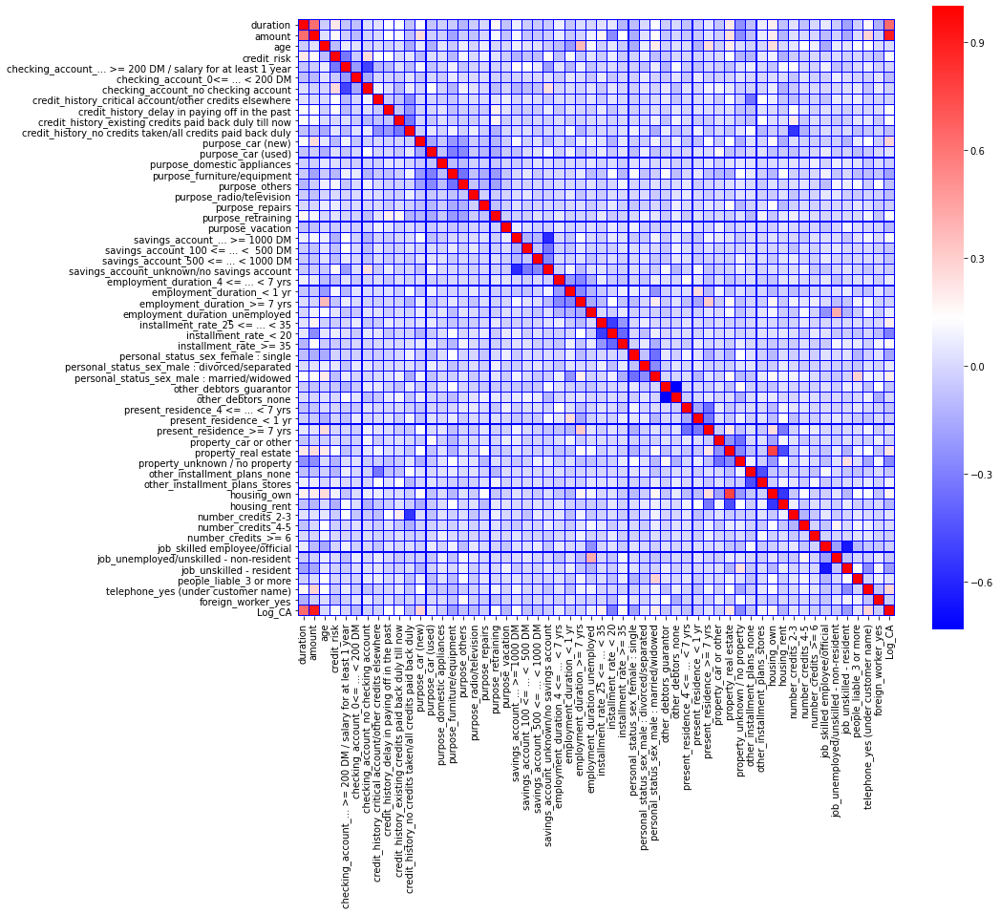

In [13]:
df1['Log_CA'] = np.log(df1['amount'])
plt.figure(figsize=(14,12))
sns.heatmap(df1.astype(float).corr(),linewidths=0.1,vmax=1.0, 
            square=True,  linecolor='blue', cmap='bwr')
plt.show()

In [14]:
interval = (18, 25, 35, 60, 120)

cats = ['Student', 'Young', 'Adult', 'Senior']
df["Age_cat"] = pd.cut(df.age, interval, labels=cats)

df_good = df[df[label] == 'good']
df_bad = df[df[label] == 'bad']

trace0 = go.Box(
    y=df_good["amount"],
    x=df_good["checking_account"],
    name='Good credit',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=df_bad['amount'],
    x=df_bad['checking_account'],
    name='Bad credit',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Loan amount(German - DM)'
    ),
     xaxis=dict(
        title='Checking Account'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-checking_account-cat')

In [15]:
trace0 = go.Box(
    y=df_good["amount"],
    x=df_good["savings_account"],
    name='Good credit',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=df_bad['amount'],
    x=df_bad['savings_account'],
    name='Bad credit',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount(German - DM)'
    ),
    xaxis=dict(
        title='Savings Account'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-savings_account-cat')

In [16]:
trace0 = go.Box(
    y=df_good["amount"],
    x=df_good["Age_cat"],
    name='Good credit',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=df_bad['amount'],
    x=df_bad['Age_cat'],
    name='Bad credit',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount(German - DM)'
    ),
    xaxis=dict(
        title='Age Category'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-age-cat')

In [17]:
trace0 = go.Box(
    y=df_good["amount"],
    x=df_good["personal_status_sex"],
    name='Good credit',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=df_bad['amount'],
    x=df_bad['personal_status_sex'],
    name='Bad credit',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount(German - DM)'
    ),
    xaxis=dict(
        title='Marital status and gender'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-personal_status_sex-cat')

In [18]:
trace0 = go.Box(
    y=df_good["amount"],
    x=df_good["present_residence"],
    name='Good credit',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=df_bad['amount'],
    x=df_bad['present_residence'],
    name='Bad credit',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount(German - DM)'
    ),
    xaxis=dict(
        title='Present Residence'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-present_residence-cat')

In [19]:
trace0 = go.Box(
    y=df_good["amount"],
    x=df_good["people_liable"],
    name='Good credit',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=df_bad['amount'],
    x=df_bad['people_liable'],
    name='Bad credit',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount(German - DM)'
    ),
    xaxis=dict(
        title='No of Dependents'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-people_liable-cat')

Total values of the most missing variable: 
checking_account
... < 0 DM                                    269
... >= 200 DM / salary for at least 1 year    394
0<= ... < 200 DM                               63
no checking account                           274
Name: checking_account, dtype: int64


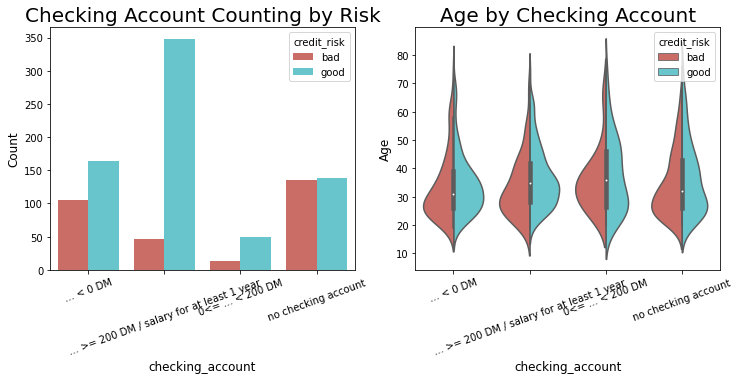

In [20]:
print("Total values of the most missing variable: ")
print(df.groupby("checking_account")["checking_account"].count())

plt.figure(figsize = (12,10))

g = plt.subplot(221)
g = sns.countplot(x="checking_account", data=df, 
              palette="hls", hue="credit_risk")
g.set_xlabel("checking_account", fontsize=12)
g.set_ylabel("Count", fontsize=12)
g.set_title("Checking Account Counting by Risk", fontsize=20)
g.set_xticklabels(g.get_xticklabels(), rotation=20)

g1 = plt.subplot(222)
g1 = sns.violinplot(x="checking_account", y="age", data=df, palette="hls", hue = "credit_risk",split=True)
g1.set_xlabel("checking_account", fontsize=12)
g1.set_ylabel("Age", fontsize=12)
g1.set_title("Age by Checking Account", fontsize=20)

plt.subplots_adjust(wspace = 0.2, hspace = 0.3, top = 0.9)
g1.set_xticklabels(g1.get_xticklabels(), rotation=20)

plt.show()

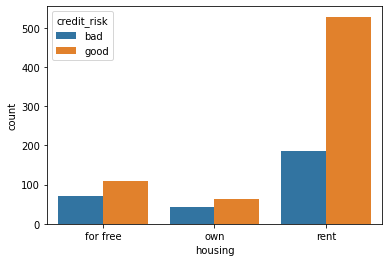

In [21]:
sns.countplot(x="housing", hue="credit_risk", data=df)
plt.show()

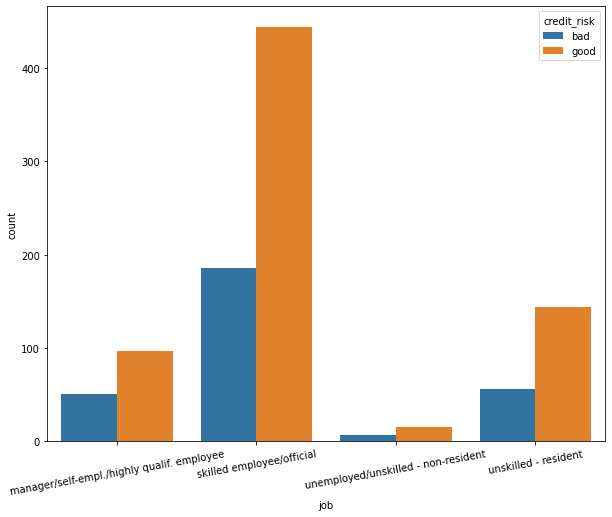

In [22]:
fig, ax1 = plt.subplots(1,1, figsize=(10,8))
sns.countplot(x="job", hue="credit_risk", data=df, ax=ax1)
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=10)
plt.show()

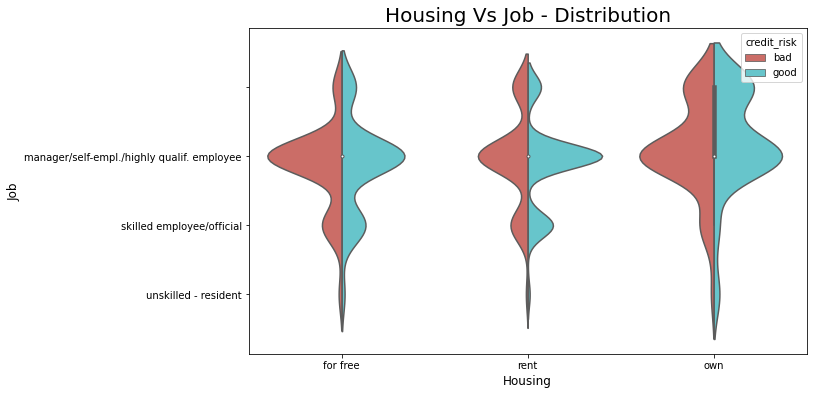

In [23]:
# encoding job as levels
r = {"unemployed/unskilled - non-resident":0, "unskilled - resident":1, "skilled employee/official": 2, "manager/self-empl./highly qualif. employee": 3}

df['Job_lvl'] = df['job'].map(r)
df['Job_lvl'] = df['Job_lvl'].fillna(0)
df['Job_lvl'] = df['Job_lvl'].astype('int64')

# encoding housing as levels
r = {"for free":0, "rent":1, "own": 2}

df['Housing_lvl'] = df['housing'].map(r)
df['Housing_lvl'] = df['Housing_lvl'].fillna(0)
df['Housing_lvl'] = df['Housing_lvl'].astype('int64')

plt.figure(figsize = (10,6))

g = sns.violinplot(x="Housing_lvl",y="Job_lvl",data=df,hue="credit_risk", palette="hls",split=True)
g.set_xlabel("Housing", fontsize=12)
g.set_ylabel("Job", fontsize=12)
g.set_title("Housing Vs Job - Distribution", fontsize=20)
g.set_xticklabels(["for free", "rent", "own"], rotation=0)
g.set_yticklabels(["unemployed/unskilled - non-resident", "unskilled - resident", "skilled employee/official", "manager/self-empl./highly qualif. employee"], rotation=0)

plt.show()

In [24]:
cm = sns.light_palette("blue", as_cmap=True)
pd.crosstab(df.personal_status_sex, df.job).style.background_gradient(cmap = cm)

job,manager/self-empl./highly qualif. employee,skilled employee/official,unemployed/unskilled - non-resident,unskilled - resident
personal_status_sex,,,,
female : non-single or male : single,37,197,12,64
female : single,6,62,2,22
male : divorced/separated,11,31,0,8
male : married/widowed,94,340,8,106


In [25]:
pd.crosstab(df.personal_status_sex, df.housing).style.background_gradient(cmap = cm)

housing,for free,own,rent
personal_status_sex,,,
female : non-single or male : single,95,19,196
female : single,23,1,68
male : divorced/separated,6,3,41
male : married/widowed,55,84,409


In [26]:
date_int = ["purpose", 'personal_status_sex']
cm = sns.light_palette("green", as_cmap=True)
pd.crosstab(df[date_int[0]], df[date_int[1]]).style.background_gradient(cmap = cm)

personal_status_sex,female : non-single or male : single,female : single,male : divorced/separated,male : married/widowed
purpose,,,,
business,3,0,1,8
car (new),24,6,3,70
car (used),74,7,15,85
domestic appliances,5,3,2,12
furniture/equipment,85,42,7,146
others,70,20,10,134
radio/television,6,1,1,4
repairs,21,1,1,27
retraining,19,9,10,59


In [27]:
pd.crosstab(df["checking_account"],df.personal_status_sex).style.background_gradient(cmap = cm)

personal_status_sex,female : non-single or male : single,female : single,male : divorced/separated,male : married/widowed
checking_account,,,,
... < 0 DM,86,34,14,135
... >= 200 DM / salary for at least 1 year,116,33,13,232
0<= ... < 200 DM,20,4,6,33
no checking account,88,21,17,148


In [28]:
df.head(5)

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,...,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,...,0 to 2,no,no,18,1049,21,good,Student,2,0
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,3 or more,no,no,9,2799,36,good,Adult,2,0
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,...,0 to 2,no,no,12,841,23,good,Student,1,0
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,3 or more,no,yes,12,2122,39,good,Adult,1,0
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,...,0 to 2,no,yes,12,2171,38,good,Adult,1,1


In [29]:
print("Purpose : ",df.purpose.unique())
print("Personal status / Sex : ",df['personal_status_sex'].unique())
print("Housing : ",df.housing.unique())
print("Saving accounts : ",df['savings_account'].unique())
print("Risk : ",df['credit_risk'].unique())
print("Checking account : ",df['checking_account'].unique())
print("Aget_cat : ",df['Age_cat'].unique())
print("Job : ",df['job'].unique())
print("Property : ",df['property'].unique())
print("Debdtors : ",df['other_debtors'].unique())

#potential numeric fields
print('===========================')
print("No of years resident : ",df['present_residence'].unique())
print("No of Dependents : ",df['people_liable'].unique())
print("Employment duration : ",df['employment_duration'].unique())
print("No of Credits: ",df['number_credits'].unique())
print("Installmen rate : ",df['installment_rate'].unique())

Purpose :  [car (used), others, retraining, furniture/equipment, car (new), business, domestic appliances, radio/television, repairs, vacation]
Categories (10, object): [car (used), others, retraining, furniture/equipment, ..., domestic appliances, radio/television, repairs, vacation]
Personal status / Sex :  [female : non-single or male : single, male : married/widowed, female : single, male : divorced/separated]
Categories (4, object): [female : non-single or male : single, male : married/widowed, female : single, male : divorced/separated]
Housing :  [for free, rent, own]
Categories (3, object): [for free, rent, own]
Saving accounts :  [unknown/no savings account, ... <  100 DM, 100 <= ... <  500 DM, ... >= 1000 DM, 500 <= ... < 1000 DM]
Categories (5, object): [unknown/no savings account, ... <  100 DM, 100 <= ... <  500 DM, ... >= 1000 DM, 500 <= ... < 1000 DM]
Risk :  [good, bad]
Categories (2, object): [good, bad]
Checking account :  [no checking account, ... < 0 DM, ... >= 200 

[Text(0, 0, '1 <= ... < 4 yrs'),
 Text(1, 0, '4 <= ... < 7 yrs'),
 Text(2, 0, '< 1 yr'),
 Text(3, 0, '>= 7 yrs')]

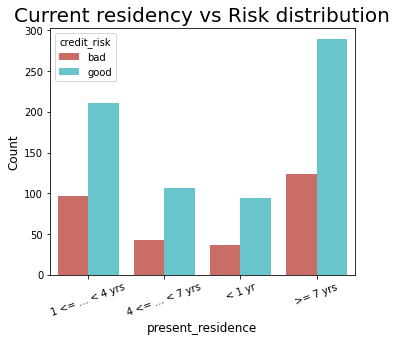

In [30]:
plt.figure(figsize = (12,10))

g = plt.subplot(221)
g = sns.countplot(x="present_residence", data=df, 
              palette="hls", hue="credit_risk")
g.set_xlabel("present_residence", fontsize=12)
g.set_ylabel("Count", fontsize=12)
g.set_title("Current residency vs Risk distribution", fontsize=20)
g.set_xticklabels(g.get_xticklabels(), rotation=20)

[Text(0, 0, '0 to 2'), Text(1, 0, '3 or more')]

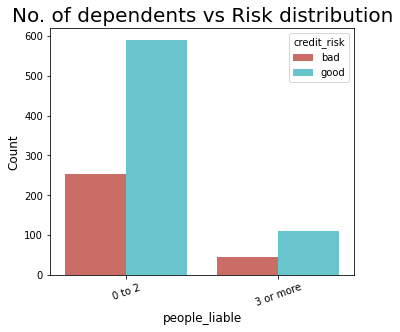

In [31]:
plt.figure(figsize = (12,10))

g = plt.subplot(221)
g = sns.countplot(x="people_liable", data=df, 
              palette="hls", hue="credit_risk")
g.set_xlabel("people_liable", fontsize=12)
g.set_ylabel("Count", fontsize=12)
g.set_title("No. of dependents vs Risk distribution", fontsize=20)
g.set_xticklabels(g.get_xticklabels(), rotation=20)

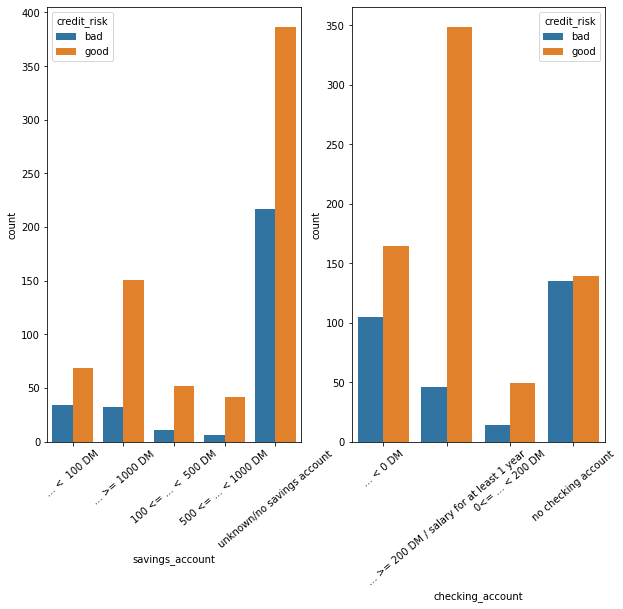

In [32]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(10,8))
sns.countplot(x="savings_account", hue="credit_risk", data=df, ax=ax1)
sns.countplot(x="checking_account", hue="credit_risk", data=df, ax=ax2)
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=40)
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=40)

fig.show()

In [33]:
df['savings_account'].unique()

[unknown/no savings account, ... <  100 DM, 100 <= ... <  500 DM, ... >= 1000 DM, 500 <= ... < 1000 DM]
Categories (5, object): [unknown/no savings account, ... <  100 DM, 100 <= ... <  500 DM, ... >= 1000 DM, 500 <= ... < 1000 DM]

In [34]:
df['checking_account'].unique()

[no checking account, ... < 0 DM, ... >= 200 DM / salary for at least 1 year, 0<= ... < 200 DM]
Categories (4, object): [no checking account, ... < 0 DM, ... >= 200 DM / salary for at least 1 year, 0<= ... < 200 DM]

In [35]:
df_saved = df.copy(deep=True)

In [36]:
#df = df_saved.copy(deep=True)
df.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,...,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,...,0 to 2,no,no,18,1049,21,good,Student,2,0
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,3 or more,no,no,9,2799,36,good,Adult,2,0
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,...,0 to 2,no,no,12,841,23,good,Student,1,0
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,3 or more,no,yes,12,2122,39,good,Adult,1,0
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,...,0 to 2,no,yes,12,2171,38,good,Adult,1,1


In [37]:

print("No of years resident : ",df['present_residence'].unique())
print("No of Dependents : ",df['people_liable'].unique())
print("Employment duration : ",df['employment_duration'].unique())
print("No of Credits: ",df['number_credits'].unique())
print("Installmen rate : ",df['installment_rate'].unique())


No of years resident :  [>= 7 yrs, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, < 1 yr]
Categories (4, object): [>= 7 yrs, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, < 1 yr]
No of Dependents :  [0 to 2, 3 or more]
Categories (2, object): [0 to 2, 3 or more]
Employment duration :  [< 1 yr, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, unemployed, >= 7 yrs]
Categories (5, object): [< 1 yr, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, unemployed, >= 7 yrs]
No of Credits:  [1, 2-3, 4-5, >= 6]
Categories (4, object): [1, 2-3, 4-5, >= 6]
Installmen rate :  [< 20, 25 <= ... < 35, 20 <= ... < 25, >= 35]
Categories (4, object): [< 20, 25 <= ... < 35, 20 <= ... < 25, >= 35]


In [38]:
# We shall convert savings_account adn checking_acco8unt fields to ordinal numerical fields

print("No of years resident : ",df['present_residence'].unique())
print("No of Dependents : ",df['people_liable'].unique())
print("Employment duration : ",df['employment_duration'].unique())
print("No of Credits: ",df['number_credits'].unique())
print("Installmen rate : ",df['installment_rate'].unique())

# encoding job as levels
r = {"500 <= ... < 1000 DM":0,"100 <= ... <  500 DM":1, "... >= 1000 DM":2, "... <  100 DM": 3, "unknown/no savings account": 4}
df['savings_account_lvl'] = df['savings_account'].map(r)

# encoding job as levels
r = {"... >= 200 DM / salary for at least 1 year":1,"0<= ... < 200 DM":2, "... < 0 DM":3, "no checking account": 4}
df['checking_account_lvl'] = df['checking_account'].map(r)

# encoding job as levels
r = {"< 20":1,"25 <= ... < 35":2, "20 <= ... < 25":3, ">= 35": 4}
df['installment_rate_value'] = df['installment_rate'].map(r)

# encoding job as levels
r = {"1":1,"2-3":2, "4-5":3, ">= 6": 4}
df['number_of_credits'] = df['number_credits'].map(r)

# encoding job as levels
r = {"0 to 2":0, "3 or more": 1}
df['No_people_liable'] = df['people_liable'].map(r)

# encoding job as levels
r = {"< 1 yr":1,"4 <= ... < 7 yrs":2, "1 <= ... < 4 yrs":3, ">= 7 yrs": 4}
df['present_residence_years'] = df['present_residence'].map(r)

# encoding job as levels
r = {"unemployed":0,"< 1 yr":1,"1 <= ... < 4 yrs":2, "4 <= ... < 7 yrs":3, ">= 7 yrs": 4}
df['employment_duration_years'] = df['employment_duration'].map(r)

del df['job']
del df['checking_account']
del df['savings_account']
del df['housing']
del df['installment_rate']
del df['number_credits']
del df['people_liable']
del df['present_residence']
del df['employment_duration']

No of years resident :  [>= 7 yrs, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, < 1 yr]
Categories (4, object): [>= 7 yrs, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, < 1 yr]
No of Dependents :  [0 to 2, 3 or more]
Categories (2, object): [0 to 2, 3 or more]
Employment duration :  [< 1 yr, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, unemployed, >= 7 yrs]
Categories (5, object): [< 1 yr, 1 <= ... < 4 yrs, 4 <= ... < 7 yrs, unemployed, >= 7 yrs]
No of Credits:  [1, 2-3, 4-5, >= 6]
Categories (4, object): [1, 2-3, 4-5, >= 6]
Installmen rate :  [< 20, 25 <= ... < 35, 20 <= ... < 25, >= 35]
Categories (4, object): [< 20, 25 <= ... < 35, 20 <= ... < 25, >= 35]


In [39]:
def one_hot_encoder(df, nan_as_category = False):
    original_columns = list(df.columns)
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns= categorical_columns, dummy_na= nan_as_category, drop_first=True)
    new_columns = [c for c in df.columns if c not in original_columns]
    return df, new_columns

In [40]:
def f_in(X, m=None):
    """Preprocess input so it can be provided to a function"""
    if m:
        return [X.iloc[:m,i] for i in range(X.shape[1])]
    else:
        return [X.iloc[:,i] for i in range(X.shape[1])]

In [41]:
df.head(5)

,credit_history,purpose,personal_status_sex,other_debtors,property,other_installment_plans,telephone,foreign_worker,duration,amount,...,Age_cat,Job_lvl,Housing_lvl,savings_account_lvl,checking_account_lvl,installment_rate_value,number_of_credits,No_people_liable,present_residence_years,employment_duration_years
0,all credits at this bank paid back duly,car (used),female : non-single or male : single,none,car or other,none,no,no,18,1049,...,Student,2,0,4,4,1,1,0,4,1
1,all credits at this bank paid back duly,others,male : married/widowed,none,unknown / no property,none,no,no,9,2799,...,Adult,2,0,4,4,2,2,1,3,2
2,no credits taken/all credits paid back duly,retraining,female : non-single or male : single,none,unknown / no property,none,no,no,12,841,...,Student,1,0,3,3,2,1,0,4,3
3,all credits at this bank paid back duly,others,male : married/widowed,none,unknown / no property,none,no,yes,12,2122,...,Adult,1,0,4,4,3,2,1,3,2
4,all credits at this bank paid back duly,others,male : married/widowed,none,car or other,bank,no,yes,12,2171,...,Adult,1,1,4,4,1,2,0,4,2


In [42]:
#df = df_saved.copy(deep=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 22 columns):
credit_history               1000 non-null category
purpose                      1000 non-null category
personal_status_sex          1000 non-null category
other_debtors                1000 non-null category
property                     1000 non-null category
other_installment_plans      1000 non-null category
telephone                    1000 non-null category
foreign_worker               1000 non-null category
duration                     1000 non-null int64
amount                       1000 non-null int64
age                          1000 non-null int64
credit_risk                  1000 non-null category
Age_cat                      1000 non-null category
Job_lvl                      1000 non-null int64
Housing_lvl                  1000 non-null int64
savings_account_lvl          1000 non-null category
checking_account_lvl         1000 non-null category
installment_rate_value   

In [43]:
# encoding risk as binary
r = {"good":0, "bad": 1}
df[label] = df[label].map(r)

In [44]:
categorical_cols_dummies = categorical_cols.copy()
[categorical_cols_dummies.remove(cols) for cols in ['job','savings_account','checking_account','housing','installment_rate','number_credits','people_liable','present_residence','employment_duration']]
categorical_cols_dummies

['credit_history',
 'purpose',
 'personal_status_sex',
 'other_debtors',
 'property',
 'other_installment_plans',
 'telephone',
 'foreign_worker']

In [45]:
categorical_cols

['checking_account',
 'credit_history',
 'purpose',
 'savings_account',
 'employment_duration',
 'installment_rate',
 'personal_status_sex',
 'other_debtors',
 'present_residence',
 'property',
 'other_installment_plans',
 'housing',
 'number_credits',
 'job',
 'people_liable',
 'telephone',
 'foreign_worker']

In [46]:
#df['savings_account_lvl'] = df['savings_account_lvl'].fillna('no_inf')
#df['checking_account_lvl'] = df['checking_account_lvl'].fillna('no_inf')

for cols in categorical_cols_dummies:
    df = df.merge(pd.get_dummies(df[cols], drop_first=True, prefix=cols), left_index=True, right_index=True)
    
#Purpose to Dummies Variable
#df = df.merge(pd.get_dummies(df.Purpose, drop_first=True, prefix='purpose'), left_index=True, right_index=True)
#Sex feature in dummies
#df = df.merge(pd.get_dummies(df.Sex, drop_first=True, prefix='personal_status_sex'), left_index=True, right_index=True)
## Housing get dummies
#df = df.merge(pd.get_dummies(df.Housing, drop_first=True, prefix='housing'), left_index=True, right_index=True)
## Housing get Saving Accounts
#df = df.merge(pd.get_dummies(df["savings_account"], drop_first=True, prefix='savings_account'), left_index=True, right_index=True)
## Housing get Risk
#df = df.merge(pd.get_dummies(df.Risk, prefix='credit_risk'), left_index=True, right_index=True)
## Housing get Checking Account
#df = df.merge(pd.get_dummies(df["checking_account"], drop_first=True, prefix='checking_account'), left_index=True, right_index=True)
## Housing get Age categorical
#df = df.merge(pd.get_dummies(df["Age_cat"], drop_first=True, prefix='Age_cat'), left_index=True, right_index=True)
## Housing get Age categorical
#df = df.merge(pd.get_dummies(df["Age_cat"], drop_first=True, prefix='Age_cat'), left_index=True, right_index=True)

In [47]:
del df['credit_history']
del df['purpose'] 
del df['personal_status_sex']
del df['other_debtors']
del df['property']
del df['other_installment_plans']     
del df['telephone']     
del df['foreign_worker']
del df['Age_cat']

In [48]:
df.info(10)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 38 columns):
duration                                                      1000 non-null int64
amount                                                        1000 non-null int64
age                                                           1000 non-null int64
credit_risk                                                   1000 non-null category
Job_lvl                                                       1000 non-null int64
Housing_lvl                                                   1000 non-null int64
savings_account_lvl                                           1000 non-null category
checking_account_lvl                                          1000 non-null category
installment_rate_value                                        1000 non-null category
number_of_credits                                             1000 non-null category
No_people_liable                                           

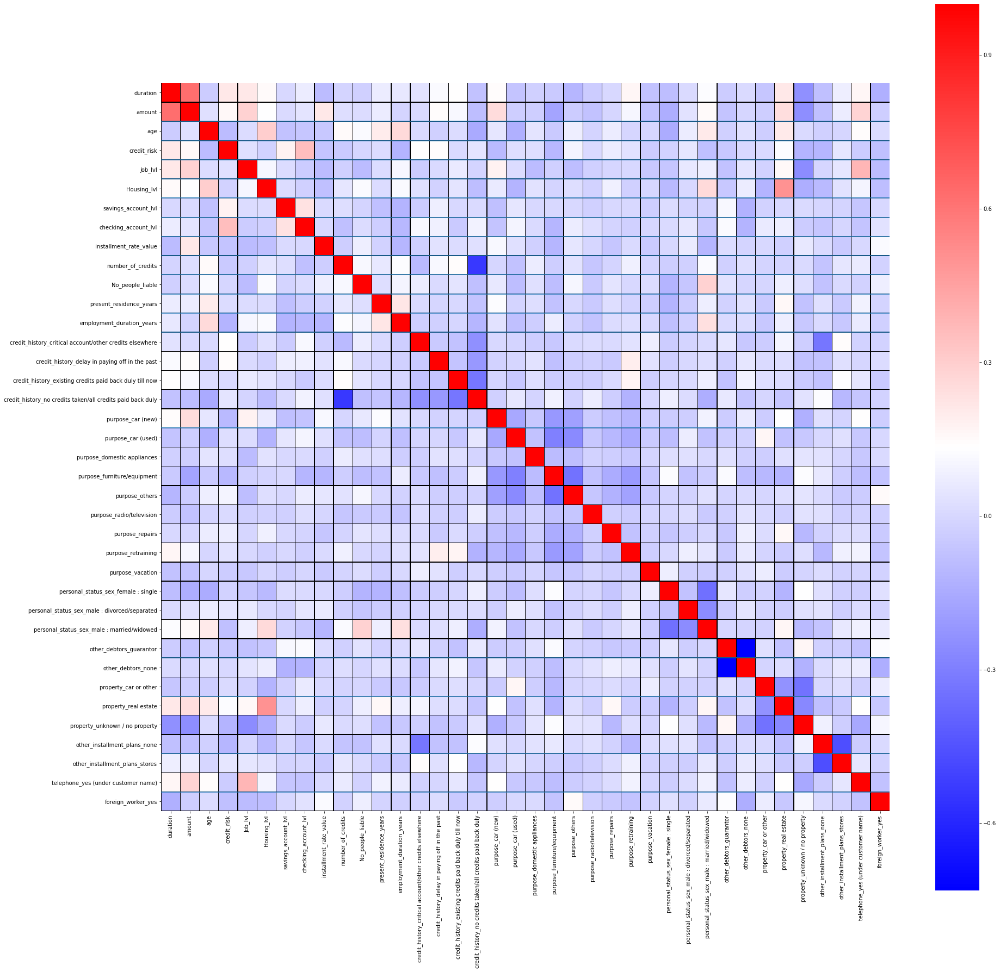

In [49]:
plt.figure(figsize=(30,30))
ax = sns.heatmap(df.astype(float).corr(),linewidths=0.3,vmax=1.0, 
            square=True,  linecolor='black', annot=False,cmap='bwr')
#ax.hlines([9,13,22,26,29,32,34,40,42,45,46,47,48,52,61,65,68,71,73,79,81,84,85,86,87,91,100,104,107,110,112,115,118,120,123,124], *ax.get_xlim())
ax.hlines([2,3,4,5,6,7,8,9,10,11,12,13,18,30,32,35,37], *ax.get_xlim())
plt.show()

# Modeling

In [50]:
#Data Preprocessing and feature engineering
from sklearn import decomposition, datasets, preprocessing
from sklearn.preprocessing import StandardScaler, label_binarize
from sklearn.pipeline import FeatureUnion, Pipeline
from sklearn.feature_selection import SelectKBest
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, cross_validate, cross_val_score, GridSearchCV, KFold, RepeatedStratifiedKFold
    
# Algorithmns models to be compared
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from xgboost import XGBClassifier

#To evaluate our model
from sklearn.utils import resample
from sklearn.metrics import accuracy_score, fbeta_score, recall_score, make_scorer, confusion_matrix, classification_report, fbeta_score, roc_curve, precision_recall_curve, average_precision_score, plot_precision_recall_curve
from itertools import cycle

In [51]:
# Use label_binarize to be multi-label like settings
#Y_classes = label_binarize(Y, classes=[1,0])
n_classes = 2
seed = 42
kfold = KFold(n_splits=10, random_state=seed)

In [52]:
df_saved.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 24 columns):
checking_account           1000 non-null category
credit_history             1000 non-null category
purpose                    1000 non-null category
savings_account            1000 non-null category
employment_duration        1000 non-null category
installment_rate           1000 non-null category
personal_status_sex        1000 non-null category
other_debtors              1000 non-null category
present_residence          1000 non-null category
property                   1000 non-null category
other_installment_plans    1000 non-null category
housing                    1000 non-null category
number_credits             1000 non-null category
job                        1000 non-null category
people_liable              1000 non-null category
telephone                  1000 non-null category
foreign_worker             1000 non-null category
duration                   1000 non-null int

In [53]:
#df['Credit amount'] = np.log(df['Credit amount'])
# label_encoder object knows how to understand word labels. 
label_encoder_personal_status_sex = preprocessing.LabelEncoder()
label_encoder_job = preprocessing.LabelEncoder()
label_encoder_housing = preprocessing.LabelEncoder()
label_encoder_savings_account = preprocessing.LabelEncoder()
label_encoder_checking_account = preprocessing.LabelEncoder()
label_encoder_purpose = preprocessing.LabelEncoder()
label_encoder_credit_history = preprocessing.LabelEncoder()
label_encoder_employment_duration = preprocessing.LabelEncoder()
label_encoder_installment_rate = preprocessing.LabelEncoder()
label_encoder_property = preprocessing.LabelEncoder()
label_encoder_other_installment_plans = preprocessing.LabelEncoder()
label_encoder_number_credits = preprocessing.LabelEncoder()
label_encoder_people_liable = preprocessing.LabelEncoder()
label_encoder_telephone = preprocessing.LabelEncoder()
label_encoder_foreign_worker = preprocessing.LabelEncoder()
#label_encoder_credit_risk = preprocessing.LabelEncoder()
label_encoder_other_debtors = preprocessing.LabelEncoder()
label_encoder_present_residence = preprocessing.LabelEncoder()

# Encode labels in column . 
proc_org_df = df_saved.copy(deep=True)
proc_org_df['personal_status_sex'] = label_encoder_personal_status_sex.fit_transform(proc_org_df['personal_status_sex']) 
proc_org_df['job'] = label_encoder_job.fit_transform(proc_org_df['job']) 
proc_org_df['housing'] = label_encoder_housing.fit_transform(proc_org_df['housing']) 
proc_org_df['savings_account'] = label_encoder_savings_account.fit_transform(proc_org_df['savings_account']) 
proc_org_df['checking_account'] =label_encoder_checking_account.fit_transform(proc_org_df['checking_account']) 
proc_org_df['purpose'] = label_encoder_purpose.fit_transform(proc_org_df['purpose']) 
#proc_org_df['credit_risk'] = label_encoder_credit_risk.fit_transform(proc_org_df['credit_risk'])
proc_org_df['credit_history'] = label_encoder_credit_history.fit_transform(proc_org_df['credit_history'])
proc_org_df['employment_duration'] = label_encoder_employment_duration.fit_transform(proc_org_df['employment_duration'])
proc_org_df['installment_rate'] = label_encoder_installment_rate.fit_transform(proc_org_df['installment_rate'])
proc_org_df['property'] = label_encoder_property.fit_transform(proc_org_df['property'])
proc_org_df['other_installment_plans'] = label_encoder_other_installment_plans.fit_transform(proc_org_df['other_installment_plans'])
proc_org_df['number_credits'] = label_encoder_number_credits.fit_transform(proc_org_df['number_credits'])
proc_org_df['people_liable'] = label_encoder_people_liable.fit_transform(proc_org_df['people_liable'])
proc_org_df['telephone'] = label_encoder_telephone.fit_transform(proc_org_df['telephone'])
proc_org_df['foreign_worker'] = label_encoder_foreign_worker.fit_transform(proc_org_df['foreign_worker'])
proc_org_df['other_debtors'] = label_encoder_other_debtors.fit_transform(proc_org_df['other_debtors'])
proc_org_df['present_residence'] = label_encoder_present_residence.fit_transform(proc_org_df['present_residence'])

# encoding risk as binary
r = {"good":0, "bad": 1}
proc_org_df[label]=proc_org_df[label].map(r)

proc_org_df.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,...,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl
0,3,0,2,4,2,2,0,2,3,1,...,0,0,0,18,1049,21,0,Student,2,0
1,3,0,5,4,0,1,3,2,0,3,...,1,0,0,9,2799,36,0,Adult,2,0
2,0,4,8,0,1,1,0,2,3,3,...,0,0,0,12,841,23,0,Student,1,0
3,3,0,5,4,0,0,3,2,0,3,...,1,0,1,12,2122,39,0,Adult,1,0
4,3,0,5,4,0,2,3,2,3,1,...,0,0,1,12,2171,38,0,Adult,1,1


In [54]:
#Creating the X and y variables
Y = proc_org_df['credit_risk'].values

del proc_org_df['credit_risk']
del proc_org_df['Age_cat']
del proc_org_df['Job_lvl']
del proc_org_df['Housing_lvl']

scaler = StandardScaler()
scaler.fit(proc_org_df)
X = pd.DataFrame(scaler.transform(proc_org_df),columns = proc_org_df.columns)

X.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,1.448029,-1.412370,-1.005257,0.747297,0.353517,0.449554,-1.348723,0.301109,1.046179,-0.318910,0.218346,-1.970582,-0.704926,-0.289639,-0.428290,-0.823318,-0.196014,-0.240857,-0.787657,-1.281573
1,1.448029,-1.412370,0.430824,0.747297,-1.134975,-0.649600,0.855073,0.301109,-1.275224,1.333473,0.218346,-1.970582,1.027079,-0.289639,2.334869,-0.823318,-0.196014,-0.987573,-0.167384,0.040363
2,-1.172047,0.835732,1.866905,-1.886349,-0.390729,-0.649600,-1.348723,0.301109,1.046179,1.333473,0.218346,-1.970582,-0.704926,1.824516,-0.428290,-0.823318,-0.196014,-0.738668,-0.861381,-1.105315
3,1.448029,-1.412370,0.430824,0.747297,-1.134975,-1.748754,0.855073,0.301109,-1.275224,1.333473,0.218346,-1.970582,1.027079,1.824516,2.334869,-0.823318,5.101669,-0.738668,-0.407341,0.304750
4,1.448029,-1.412370,0.430824,0.747297,-1.134975,0.449554,0.855073,0.301109,1.046179,-0.318910,-2.154977,0.596952,1.027079,1.824516,-0.428290,-0.823318,5.101669,-0.738668,-0.389974,0.216621


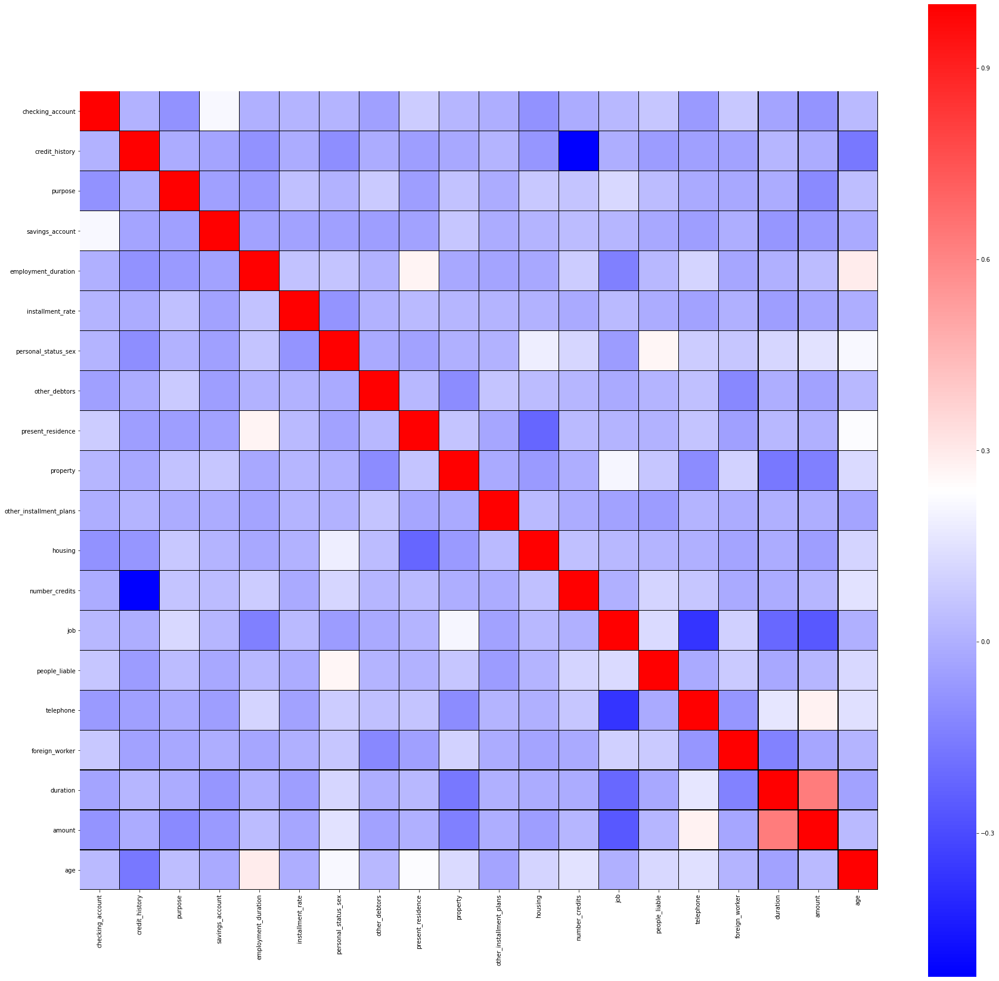

In [55]:
plt.figure(figsize=(30,30))
ax = sns.heatmap(X.astype(float).corr(),linewidths=0.3,vmax=1.0, 
            square=True,  linecolor='black', annot=False,cmap='bwr')
#ax.hlines([9,13,22,26,29,32,34,40,42,45,46,47,48,52,61,65,68,71,73,79,81,84,85,86,87,91,100,104,107,110,112,115,118,120,123,124], *ax.get_xlim())
#ax.hlines([2,3,4,5,6,7,8,9,10,11,12,13,18,30,32,35,37], *ax.get_xlim())
plt.show()

In [56]:
# Spliting X and y into train and test version
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.25, random_state=seed)

In [57]:
len(X_train)

750

In [58]:
len(X_test)

250

Model Select 1: Random Forest

In [59]:
RF = RandomForestClassifier(max_depth=None, max_features=20, n_estimators=5, random_state=seed)
#trainning with the best params
RF.fit(X_train, Y_train)

RandomForestClassifier(max_features=20, n_estimators=5, random_state=42)

In [60]:
#Testing the model 
#Predicting using our  model
Y_pred_RF = RF.predict(X_test)

# Verificaar os resultados obtidos
print(accuracy_score(Y_test,Y_pred_RF)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test,Y_pred_RF))
print("\n")
print(fbeta_score(Y_test, Y_pred_RF, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_RF))

69.19999999999999
 percent


[[142  33]
 [ 44  31]]


0.42582417582417587


              precision    recall  f1-score   support

           0       0.76      0.81      0.79       175
           1       0.48      0.41      0.45        75

    accuracy                           0.69       250
   macro avg       0.62      0.61      0.62       250
weighted avg       0.68      0.69      0.68       250



In [61]:
#Seting the Hyper Parameters
param_grid_RF = {
              "max_depth": [3,5, 7, 10,None],
              "n_estimators":[3,5,10,25,50,150],
              "max_features": [4,7,9,12,15,20]
             }

#Creating the classifier
RF_grid = RandomForestClassifier(random_state=seed)

RF_grid_search = GridSearchCV(RF_grid, param_grid=param_grid_RF, cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
RF_grid_search.fit(X_train,Y_train)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 113 tasks      | elapsed:    4.6s
[Parallel(n_jobs=-1)]: Done 359 tasks      | elapsed:    9.1s
[Parallel(n_jobs=-1)]: Done 701 tasks      | elapsed:   15.3s
[Parallel(n_jobs=-1)]: Done 1143 tasks      | elapsed:   24.2s
[Parallel(n_jobs=-1)]: Done 1681 tasks      | elapsed:   36.0s
[Parallel(n_jobs=-1)]: Done 1785 out of 1800 | elapsed:   38.9s remaining:    0.2s
[Parallel(n_jobs=-1)]: Done 1800 out of 1800 | elapsed:   40.0s finished


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [3, 5, 7, 10, None],
                         'max_features': [4, 7, 9, 12, 15, 20],
                         'n_estimators': [3, 5, 10, 25, 50, 150]},
             scoring='accuracy', verbose=4)

In [62]:
RF_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__bootstrap', 'estimator__ccp_alpha', 'estimator__class_weight', 'estimator__criterion', 'estimator__max_depth', 'estimator__max_features', 'estimator__max_leaf_nodes', 'estimator__max_samples', 'estimator__min_impurity_decrease', 'estimator__min_impurity_split', 'estimator__min_samples_leaf', 'estimator__min_samples_split', 'estimator__min_weight_fraction_leaf', 'estimator__n_estimators', 'estimator__n_jobs', 'estimator__oob_score', 'estimator__random_state', 'estimator__verbose', 'estimator__warm_start', 'estimator', 'iid', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [63]:
print(RF_grid_search.best_score_)
print(RF_grid_search.best_params_)

0.76
{'max_depth': 5, 'max_features': 12, 'n_estimators': 25}


In [64]:
#Testing the model 
#Predicting using our  model
Y_pred_RF_grid = RF_grid_search.predict(X_test)

# Verificaar os resultados obtidos
print(accuracy_score(Y_test,Y_pred_RF_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test,Y_pred_RF_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_RF_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_RF_grid))

75.2
 percent


[[164  11]
 [ 51  24]]


0.35820895522388063


              precision    recall  f1-score   support

           0       0.76      0.94      0.84       175
           1       0.69      0.32      0.44        75

    accuracy                           0.75       250
   macro avg       0.72      0.63      0.64       250
weighted avg       0.74      0.75      0.72       250



Model Select 2: Gaussian Naive Baes

In [65]:
# Naive Baes Classifier
GNB = GaussianNB()

# Fitting with train data
GNB.fit(X_train, Y_train)

GaussianNB()

In [66]:
# Printing the Training Score
print("Training score data: ")
print(GNB.score(X_train, Y_train))

Training score data: 
0.7133333333333334


In [67]:
Y_pred_GNB = GNB.predict(X_test)

print(accuracy_score(Y_test,Y_pred_GNB)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_GNB))
print("\n")
print(classification_report(Y_test, Y_pred_GNB))

68.8
 percent


[[139  36]
 [ 42  33]]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78       175
           1       0.48      0.44      0.46        75

    accuracy                           0.69       250
   macro avg       0.62      0.62      0.62       250
weighted avg       0.68      0.69      0.68       250



In [68]:
features = []
features.append(('pca', PCA(n_components=2)))
features.append(('select_best', SelectKBest(k=6)))
feature_union = FeatureUnion(features)
# create pipeline
estimators = []
estimators.append(('feature_union', feature_union))
estimators.append(('clf', GaussianNB()))
# evaluate pipeline

In [69]:
param_grid_GNB = {
    'priors': [None],
    #'feature_union__pca__n_components' : [2],
    #'feature_union__select_best__k': [6],
    'var_smoothing': np.logspace(0,-9, num=100)
}

GNB_grid = GaussianNB()

GNB_grid_search=GridSearchCV(GNB_grid,param_grid=param_grid_GNB,cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
GNB_grid_search.fit(X_train,Y_train)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


Fitting 10 folds for each of 100 candidates, totalling 1000 fits


[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    1.4s finished


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=GaussianNB(), n_jobs=-1,
             param_grid={'priors': [None],
                         'var_smoothing': array([1.00000000e+00, 8.11130831e-01, 6.57933225e-01, 5.33669923e-01,
       4.32876128e-01, 3.51119173e-01, 2.84803587e-01, 2.31012970e-01,
       1.87381742e-01, 1.51991108e-01, 1.23284674e-01, 1.00000000e-01,
       8.11130831e-02, 6.5793...
       1.23284674e-07, 1.00000000e-07, 8.11130831e-08, 6.57933225e-08,
       5.33669923e-08, 4.32876128e-08, 3.51119173e-08, 2.84803587e-08,
       2.31012970e-08, 1.87381742e-08, 1.51991108e-08, 1.23284674e-08,
       1.00000000e-08, 8.11130831e-09, 6.57933225e-09, 5.33669923e-09,
       4.32876128e-09, 3.51119173e-09, 2.84803587e-09, 2.31012970e-09,
       1.87381742e-09, 1.51991108e-09, 1.23284674e-09, 1.00000000e-09])},
             scoring='accuracy', verbose=4)

In [70]:
GNB_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__priors', 'estimator__var_smoothing', 'estimator', 'iid', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [71]:
print(GNB_grid_search.best_score_)
print(GNB_grid_search.best_params_)

0.728
{'priors': None, 'var_smoothing': 0.8111308307896871}


In [72]:
Y_pred_GNB_grid = GNB_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_GNB_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_GNB_grid))
print("\n")
print(classification_report(Y_test, Y_pred_GNB_grid))

69.6
 percent


[[160  15]
 [ 61  14]]


              precision    recall  f1-score   support

           0       0.72      0.91      0.81       175
           1       0.48      0.19      0.27        75

    accuracy                           0.70       250
   macro avg       0.60      0.55      0.54       250
weighted avg       0.65      0.70      0.65       250



Model select 3: XGBoost

In [73]:
#Seting the Hyper Parameters
param_grid_XG = {
 'max_depth':[3,5,6,10],
 'min_child_weight':[3,5,10],
 'gamma':[0.0, 0.1, 0.2, 0.3, 0.4],
 'reg_alpha':[1e-5, 1e-2, 0.1, 1, 10],
 'subsample':[i/100.0 for i in range(75,90,5)],
 'colsample_bytree':[i/100.0 for i in range(75,90,5)]
}

#Creating the classifier
model_xg = XGBClassifier(random_state=2)

XG_grid_search = GridSearchCV(model_xg, param_grid=param_grid_XG, cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
XG_grid_search.fit(X_train, Y_train)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


Fitting 10 folds for each of 2700 candidates, totalling 27000 fits


[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    5.9s
[Parallel(n_jobs=-1)]: Done  82 tasks      | elapsed:    7.6s
[Parallel(n_jobs=-1)]: Done 266 tasks      | elapsed:    9.9s
[Parallel(n_jobs=-1)]: Done 608 tasks      | elapsed:   14.6s
[Parallel(n_jobs=-1)]: Done 1050 tasks      | elapsed:   21.6s
[Parallel(n_jobs=-1)]: Done 1588 tasks      | elapsed:   30.7s
[Parallel(n_jobs=-1)]: Done 2226 tasks      | elapsed:   41.6s
[Parallel(n_jobs=-1)]: Done 2960 tasks      | elapsed:   55.0s
[Parallel(n_jobs=-1)]: Done 3794 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 4724 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 5754 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done 6880 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done 8106 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done 9428 tasks      | elapsed:  2.5min
[Parallel(n_jobs=-1)]: Done 10850 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done 12368 tasks      | elapsed:  3

GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, gamma=None,
                                     gpu_id=None, importance_type='gain',
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=None, min_child_weight=None,
                                     missing=nan, mo...
                                     reg_alpha=None, reg_lambda=None,
                                     scale_pos_weight=None, subsample=None,
                                     tree_method=None, validate_parameters=None,
                                     verbosity=None),
             n_jobs=-1,
             pa

In [74]:
XG_grid_search.best_score_
XG_grid_search.best_params_

{'colsample_bytree': 0.8,
 'gamma': 0.0,
 'max_depth': 5,
 'min_child_weight': 5,
 'reg_alpha': 0.1,
 'subsample': 0.85}

In [75]:
XG_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__objective', 'estimator__base_score', 'estimator__booster', 'estimator__colsample_bylevel', 'estimator__colsample_bynode', 'estimator__colsample_bytree', 'estimator__gamma', 'estimator__gpu_id', 'estimator__importance_type', 'estimator__interaction_constraints', 'estimator__learning_rate', 'estimator__max_delta_step', 'estimator__max_depth', 'estimator__min_child_weight', 'estimator__missing', 'estimator__monotone_constraints', 'estimator__n_estimators', 'estimator__n_jobs', 'estimator__num_parallel_tree', 'estimator__random_state', 'estimator__reg_alpha', 'estimator__reg_lambda', 'estimator__scale_pos_weight', 'estimator__subsample', 'estimator__tree_method', 'estimator__validate_parameters', 'estimator__verbosity', 'estimator', 'iid', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [76]:
Y_pred_XG_grid = XG_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_XG_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_XG_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_XG_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_XG_grid))

74.4
 percent


[[144  31]
 [ 33  42]]


0.5630026809651475


              precision    recall  f1-score   support

           0       0.81      0.82      0.82       175
           1       0.58      0.56      0.57        75

    accuracy                           0.74       250
   macro avg       0.69      0.69      0.69       250
weighted avg       0.74      0.74      0.74       250



Model select 4: KNN

In [77]:
#Seting the Hyper Parameters
param_grid_KNN = {
 'n_neighbors' : [3,5,11,19],
 'weights': ['uniform','distance'],
 'metric': ['euclidian','manhattan']
}

#Creating the classifier
KNN = KNeighborsClassifier(n_neighbors=3)

KNN_grid_search = GridSearchCV(KNN, param_grid=param_grid_KNN, cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
KNN_grid_search.fit(X_train, Y_train)

Fitting 10 folds for each of 16 candidates, totalling 160 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 104 out of 160 | elapsed:    0.4s remaining:    0.2s
[Parallel(n_jobs=-1)]: Done 160 out of 160 | elapsed:    0.6s finished


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=KNeighborsClassifier(n_neighbors=3), n_jobs=-1,
             param_grid={'metric': ['euclidian', 'manhattan'],
                         'n_neighbors': [3, 5, 11, 19],
                         'weights': ['uniform', 'distance']},
             scoring='accuracy', verbose=4)

In [78]:
KNN_grid_search.best_score_
KNN_grid_search.best_params_

{'metric': 'manhattan', 'n_neighbors': 19, 'weights': 'distance'}

In [79]:
KNN_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__algorithm', 'estimator__leaf_size', 'estimator__metric', 'estimator__metric_params', 'estimator__n_jobs', 'estimator__n_neighbors', 'estimator__p', 'estimator__weights', 'estimator', 'iid', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [80]:
Y_pred_KNN_grid = KNN_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_KNN_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_KNN_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_KNN_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_KNN_grid))

73.2
 percent


[[167   8]
 [ 59  16]]


0.2469135802469136


              precision    recall  f1-score   support

           0       0.74      0.95      0.83       175
           1       0.67      0.21      0.32        75

    accuracy                           0.73       250
   macro avg       0.70      0.58      0.58       250
weighted avg       0.72      0.73      0.68       250



Model select 5: LDA

In [81]:
#Creating the classifier
LDA = LinearDiscriminantAnalysis()
# define model evaluation method
#cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# define grid
param_grid_LDA = dict()
param_grid_LDA['solver'] = ['svd', 'lsqr', 'eigen']

LDA_grid_search = GridSearchCV(LDA, param_grid=param_grid_LDA, cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
LDA_grid_search.fit(X_train, Y_train)

Fitting 10 folds for each of 3 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   7 out of  30 | elapsed:    0.0s remaining:    0.2s
[Parallel(n_jobs=-1)]: Done  15 out of  30 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed:    0.1s finished


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
             param_grid={'solver': ['svd', 'lsqr', 'eigen']},
             scoring='accuracy', verbose=4)

In [82]:
LDA_grid_search.best_score_
LDA_grid_search.best_params_

{'solver': 'svd'}

In [83]:
LDA_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__n_components', 'estimator__priors', 'estimator__shrinkage', 'estimator__solver', 'estimator__store_covariance', 'estimator__tol', 'estimator', 'iid', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [84]:
Y_pred_LDA_grid = LDA_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_LDA_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_LDA_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_LDA_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_LDA_grid))

71.2
 percent


[[156  19]
 [ 53  22]]


0.3225806451612903


              precision    recall  f1-score   support

           0       0.75      0.89      0.81       175
           1       0.54      0.29      0.38        75

    accuracy                           0.71       250
   macro avg       0.64      0.59      0.60       250
weighted avg       0.68      0.71      0.68       250



Model select 6: SVM

In [85]:
#Seting the Hyper Parameters
# defining parameter range 
param_grid_SVM = {'C': [0.1, 1, 10, 100, 1000],  
              'gamma': [1, 0.1, 0.01, 0.001, 0.0001], 
              'kernel': ['rbf']
             }  

#Creating the classifier
SVM = SVC(probability=True)

SVM_grid_search = GridSearchCV(SVM, param_grid=param_grid_SVM, cv=5, scoring='accuracy', n_jobs=-1, verbose=4)
SVM_grid_search.fit(X_train, Y_train)

Fitting 5 folds for each of 25 candidates, totalling 125 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done  82 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 125 out of 125 | elapsed:    3.5s finished


GridSearchCV(cv=5, estimator=SVC(probability=True), n_jobs=-1,
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
                         'kernel': ['rbf']},
             scoring='accuracy', verbose=4)

In [86]:
SVM_grid_search.best_score_
SVM_grid_search.best_params_

{'C': 10, 'gamma': 0.01, 'kernel': 'rbf'}

In [87]:
SVM_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__C', 'estimator__break_ties', 'estimator__cache_size', 'estimator__class_weight', 'estimator__coef0', 'estimator__decision_function_shape', 'estimator__degree', 'estimator__gamma', 'estimator__kernel', 'estimator__max_iter', 'estimator__probability', 'estimator__random_state', 'estimator__shrinking', 'estimator__tol', 'estimator__verbose', 'estimator', 'iid', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [88]:
Y_pred_SVM_grid = SVM_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_SVM_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_SVM_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_SVM_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_SVM_grid))

74.0
 percent


[[159  16]
 [ 49  26]]


0.38011695906432746


              precision    recall  f1-score   support

           0       0.76      0.91      0.83       175
           1       0.62      0.35      0.44        75

    accuracy                           0.74       250
   macro avg       0.69      0.63      0.64       250
weighted avg       0.72      0.74      0.71       250



Model select 7: CART - Descision Trees

In [89]:
#Seting the Hyper Parameters
param_grid_CART = {
    'max_leaf_nodes': list(range(2, 100)), 
    'min_samples_split': [2, 3, 4,5,6,7]
}

#Creating the classifier
CART = DecisionTreeClassifier(random_state=seed)

CART_grid_search = GridSearchCV(CART, param_grid=param_grid_CART, cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
CART_grid_search.fit(X_train, Y_train)

Fitting 10 folds for each of 588 candidates, totalling 5880 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 812 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 2534 tasks      | elapsed:    5.8s
[Parallel(n_jobs=-1)]: Done 4928 tasks      | elapsed:   11.6s
[Parallel(n_jobs=-1)]: Done 5880 out of 5880 | elapsed:   13.8s finished


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=DecisionTreeClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_leaf_nodes': [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                            13, 14, 15, 16, 17, 18, 19, 20, 21,
                                            22, 23, 24, 25, 26, 27, 28, 29, 30,
                                            31, ...],
                         'min_samples_split': [2, 3, 4, 5, 6, 7]},
             scoring='accuracy', verbose=4)

In [90]:
CART_grid_search.best_score_
CART_grid_search.best_params_

{'max_leaf_nodes': 18, 'min_samples_split': 2}

In [91]:
CART_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__ccp_alpha', 'estimator__class_weight', 'estimator__criterion', 'estimator__max_depth', 'estimator__max_features', 'estimator__max_leaf_nodes', 'estimator__min_impurity_decrease', 'estimator__min_impurity_split', 'estimator__min_samples_leaf', 'estimator__min_samples_split', 'estimator__min_weight_fraction_leaf', 'estimator__presort', 'estimator__random_state', 'estimator__splitter', 'estimator', 'iid', 'n_jobs', 'param_grid', 'pre_dispatch', 'refit', 'return_train_score', 'scoring', 'verbose'])

In [92]:
Y_pred_CART_grid = CART_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_CART_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_CART_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_CART_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_CART_grid))

71.6
 percent


[[156  19]
 [ 52  23]]


0.3362573099415204


              precision    recall  f1-score   support

           0       0.75      0.89      0.81       175
           1       0.55      0.31      0.39        75

    accuracy                           0.72       250
   macro avg       0.65      0.60      0.60       250
weighted avg       0.69      0.72      0.69       250



Model Select 8: Logistic Regression

In [93]:
std_slc = StandardScaler()
pca = decomposition.PCA()
#Creating the classifier
LR = LogisticRegression()

# Setting up pipeline for LR
pipe = Pipeline(steps=[('std_slc', std_slc),
                           ('pca', pca),
                           ('logistic_Reg', LR)])

n_components = list(range(1,X.shape[1]+1,1))
C = np.logspace(-4, 4, 50)
penalty = ['l1', 'l2']
    
#Seting the Hyper Parameters
param_grid_LR = dict(std_slc=[std_slc],
                     pca__n_components=n_components,
                     logistic_Reg__C=C,
                     logistic_Reg__penalty=penalty)

LR_grid_search = GridSearchCV(pipe, param_grid=param_grid_LR, cv=kfold, scoring='accuracy', n_jobs=-1, verbose=4)
LR_grid_search.fit(X_train, Y_train)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


Fitting 10 folds for each of 2000 candidates, totalling 20000 fits


[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 412 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 1150 tasks      | elapsed:    5.4s
[Parallel(n_jobs=-1)]: Done 2176 tasks      | elapsed:    9.2s
[Parallel(n_jobs=-1)]: Done 3502 tasks      | elapsed:   14.5s
[Parallel(n_jobs=-1)]: Done 5116 tasks      | elapsed:   20.6s
[Parallel(n_jobs=-1)]: Done 7030 tasks      | elapsed:   28.1s
[Parallel(n_jobs=-1)]: Done 9232 tasks      | elapsed:   36.8s
[Parallel(n_jobs=-1)]: Done 11734 tasks      | elapsed:   47.0s
[Parallel(n_jobs=-1)]: Done 14524 tasks      | elapsed:   58.3s
[Parallel(n_jobs=-1)]: Done 17614 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 20000 out of 20000 | elapsed:  1.4min finished


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=Pipeline(steps=[('std_slc', StandardScaler()),
                                       ('pca', PCA()),
                                       ('logistic_Reg', LogisticRegression())]),
             n_jobs=-1,
             param_grid={'logistic_Reg__C': array([1.00000000e-04, 1.45634848e-04, 2.12095089e-04, 3.08884360e-04,
       4.49843267e-04, 6.55128557e-04, 9.54095476e-04, 1.38949549e-03,
       2.0235896...
       7.54312006e+01, 1.09854114e+02, 1.59985872e+02, 2.32995181e+02,
       3.39322177e+02, 4.94171336e+02, 7.19685673e+02, 1.04811313e+03,
       1.52641797e+03, 2.22299648e+03, 3.23745754e+03, 4.71486636e+03,
       6.86648845e+03, 1.00000000e+04]),
                         'logistic_Reg__penalty': ['l1', 'l2'],
                         'pca__n_components': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10,
                                               11, 12, 13, 14, 15, 16, 17, 18,
                     

In [94]:
LR_grid_search.best_score_
LR_grid_search.best_params_

{'logistic_Reg__C': 0.013257113655901081,
 'logistic_Reg__penalty': 'l2',
 'pca__n_components': 14,
 'std_slc': StandardScaler()}

In [95]:
LR_grid_search.get_params().keys()

dict_keys(['cv', 'error_score', 'estimator__memory', 'estimator__steps', 'estimator__verbose', 'estimator__std_slc', 'estimator__pca', 'estimator__logistic_Reg', 'estimator__std_slc__copy', 'estimator__std_slc__with_mean', 'estimator__std_slc__with_std', 'estimator__pca__copy', 'estimator__pca__iterated_power', 'estimator__pca__n_components', 'estimator__pca__random_state', 'estimator__pca__svd_solver', 'estimator__pca__tol', 'estimator__pca__whiten', 'estimator__logistic_Reg__C', 'estimator__logistic_Reg__class_weight', 'estimator__logistic_Reg__dual', 'estimator__logistic_Reg__fit_intercept', 'estimator__logistic_Reg__intercept_scaling', 'estimator__logistic_Reg__l1_ratio', 'estimator__logistic_Reg__max_iter', 'estimator__logistic_Reg__multi_class', 'estimator__logistic_Reg__n_jobs', 'estimator__logistic_Reg__penalty', 'estimator__logistic_Reg__random_state', 'estimator__logistic_Reg__solver', 'estimator__logistic_Reg__tol', 'estimator__logistic_Reg__verbose', 'estimator__logistic_Re

In [96]:
Y_pred_LR_grid = LR_grid_search.predict(X_test)

print(accuracy_score(Y_test,Y_pred_LR_grid)*100)
print(" percent")
print("\n")
print(confusion_matrix(Y_test, Y_pred_LR_grid))
print("\n")
print(fbeta_score(Y_test, Y_pred_LR_grid, beta=2))
print("\n")
print(classification_report(Y_test, Y_pred_LR_grid))

70.8
 percent


[[168   7]
 [ 66   9]]


0.14240506329113922


              precision    recall  f1-score   support

           0       0.72      0.96      0.82       175
           1       0.56      0.12      0.20        75

    accuracy                           0.71       250
   macro avg       0.64      0.54      0.51       250
weighted avg       0.67      0.71      0.63       250



Modeling risk using - DNN - Deep Neural Network Model for Tabular data 

In [97]:
import tensorflow as tf
import functools

In [98]:
from tensorflow.python.client import device_lib 
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 8806554920513593570
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 1396443955
locality {
  bus_id: 1
  links {
  }
}
incarnation: 2840458464887213214
physical_device_desc: "device: 0, name: GeForce MX150, pci bus id: 0000:01:00.0, compute capability: 6.1"
]


In [99]:
from numba import cuda 
cuda.select_device(0)

<weakproxy at 0x000001663D185458 to Device at 0x00000166248302E8>

In [100]:
# Creates a tf feature spec from the dataframe and columns specified.
def create_feature_spec(df, columns=None):
    feature_spec = {}
    if columns == None:
        columns = df.columns.values.tolist()
    for f in columns:
        if df[f].dtype is np.dtype(np.int64):
            feature_spec[f] = tf.io.FixedLenFeature(shape=(), dtype=tf.int64)
        elif df[f].dtype is np.dtype(np.int32):
            feature_spec[f] = tf.io.FixedLenFeature(shape=(), dtype=tf.int64)
        elif df[f].dtype is np.dtype(int):
            feature_spec[f] = tf.io.FixedLenFeature(shape=(), dtype=tf.int64)
        elif df[f].dtype is np.dtype(np.float64):
            feature_spec[f] = tf.io.FixedLenFeature(shape=(), dtype=tf.float32)
        else:
            feature_spec[f] = tf.io.FixedLenFeature(shape=(), dtype=tf.string)
    return feature_spec

# Creates simple numeric and categorical feature columns from a feature spec and a
# list of columns from that spec to use.
#
# NOTE: Models might perform better with some feature engineering such as bucketed
# numeric columns and hash-bucket/embedding columns for categorical features.
def create_feature_columns(columns, feature_spec,df):
    ret = []
    for col in columns:
        if feature_spec[col].dtype is tf.int64 or feature_spec[col].dtype is tf.float32:
            ret.append(tf.feature_column.numeric_column(col))
        else:
            ret.append(tf.feature_column.indicator_column(
                tf.feature_column.categorical_column_with_vocabulary_list(col, list(df[col].unique()))))
    return ret

# An input function for providing input to a model from tf.Examples
def tfexamples_input_fn(examples, feature_spec, label, mode=tf.estimator.ModeKeys.EVAL,
                       num_epochs=None, 
                       batch_size=64):
    def ex_generator():
        for i in range(len(examples)):
            yield examples[i].SerializeToString()
    dataset = tf.data.Dataset.from_generator(
      ex_generator, tf.dtypes.string, tf.TensorShape([]))
    if mode == tf.estimator.ModeKeys.TRAIN:
        dataset = dataset.shuffle(buffer_size=2 * batch_size + 1)
    dataset = dataset.batch(batch_size)
    dataset = dataset.map(lambda tf_example: parse_tf_example(tf_example, label, feature_spec))
    dataset = dataset.repeat(num_epochs)
    return dataset

# Parses Tf.Example protos into features for the input function.
def parse_tf_example(example_proto, label, feature_spec):
    parsed_features = tf.io.parse_example(serialized=example_proto, features=feature_spec)
    target = parsed_features.pop(label)
    return parsed_features, target

# Converts a dataframe into a list of tf.Example protos.
def df_to_examples(df, columns=None):
    examples = []
    if columns == None:
        columns = df.columns.values.tolist()
    for index, row in df.iterrows():
        example = tf.train.Example()
        for col in columns:
            if df[col].dtype is np.dtype(np.int64):
                example.features.feature[col].int64_list.value.append(int(row[col]))
            elif df[col].dtype is np.dtype(np.int32):
                example.features.feature[col].int64_list.value.append(int(row[col]))
            elif df[col].dtype is np.dtype(int):
                example.features.feature[col].int64_list.value.append(int(row[col]))
            elif df[col].dtype is np.dtype(np.float64):
                example.features.feature[col].float_list.value.append(row[col])
            elif row[col] == row[col]:
                #print(row[col])
                example.features.feature[col].bytes_list.value.append(row[col].encode('utf-8'))
        examples.append(example)
    return examples

# Converts a dataframe column into a column of 0's and 1's based on the provided test.
# Used to force label columns to be numeric for binary classification using a TF estimator.
def make_label_column_numeric(df, label_column, test):
    df[label_column] = np.where(test(df[label_column]), 1, 0)

In [101]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 38 columns):
duration                                                      1000 non-null int64
amount                                                        1000 non-null int64
age                                                           1000 non-null int64
credit_risk                                                   1000 non-null category
Job_lvl                                                       1000 non-null int64
Housing_lvl                                                   1000 non-null int64
savings_account_lvl                                           1000 non-null category
checking_account_lvl                                          1000 non-null category
installment_rate_value                                        1000 non-null category
number_of_credits                                             1000 non-null category
No_people_liable                                           

In [102]:
categorical_cols + ordinal_cols + [label]

['checking_account',
 'credit_history',
 'purpose',
 'savings_account',
 'employment_duration',
 'installment_rate',
 'personal_status_sex',
 'other_debtors',
 'present_residence',
 'property',
 'other_installment_plans',
 'housing',
 'number_credits',
 'job',
 'people_liable',
 'telephone',
 'foreign_worker',
 'duration',
 'amount',
 'age',
 'credit_risk']

In [103]:
#input columns and column to predict

# Set the column in the dataset you wish for the model to predict
#label_column = 'Risk'

df_dnn = df_saved.copy(deep=True)

#for col in ['Sex','Job','Housing','Saving accounts','Checking account','Purpose']:
#    df_dnn[col] = df_dnn[col].astype('category')

del df_dnn['Age_cat']
del df_dnn['Job_lvl']
del df_dnn['Housing_lvl']

# Set list of all columns from the dataset we will use for model input.
#input_features = ['Age','Sex','Job','Housing','Saving_accounts','Checking_account','Credit_amount','Duration','Purpose','Age_cat','Job_lvl']
make_label_column_numeric(df_dnn, label, lambda val: val == "bad")

#df_dnn = df_dnn.rename(columns=df_dnn.columns)
# Make the label column numeric (0 and 1), for use in our model.
# In this case, examples with a target value of '>50K' are considered to be in
# the '1' (positive) class and all other examples are considered to be in the
# '0' (negative) class.

# Create a list containing all input features and the label column
features_and_labels = categorical_cols + ordinal_cols + [label]

#X_dnn = df_dnn.loc[:,['Age','Sex','Job','Housing','Saving accounts','Checking account','Credit amount','Duration','Purpose','Age_cat','Job_lvl']]
#Y_dnn = df_dnn.loc[:,['Risk']]

# Spliting X and y into train and test version
df_dnn_train, df_dnn_test = train_test_split(df_dnn, test_size = 0.25, random_state=seed)

In [104]:
features_and_labels

['checking_account',
 'credit_history',
 'purpose',
 'savings_account',
 'employment_duration',
 'installment_rate',
 'personal_status_sex',
 'other_debtors',
 'present_residence',
 'property',
 'other_installment_plans',
 'housing',
 'number_credits',
 'job',
 'people_liable',
 'telephone',
 'foreign_worker',
 'duration',
 'amount',
 'age',
 'credit_risk']

In [105]:
df_dnn.credit_risk.sum()

300

In [106]:
df_dnn.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,...,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,...,for free,1,skilled employee/official,0 to 2,no,no,18,1049,21,0
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,for free,2-3,skilled employee/official,3 or more,no,no,9,2799,36,0
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,...,for free,1,unskilled - resident,0 to 2,no,no,12,841,23,0
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,for free,2-3,unskilled - resident,3 or more,no,yes,12,2122,39,0
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,...,rent,2-3,unskilled - resident,0 to 2,no,yes,12,2171,38,0


In [107]:
df_dnn_train.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,...,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
82,... < 0 DM,no credits taken/all credits paid back duly,others,... < 100 DM,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,building soc. savings agr./life insurance,...,rent,2-3,skilled employee/official,0 to 2,yes (under customer name),no,18,5866,30,0
991,... < 0 DM,no credits taken/all credits paid back duly,car (new),unknown/no savings account,>= 7 yrs,< 20,female : non-single or male : single,none,1 <= ... < 4 yrs,real estate,...,own,1,manager/self-empl./highly qualif. employee,0 to 2,yes (under customer name),no,24,12579,44,1
789,... < 0 DM,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,building soc. savings agr./life insurance,...,rent,1,unskilled - resident,0 to 2,no,no,24,4736,25,1
894,... < 0 DM,existing credits paid back duly till now,car (used),unknown/no savings account,unemployed,20 <= ... < 25,female : non-single or male : single,none,1 <= ... < 4 yrs,car or other,...,rent,1,manager/self-empl./highly qualif. employee,0 to 2,yes (under customer name),no,24,2064,34,1
398,... >= 200 DM / salary for at least 1 year,existing credits paid back duly till now,car (new),unknown/no savings account,1 <= ... < 4 yrs,< 20,female : single,none,>= 7 yrs,unknown / no property,...,for free,1,skilled employee/official,0 to 2,no,no,12,1503,41,0


In [108]:
df_dnn_test.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,...,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
521,... >= 200 DM / salary for at least 1 year,no credits taken/all credits paid back duly,car (used),unknown/no savings account,unemployed,< 20,female : non-single or male : single,none,1 <= ... < 4 yrs,building soc. savings agr./life insurance,...,rent,2-3,manager/self-empl./highly qualif. employee,0 to 2,yes (under customer name),no,36,10974,26,1
737,... >= 200 DM / salary for at least 1 year,all credits at this bank paid back duly,furniture/equipment,500 <= ... < 1000 DM,1 <= ... < 4 yrs,< 20,male : married/widowed,none,4 <= ... < 7 yrs,unknown / no property,...,rent,2-3,skilled employee/official,0 to 2,no,no,18,1149,46,0
740,... >= 200 DM / salary for at least 1 year,no credits taken/all credits paid back duly,car (used),unknown/no savings account,4 <= ... < 7 yrs,20 <= ... < 25,female : non-single or male : single,none,>= 7 yrs,unknown / no property,...,rent,1,unskilled - resident,0 to 2,no,no,12,1736,31,0
660,... < 0 DM,no credits taken/all credits paid back duly,furniture/equipment,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,guarantor,1 <= ... < 4 yrs,unknown / no property,...,rent,1,skilled employee/official,0 to 2,no,yes,8,1414,33,0
411,... >= 200 DM / salary for at least 1 year,existing credits paid back duly till now,retraining,... >= 1000 DM,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,unknown / no property,...,rent,2-3,skilled employee/official,3 or more,yes (under customer name),no,24,2978,32,0


In [109]:
#Convert dataset to tf.Example protos
examples = df_to_examples(df_dnn_train)
# Create a feature spec for the classifier
feature_spec = create_feature_spec(df_dnn_train, features_and_labels)
X_dnn_train = functools.partial(tfexamples_input_fn, examples, feature_spec, label)

In [110]:
physical_devices = tf.config.list_physical_devices('GPU')
print(physical_devices)
tf.config.experimental.set_memory_growth(physical_devices[0], False)
#config = tf.ConfigProto()
#config.gpu_options.allow_growth = True
#sess = tf.Session(config=config)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [111]:
#Create and train the DNN classifier
num_steps = 1

DNN = tf.estimator.DNNClassifier(
    feature_columns=create_feature_columns(categorical_cols + ordinal_cols, feature_spec,df_dnn),
    hidden_units=[128, 64, 32])
#DNN.train(X_dnn_train, steps=num_steps)

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': 'C:\\Users\\anusa\\AppData\\Local\\Temp\\tmp3f5pjfl0', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_experimental_max_worker_delay_secs': None, '_session_creation_timeout_secs': 7200, '_checkpoint_save_graph_def': True, '_service': None, '_cluster_spec': ClusterSpec({}), '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}


In [112]:
#DNN.evaluate(df_dnn_test)

# Model Selection by Cross Validations and advanced Hyperparameter tuning.

Grid Search choosing best accuracy among multiple Algorithms

In [113]:
import pickle

## prepare models
models = []
#models.append(('RF', RF, ))
#models.append(('GNB', GNB))
models.append(('LDA_grid', LDA_grid_search, param_grid_LDA))
models.append(('KNN_grid', KNN_grid_search, param_grid_KNN))
models.append(('CART_grid', CART_grid_search, param_grid_CART))
models.append(('GNB_grid', GNB_grid_search, param_grid_GNB))
models.append(('RF_grid', RF_grid_search, param_grid_RF))
models.append(('SVM_grid', SVM_grid_search, param_grid_SVM))
models.append(('XG_grid', XG_grid_search, param_grid_XG))
models.append(('LR_grid', LR_grid_search, param_grid_LR))

# evaluate each model in turn
results_test = []
results_train = []
names = []
#estimators_fbeta = []
estimators_accuracy = []
accuracy_scorer = make_scorer(accuracy_score)

#ftwo_scorer = make_scorer(fbeta_score, beta=2) 

In [114]:
# load pickled data
file_names = open("Saved_models/names", 'rb')
names = pickle.load(file_names)

In [115]:
names

['LDA_grid',
 'KNN_grid',
 'CART_grid',
 'GNB_grid',
 'RF_grid',
 'SVM_grid',
 'XG_grid',
 'LR_grid']

In [116]:
# load pickled data
file_results_test = open("Saved_models/results_test", 'rb')
results_test = pickle.load(file_results_test)

In [117]:
results_test

[array([0.92, 0.86, 0.87, 0.82, 0.83, 0.82, 0.81, 0.46, 0.19, 0.13]),
 array([0.89, 0.97, 0.89, 0.84, 0.89, 0.83, 0.7 , 0.51, 0.04, 0.05]),
 array([0.66, 0.87, 0.82, 0.81, 0.79, 0.66, 0.69, 0.44, 0.  , 0.  ]),
 array([0.91, 0.71, 0.76, 0.77, 0.76, 0.82, 0.6 , 0.47, 0.36, 0.15]),
 array([0.84, 0.88, 0.87, 0.8 , 0.86, 0.79, 0.75, 0.47, 0.  , 0.11]),
 array([0.89, 0.86, 0.87, 0.83, 0.89, 0.79, 0.77, 0.48, 0.  , 0.11]),
 array([0.85, 0.86, 0.8 , 0.83, 0.8 , 0.73, 0.71, 0.56, 0.22, 0.23]),
 array([0.96, 0.97, 0.99, 0.96, 0.96, 0.8 , 0.92, 0.44, 0.  , 0.  ])]

In [118]:
# load pickled data
file_results_train = open("Saved_models/results_train", 'rb')
results_train = pickle.load(file_results_train)

In [119]:
results_train

[array([0.70666667, 0.70444444, 0.71111111, 0.71777778, 0.71222222,
        0.71666667, 0.72222222, 0.75777778, 0.79555556, 0.78777778]),
 array([1.        , 0.72111111, 1.        , 0.72555556, 0.72111111,
        0.72666667, 1.        , 0.78      , 0.78111111, 0.79      ]),
 array([0.76666667, 0.82888889, 0.73222222, 0.73111111, 0.84888889,
        0.74222222, 0.73777778, 0.72888889, 0.77777778, 0.77777778]),
 array([0.69111111, 0.68444444, 0.69111111, 0.69666667, 0.68888889,
        0.71666667, 0.71      , 0.73      , 0.77333333, 0.78888889]),
 array([0.98444444, 0.97888889, 0.88111111, 1.        , 0.98      ,
        0.98666667, 0.99777778, 0.76666667, 0.77888889, 0.85111111]),
 array([0.90777778, 0.90777778, 0.81222222, 0.81111111, 0.79777778,
        0.90888889, 0.80777778, 0.83333333, 0.77777778, 0.81777778]),
 array([0.93222222, 0.91      , 0.92222222, 0.91888889, 0.93222222,
        0.97222222, 0.98333333, 0.91222222, 0.85111111, 0.84222222]),
 array([0.67111111, 0.67111111, 0.

In [120]:
# load pickled data
file_estimators_accuracy = open("Saved_models/estimators_accuracy", 'rb')
estimators_accuracy = pickle.load(file_estimators_accuracy)

In [121]:
estimators_accuracy

[(GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4),
  GridSearch

In [122]:
#for name, model,params in models:
#        cv_results = cross_validate(estimator=model, X=X, y=Y, return_train_score=True, return_estimator=True, cv=kfold, scoring=accuracy_scorer, n_jobs=-1, verbose=4)
#        results_train.append(cv_results['train_score'])
#        results_test.append(cv_results['test_score'])
#        names.append(name)
#        estimators_accuracy.append(cv_results['estimator'])
#        #msg = "%s: %f (%f)" % (name, cv_results['train_score'], cv_results['test_score'])
#        #print(msg)

In [123]:
results_test[0:8]

[array([0.92, 0.86, 0.87, 0.82, 0.83, 0.82, 0.81, 0.46, 0.19, 0.13]),
 array([0.89, 0.97, 0.89, 0.84, 0.89, 0.83, 0.7 , 0.51, 0.04, 0.05]),
 array([0.66, 0.87, 0.82, 0.81, 0.79, 0.66, 0.69, 0.44, 0.  , 0.  ]),
 array([0.91, 0.71, 0.76, 0.77, 0.76, 0.82, 0.6 , 0.47, 0.36, 0.15]),
 array([0.84, 0.88, 0.87, 0.8 , 0.86, 0.79, 0.75, 0.47, 0.  , 0.11]),
 array([0.89, 0.86, 0.87, 0.83, 0.89, 0.79, 0.77, 0.48, 0.  , 0.11]),
 array([0.85, 0.86, 0.8 , 0.83, 0.8 , 0.73, 0.71, 0.56, 0.22, 0.23]),
 array([0.96, 0.97, 0.99, 0.96, 0.96, 0.8 , 0.92, 0.44, 0.  , 0.  ])]

In [124]:
data = {'Model_name': [],
        'test_score': [],
        'train_score': []}

#create dataframe
model_df = pd.DataFrame(data)

for index in range(0,8):
    name = names[index]
    test_score = results_test[index]
    train_score = results_train[index]
    for j in range(0,10):
        new_row = {'Model_name':name, 'test_score':test_score[j], 'train_score':train_score[j]}
        model_df = model_df.append(new_row, ignore_index=True)

model_df['Model_name'] = model_df['Model_name'].astype('category')
model_df.set_index('Model_name')
        
print(model_df.head())
model_df.info()

  Model_name  test_score  train_score
0   LDA_grid        0.92     0.706667
1   LDA_grid        0.86     0.704444
2   LDA_grid        0.87     0.711111
3   LDA_grid        0.82     0.717778
4   LDA_grid        0.83     0.712222
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 80 entries, 0 to 79
Data columns (total 3 columns):
Model_name     80 non-null category
test_score     80 non-null float64
train_score    80 non-null float64
dtypes: category(1), float64(2)
memory usage: 1.8 KB


In [125]:
#estimators_recall = []
#recall_scorer = make_scorer(recall_score)
#
#for name, model,params in models:
#        cv_results = cross_validate(estimator=model, X=X, y=Y, return_train_score=True, return_estimator=True, cv=kfold, scoring=recall_scorer, n_jobs=-1, verbose=4)
#        results_train.append(cv_results['train_score'])
#        results_test.append(cv_results['test_score'])
#        names.append(name)
#        estimators_recall.append(cv_results['estimator'])
#        #msg = "%s: %f (%f)" % (name, cv_results['train_score'], cv_results['test_score'])
#        #print(msg)

In [126]:
## boxplot algorithm comparison
#fig = plt.figure(figsize=(11,6))
#fig.suptitle('Algorithm Comparison - train (Optimized for Recall)')
#ax = fig.add_subplot(111)
#plt.boxplot(results_train[16:24])
#ax.set_xticklabels(names[16:24])
#plt.show()
#
## boxplot algorithm comparison
#fig = plt.figure(figsize=(11,6))
#fig.suptitle('Algorithm Comparison - test (Optimized for Recall)')
#ax = fig.add_subplot(111)
#plt.boxplot(results_test[16:24])
#ax.set_xticklabels(names[16:24])
#plt.show()

In [127]:
import pickle
import math

#optimization_approach = ['fbeta_score','accuracy_score','recall_score']
#estimator_list = [estimators_fbeta,estimators_accuracy,estimators_recall]

#def optimization_index(i):
#    return math.floor(i / 8)

#def estimator_index(i):
#    return i % 8

best_index = []
best_estimators = []

def highest_value(a):
    return np.argmax(a)

#for index in range(0,24):
for index in range(0,8):
#    print(names[index] + ' Optimized params for ' + optimization_approach[optimization_index(index)])
    print(names[index] + ' Optimized params for ' + 'Accuracy score')
    msg = names[index] + ' Optimized params for ' + 'Accuracy'
    bst_idx = highest_value(results_test[index])
    bst_estimator = estimators_accuracy[index][bst_idx]

    print(msg)
    print('Best Index : {0}'.format(bst_idx))
    print('Best Index : %s',bst_estimator)
    
    best_index.append(bst_idx)
    best_estimators.append(bst_estimator)
    
    #save the model to disk
    filename = 'Saved_models/'+names[index] + '_' + 'Accuracy_score' + '_model.sav'
    print(filename)
    #pickle.dump(bst_estimator, open(filename, 'wb'))

LDA_grid Optimized params for Accuracy score
LDA_grid Optimized params for Accuracy
Best Index : 0
Best Index : %s GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
             param_grid={'solver': ['svd', 'lsqr', 'eigen']},
             scoring='accuracy', verbose=4)
Saved_models/LDA_grid_Accuracy_score_model.sav
KNN_grid Optimized params for Accuracy score
KNN_grid Optimized params for Accuracy
Best Index : 1
Best Index : %s GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=KNeighborsClassifier(n_neighbors=3), n_jobs=-1,
             param_grid={'metric': ['euclidian', 'manhattan'],
                         'n_neighbors': [3, 5, 11, 19],
                         'weights': ['uniform', 'distance']},
             scoring='accuracy', verbose=4)
Saved_models/KNN_grid_Accuracy_score_model.sav
CART_grid Optimized params for Accuracy score
CART_grid Optimized params f

In [128]:
#filename = 'Saved_models/names'
#pickle.dump(names, open(filename, 'wb'))
#filename = 'Saved_models/results_test'
#pickle.dump(results_test, open(filename, 'wb'))
#filename = 'Saved_models/results_train'
#pickle.dump(results_train, open(filename, 'wb'))
#filename = 'Saved_models/estimators_accuracy'
#pickle.dump(estimators_accuracy, open(filename, 'wb'))

In [129]:
 best_index

[0, 1, 1, 0, 1, 0, 1, 2]

# Model Evaluation - without Intrepretability and XAI

In [130]:
import plotly.express as px

Examining Model Accuracies for train and test data

In [131]:
trace0 = go.Box(
    y=model_df['train_score'],
    x=model_df['Model_name'],
    name='Performance on Training set',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=model_df['test_score'],
    x=model_df['Model_name'],
    name='Performance on Test set',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Model performance - optimized for Accuracy'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)
fig.update_yaxes(autorange=True)

py.iplot(fig, filename='box-models-performance')

In [604]:
import collections
#fig, axs = plt.subplots(5, 2)
#fig.suptitle('ROC Curve Comparision')
def plot_roc(fig,X_test,Y_test,model,message,color):
    #Predicting probabilities
    pred = model.predict(X_test)
    # Generate ROC curve values: fpr, tpr, thresholds
    fpr, tpr, thresholds = roc_curve(Y_test, pred)
    #print(message,' x: ',X_test,' y: ',Y_test)
    #print('\n',message,'\n fpr: ',fpr,'\n tpr: ',tpr,'\n thresholds: ',thresholds)
    # Plot ROC curve
    #px.line(df, x="year", y="lifeExp", color="continent",line_group="country", hover_name="country")
    fig.add_trace(go.Scatter(x=fpr, y=tpr,mode='lines+markers',name=message,line=dict(color=color, width=4)))
    #ax.plot(,, 'k--')
    #ax.plot(fpr, tpr)
    # Plot ROC curve
    #ax.text(0.25, 0.1,message,fontsize = 24,color="C2", horizontalalignment='left', verticalalignment='bottom',fontweight = 'bold')
    return
def plot_PR(fig,X_test,Y_test,model,message,color):
    y_scores = model.predict_proba(X_test)
    precision = dict()
    recall = dict()
    precision, recall, thresholds = precision_recall_curve(Y_test, y_scores[:,1])
    #disp = plot_precision_recall_curve(model, X_test, Y_test)
    #disp.ax_.set_title('2-class Precision-Recall curve: '
    #               'AP={0:0.2f}'.format(average_precision))
    #print(precision)
    #print(recall)
    fig.add_trace(go.Scatter(x=recall, y=precision,mode='lines',name=message,line=dict(color=color, width=4)))
    #ax.text(0.25, 0.75,message,fontsize = 24,color="C2", horizontalalignment='left', verticalalignment='baseline',fontweight = 'bold')
    #plot_precision_recall_curve(model, X_test, Y_test)
    return
def plot_PR_f1(ax,X_test,Y_test,model,message):
    #Predicting probabilities
    pred = model.predict(X_test)
    y_score = model.predict_proba(X_test)
    y_actual = np.array([[a,1-a] for a in Y_test])
    #print(y_score)
    colors = cycle(['cyan', 'gold','teal'])
    # Generate PR curve values: precision, recall, average_precision
    # For each class
    precision = dict()
    recall = dict()
    average_precision = dict()
    labels = dict()
    for i in range(n_classes):
        #print(y_actual[:, i])
        #print(y_score[:, i])
        precision[i], recall[i], _ = precision_recall_curve(y_actual[:, i],y_score[:, 1-i])
        average_precision[i] = average_precision_score(y_actual[:, i], y_score[:, 1-i])
    # A "micro-average": quantifying score on all classes jointly
    precision["micro"], recall["micro"], _ = precision_recall_curve(y_actual.ravel(),y_score.ravel())
    average_precision["micro"] = average_precision_score(y_actual, y_score,average="micro")
    #print('Average precision score, micro-averaged over all classes: {0:0.2f}'.format(average_precision["micro"]))
    ax.text(0.25, 0,message,fontsize = 24,color="C2",horizontalalignment='left',verticalalignment='bottom',fontweight = 'bold')
    f_scores = np.linspace(0.2, 0.8, num=4)
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.0])
    ax.set_xlabel('Recall', fontsize = 24, color="C0",fontweight = 'bold')
    ax.set_ylabel('Prescision', fontsize = 24, color="C0",fontweight = 'bold')
    for f_score in f_scores:
        a = np.linspace(0.01, 1)
        b = f_score * a / (2 * a - f_score)
        l, = ax.plot(a[b >= 0], b[b >= 0], color='gray', alpha=0.2)
        ax.annotate('f1={0:0.1f}'.format(f_score), xy=(0.9, b[45] + 0.02))
    labels['iso-f1 curves']=l
    l, = ax.plot(recall["micro"], precision["micro"], color='blue', lw=3)
    labels['micro-average Precision-recall'.format(average_precision["micro"])]=l
    for i, color in zip(range(n_classes), colors):
        l, = ax.plot(recall[i], precision[i], color=color, lw=2)
        labels['Precision-recall for class {0}'.format(i)]=l
    ax.step(recall['micro'], precision['micro'], where='post')
    legend_text = []
    legend_color = []
    for label,line in labels.items():
        legend_text.append(label)
        legend_color.append(line)
    ax.legend(legend_color,legend_text, prop=dict(size=16))
    return
#plt.show()

Examining ROC Curve

In [608]:
fig = go.Figure()

#gs = fig.add_gridspec(5, 2, hspace=1, wspace=1)
#(ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7, ax8), (ax9, ax10) = gs.subplots(sharex='col', sharey='row')
#for ax in axs.flat:
#    ax.label_outer()
#ax9.set_xlabel('False Positive Rate -->', fontsize = 42, color="C0",fontweight = 'bold')
#ax5.set_ylabel('True Positive Rate -->', fontsize = 42, color="C0",fontweight = 'bold')
#fig.text(0, 3, 'False Positive Rate', ha='center', va='center')
#fig.text(3, 0, 'True Positive Rate', ha='center', va='center', rotation='vertical')

plot_roc(fig,X_test,Y_test,RF,"Random Forest",'orange')
plot_roc(fig,X_test,Y_test,GNB,"GNB",'red')
plot_roc(fig,X_test,Y_test,best_estimators[0].best_estimator_,names[0],'royalblue')
plot_roc(fig,X_test,Y_test,best_estimators[1].best_estimator_,names[1],'maroon')
plot_roc(fig,X_test,Y_test,best_estimators[2].best_estimator_,names[2],'indigo')
plot_roc(fig,X_test,Y_test,best_estimators[3].best_estimator_,names[3],'blueviolet')
plot_roc(fig,X_test,Y_test,best_estimators[4].best_estimator_,names[4],'sienna')
plot_roc(fig,X_test,Y_test,best_estimators[5].best_estimator_,names[5],'forestgreen')
plot_roc(fig,X_test,Y_test,best_estimators[6].best_estimator_,names[6],'olive')
plot_roc(fig,X_test,Y_test,best_estimators[7].best_estimator_,names[7],'fuchsia')
fig.update_xaxes(title_text='False Positive Rate')
fig.update_yaxes(title_text='True Positive Rate')
fig.update_xaxes(range=[0, 1])
fig.update_yaxes(range=[0, 1])
fig.update_yaxes(
    scaleanchor = 'y',
    scaleratio = 2,
  )
fig.add_trace(go.Scatter(x=[0, 0.25, 0.5, 1], y=[0, 0.25, 0.5, 1],mode='lines', line=dict(color='black', width=2, dash='dot')))
#fig.tight_layout()
#fig.suptitle('ROC Curve Comparision',fontsize = 50,verticalalignment = 'center')
fig.show()

Examining the PR Curve

In [607]:
fig1 = go.Figure()
#fig1 = plt.figure()
#fig1.set_figheight(30)
#fig1.set_figwidth(30)
#
#gs1 = fig1.add_gridspec(5, 2, hspace=0, wspace=0)
#(ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7, ax8), (ax9, ax10) = gs1.subplots(sharex='col', sharey='row')
#for ax in axs.flat:
#    ax.label_outer()
#ax9.set_xlabel('Recall -->', fontsize = 42, color="C0", fontweight = 'bold')
#ax5.set_ylabel('Prescision -->', fontsize = 42, color="C0", fontweight = 'bold')
#fig.text(0, 3, 'False Positive Rate', ha='center', va='center')
#fig.text(3, 0, 'True Positive Rate', ha='center', va='center', rotation='vertical')

plot_PR(fig1,X_test,Y_test,RF,"Random Forest",'orange')
plot_PR(fig1,X_test,Y_test,GNB,"GNB",'Red')
plot_PR(fig1,X_test,Y_test,best_estimators[0].best_estimator_,names[0],'royalblue')
plot_PR(fig1,X_test,Y_test,best_estimators[1].best_estimator_,names[1],'maroon')
plot_PR(fig1,X_test,Y_test,best_estimators[2].best_estimator_,names[2],'indigo')
plot_PR(fig1,X_test,Y_test,best_estimators[3].best_estimator_,names[3],'blueviolet')
plot_PR(fig1,X_test,Y_test,best_estimators[4].best_estimator_,names[4],'sienna')
plot_PR(fig1,X_test,Y_test,best_estimators[5].best_estimator_,names[5],'forestgreen')
plot_PR(fig1,X_test,Y_test,best_estimators[6].best_estimator_,names[6],'olive')
plot_PR(fig1,X_test,Y_test,best_estimators[7].best_estimator_,names[7],'fuchsia')
fig1.update_xaxes(title_text='Recall')
fig1.update_yaxes(title_text='Prescision')
fig1.update_xaxes(range=[0, 1])
fig1.update_yaxes(range=[0, 1])
fig1.update_yaxes(
    scaleanchor = 'y',
    scaleratio = 2,
  )
fig1.add_trace(go.Scatter(x=[0, 0.25, 0.5, 1], y=[0, 0.25, 0.5, 1],mode='lines', line=dict(color='black', width=2, dash='dot')))
#fig1.tight_layout()
#fig1.suptitle('PR Curve Comparision',fontsize = 50)
fig1.show()

PR Curve class wise comparision

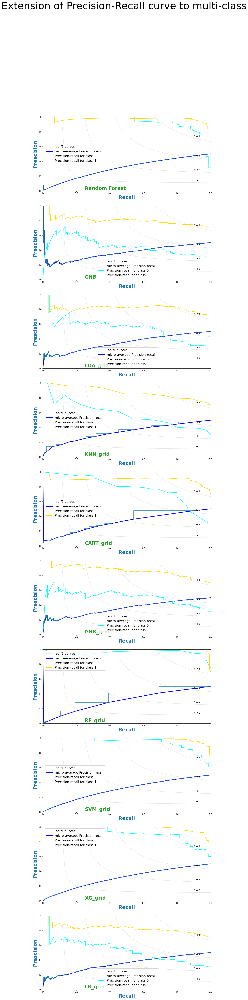

In [605]:
fig2 = plt.figure()
fig2.set_figheight(80)
fig2.set_figwidth(15)

gs2 = fig2.add_gridspec(10, hspace=0.2, wspace=0.2)
ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10 = gs2.subplots()
#for ax in axs.flat:
#    ax.label_outer()
#fig.text(0, 3, 'Falplot_PR_f1se Positive Rate', ha='center', va='center')
#fig.text(3, 0, 'True Positive Rate', ha='center', va='center', rotation='vertical')

plot_PR_f1(ax1,X_test,Y_test,RF,"Random Forest")
plot_PR_f1(ax2,X_test,Y_test,GNB,"GNB")
plot_PR_f1(ax3,X_test,Y_test,best_estimators[0].best_estimator_,names[0])
plot_PR_f1(ax4,X_test,Y_test,best_estimators[1].best_estimator_,names[1])
plot_PR_f1(ax5,X_test,Y_test,best_estimators[2].best_estimator_,names[2])
plot_PR_f1(ax6,X_test,Y_test,best_estimators[3].best_estimator_,names[3])
plot_PR_f1(ax7,X_test,Y_test,best_estimators[4].best_estimator_,names[4])
plot_PR_f1(ax8,X_test,Y_test,best_estimators[5].best_estimator_,names[5])
plot_PR_f1(ax9,X_test,Y_test,best_estimators[6].best_estimator_,names[6])
plot_PR_f1(ax10,X_test,Y_test,best_estimators[7].best_estimator_,names[7])
#fig2.tight_layout()
fig2.suptitle('Extension of Precision-Recall curve to multi-class',fontsize = 50)
plt.show()

In [136]:
def plot_feature_importance(model,message,feature_names):
    # get importance
    importance = model.feature_importances_
    # summarize feature importance
    for i,v in enumerate(importance):
        print('Feature %0d: %s, Score: %.5f' % (i,feature_names[i],v))
    # plot feature importance
    #plt.bar(feature_names, importance)
    #plt.title(message)
    #plt.show()
    fig = exp.bar(feature_names,x=importance,y=[x for x in feature_names],title=message)
    fig.show()

In [137]:
plot_feature_importance(RF,"Random Forest",X.columns)
#plot_feature_importance(GNB,"GNB",X.columns)
#plot_feature_importance(RF_grid_search.best_estimator_,"Random Forest grid_search",X.columns)
#plot_feature_importance(GNB_grid_search.best_estimator_,"GNB grid_search",X.columns)
#plot_feature_importance(XG_grid_search.best_estimator_,"XGBoost grid_search",X.columns)
#plot_feature_importance(KNN_grid_search.best_estimator_,"KNN grid_search",X.columns)
#plot_feature_importance(LDA_grid_search.best_estimator_,"LDA grid_search",X.columns)
#plot_feature_importance(SVM_grid_search.best_estimator_,"SVM grid_search",X.columns)
#plot_feature_importance(CART_grid_search.best_estimator_,"CART grid_search",X.columns)
#plot_feature_importance(LR_grid_search.best_estimator_,"LR grid_search",X.columns)

#plot_feature_importance(best_estimators[0].best_estimator_,names[0],X.columns)
#plot_feature_importance(best_estimators[1].best_estimator_,names[1],X.columns)
plot_feature_importance(best_estimators[2].best_estimator_,names[2],X.columns)
#plot_feature_importance(best_estimators[3].best_estimator_,names[3],X.columns)
plot_feature_importance(best_estimators[4].best_estimator_,names[4],X.columns)
#plot_feature_importance(best_estimators[5].best_estimator_,names[5],X.columns)
plot_feature_importance(best_estimators[6].best_estimator_,names[6],X.columns)
#plot_feature_importance(best_estimators[7].best_estimator_,names[7],X.columns)

Feature 0: checking_account, Score: 0.10040
Feature 1: credit_history, Score: 0.03919
Feature 2: purpose, Score: 0.06493
Feature 3: savings_account, Score: 0.03987
Feature 4: employment_duration, Score: 0.03921
Feature 5: installment_rate, Score: 0.03149
Feature 6: personal_status_sex, Score: 0.04144
Feature 7: other_debtors, Score: 0.01579
Feature 8: present_residence, Score: 0.02283
Feature 9: property, Score: 0.03039
Feature 10: other_installment_plans, Score: 0.02970
Feature 11: housing, Score: 0.01875
Feature 12: number_credits, Score: 0.03916
Feature 13: job, Score: 0.02589
Feature 14: people_liable, Score: 0.00399
Feature 15: telephone, Score: 0.01573
Feature 16: foreign_worker, Score: 0.00216
Feature 17: duration, Score: 0.11503
Feature 18: amount, Score: 0.18852
Feature 19: age, Score: 0.13552


Feature 0: checking_account, Score: 0.27308
Feature 1: credit_history, Score: 0.09691
Feature 2: purpose, Score: 0.06639
Feature 3: savings_account, Score: 0.01814
Feature 4: employment_duration, Score: 0.00000
Feature 5: installment_rate, Score: 0.00000
Feature 6: personal_status_sex, Score: 0.03619
Feature 7: other_debtors, Score: 0.06373
Feature 8: present_residence, Score: 0.02174
Feature 9: property, Score: 0.09092
Feature 10: other_installment_plans, Score: 0.01980
Feature 11: housing, Score: 0.02906
Feature 12: number_credits, Score: 0.02286
Feature 13: job, Score: 0.00000
Feature 14: people_liable, Score: 0.00000
Feature 15: telephone, Score: 0.00000
Feature 16: foreign_worker, Score: 0.00000
Feature 17: duration, Score: 0.08349
Feature 18: amount, Score: 0.14578
Feature 19: age, Score: 0.03190


Feature 0: checking_account, Score: 0.08854
Feature 1: credit_history, Score: 0.05321
Feature 2: purpose, Score: 0.08475
Feature 3: savings_account, Score: 0.03933
Feature 4: employment_duration, Score: 0.04012
Feature 5: installment_rate, Score: 0.03502
Feature 6: personal_status_sex, Score: 0.02650
Feature 7: other_debtors, Score: 0.01677
Feature 8: present_residence, Score: 0.03535
Feature 9: property, Score: 0.04184
Feature 10: other_installment_plans, Score: 0.02745
Feature 11: housing, Score: 0.02319
Feature 12: number_credits, Score: 0.01873
Feature 13: job, Score: 0.03080
Feature 14: people_liable, Score: 0.01162
Feature 15: telephone, Score: 0.02442
Feature 16: foreign_worker, Score: 0.00405
Feature 17: duration, Score: 0.10567
Feature 18: amount, Score: 0.17725
Feature 19: age, Score: 0.11538


Feature 0: checking_account, Score: 0.10428
Feature 1: credit_history, Score: 0.06878
Feature 2: purpose, Score: 0.06283
Feature 3: savings_account, Score: 0.07342
Feature 4: employment_duration, Score: 0.04035
Feature 5: installment_rate, Score: 0.03461
Feature 6: personal_status_sex, Score: 0.04232
Feature 7: other_debtors, Score: 0.03989
Feature 8: present_residence, Score: 0.03223
Feature 9: property, Score: 0.04697
Feature 10: other_installment_plans, Score: 0.07825
Feature 11: housing, Score: 0.06183
Feature 12: number_credits, Score: 0.04190
Feature 13: job, Score: 0.05150
Feature 14: people_liable, Score: 0.03581
Feature 15: telephone, Score: 0.04541
Feature 16: foreign_worker, Score: 0.00000
Feature 17: duration, Score: 0.05916
Feature 18: amount, Score: 0.04237
Feature 19: age, Score: 0.03809


# ======== Reliable, Trustworthy and Bias free ML with XAI ========

# Building ML pipeline with MLI and XAI

# 1. XAI for explaining Data

In [1112]:
import shap
import eli5
import lime
import lime.lime_tabular
import matplotlib.pyplot as plt
from collections import defaultdict
from sklearn import preprocessing
from sklearn.pipeline import make_pipeline
from sklearn.ensemble import RandomForestClassifier
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder
from alibi.explainers import AnchorTabular
from alibi.confidence import TrustScore
from xgboost.sklearn import XGBRegressor
from eli5.sklearn import PermutationImportance
from pdpbox import pdp, get_dataset, info_plots

In [1113]:
df_saved.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,...,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,...,0 to 2,no,no,18,1049,21,good,Student,2,0
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,3 or more,no,no,9,2799,36,good,Adult,2,0
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,...,0 to 2,no,no,12,841,23,good,Student,1,0
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,3 or more,no,yes,12,2122,39,good,Adult,1,0
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,...,0 to 2,no,yes,12,2171,38,good,Adult,1,1


In [1114]:
df_saved.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 24 columns):
checking_account           1000 non-null category
credit_history             1000 non-null category
purpose                    1000 non-null category
savings_account            1000 non-null category
employment_duration        1000 non-null category
installment_rate           1000 non-null category
personal_status_sex        1000 non-null category
other_debtors              1000 non-null category
present_residence          1000 non-null category
property                   1000 non-null category
other_installment_plans    1000 non-null category
housing                    1000 non-null category
number_credits             1000 non-null category
job                        1000 non-null category
people_liable              1000 non-null category
telephone                  1000 non-null category
foreign_worker             1000 non-null category
duration                   1000 non-null int

In [1115]:
protected = ["personal_status_sex", "Age_cat", "foreign_worker"]

In [1116]:
df = df_saved.copy(deep=True)

interval = (0, 2500, 5000, 10000,20000)

cats = ['<2.5k', '<5k', '<10k','>10k']
df["Credit_cat"] = pd.cut(df["amount"], interval, labels=cats)

#categorical_cols = ["Sex", "Job_lvl", "Housing", "Saving accounts", "Checking account", "Purpose", "credit_cat", "Age_cat", "Risk"]
#ordinal_cols = ["Duration","Credit amount","Age"]
csv_columns = df.columns

In [1117]:
df.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,...,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl,Credit_cat
0,no checking account,all credits at this bank paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,...,no,no,18,1049,21,good,Student,2,0,<2.5k
1,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,25 <= ... < 35,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,no,no,9,2799,36,good,Adult,2,0,<5k
2,... < 0 DM,no credits taken/all credits paid back duly,retraining,... < 100 DM,4 <= ... < 7 yrs,25 <= ... < 35,female : non-single or male : single,none,>= 7 yrs,unknown / no property,...,no,no,12,841,23,good,Student,1,0,<2.5k
3,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,20 <= ... < 25,male : married/widowed,none,1 <= ... < 4 yrs,unknown / no property,...,no,yes,12,2122,39,good,Adult,1,0,<2.5k
4,no checking account,all credits at this bank paid back duly,others,unknown/no savings account,1 <= ... < 4 yrs,< 20,male : married/widowed,none,>= 7 yrs,car or other,...,no,yes,12,2171,38,good,Adult,1,1,<2.5k


In [1118]:
categorical_cols

['checking_account',
 'credit_history',
 'purpose',
 'savings_account',
 'employment_duration',
 'installment_rate',
 'personal_status_sex',
 'other_debtors',
 'present_residence',
 'property',
 'other_installment_plans',
 'housing',
 'number_credits',
 'job',
 'people_liable',
 'telephone',
 'foreign_worker']

In [1119]:
import itertools

for L in range(1, len(protected+[label])+1):
    for subset in itertools.combinations(protected+[label], L):
        print(subset)

('personal_status_sex',)
('Age_cat',)
('foreign_worker',)
('credit_risk',)
('personal_status_sex', 'Age_cat')
('personal_status_sex', 'foreign_worker')
('personal_status_sex', 'credit_risk')
('Age_cat', 'foreign_worker')
('Age_cat', 'credit_risk')
('foreign_worker', 'credit_risk')
('personal_status_sex', 'Age_cat', 'foreign_worker')
('personal_status_sex', 'Age_cat', 'credit_risk')
('personal_status_sex', 'foreign_worker', 'credit_risk')
('Age_cat', 'foreign_worker', 'credit_risk')
('personal_status_sex', 'Age_cat', 'foreign_worker', 'credit_risk')


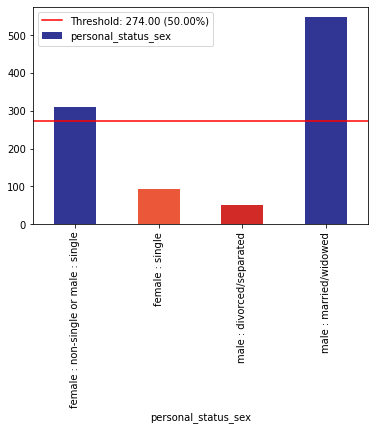

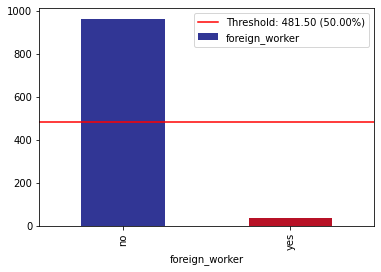

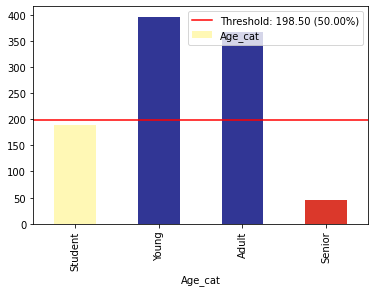

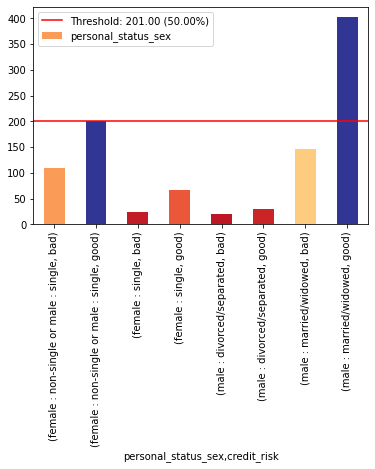

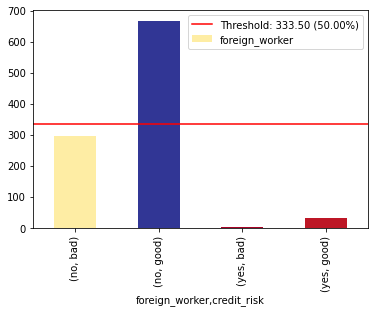

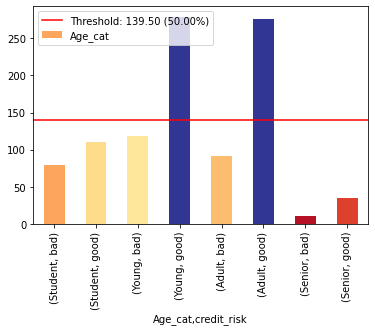

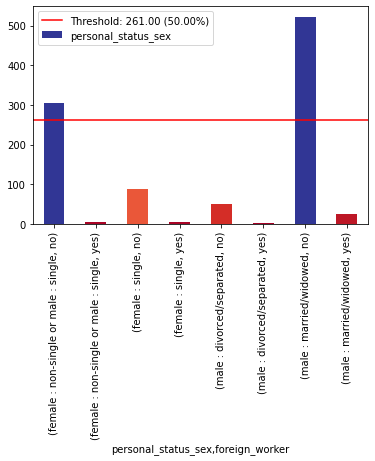

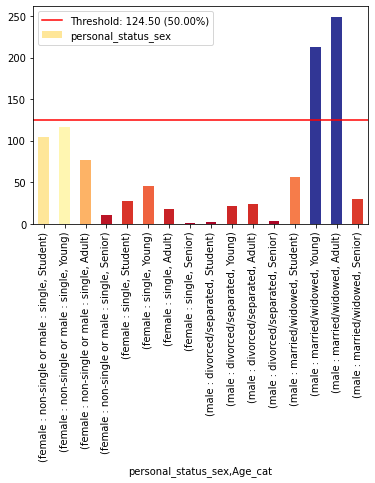

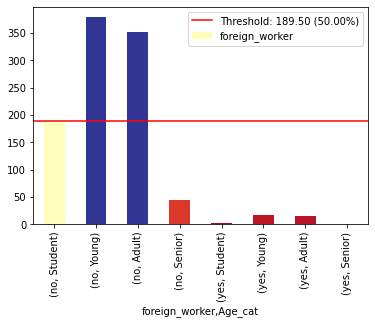

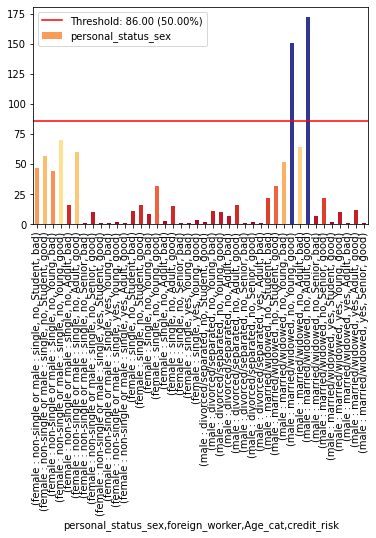

In [1120]:
df_groups_0 = xai.imbalance_plot(df, "personal_status_sex", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_1 = xai.imbalance_plot(df, "foreign_worker", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_2 = xai.imbalance_plot(df, "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_3 = xai.imbalance_plot(df, "personal_status_sex", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_4 = xai.imbalance_plot(df, "foreign_worker", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_5 = xai.imbalance_plot(df, "Age_cat", "credit_risk",categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_6 = xai.imbalance_plot(df, "personal_status_sex", "foreign_worker", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_7 = xai.imbalance_plot(df, "personal_status_sex", "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_8 = xai.imbalance_plot(df, "foreign_worker", "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_9 = xai.imbalance_plot(df, "personal_status_sex","foreign_worker", "Age_cat", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])

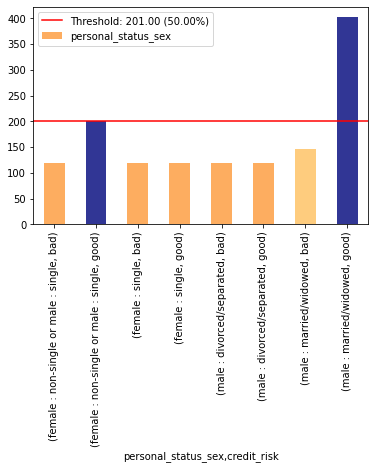

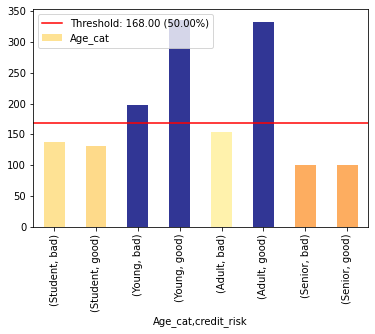

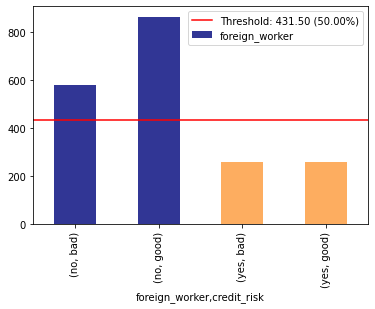

In [1121]:
bal_df = df
for cols in protected:
    bal_df = xai.balance(bal_df, cols, 'credit_risk', upsample=0.3, categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])

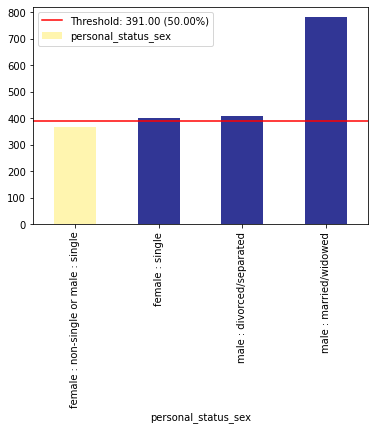

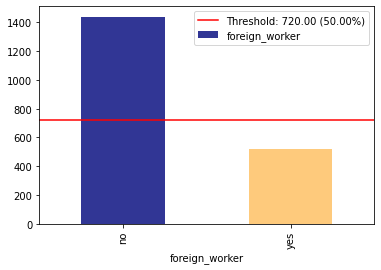

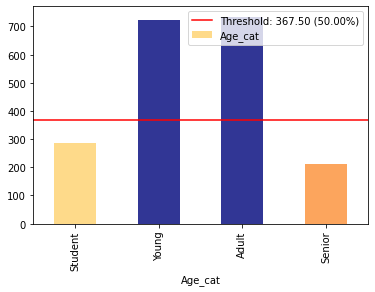

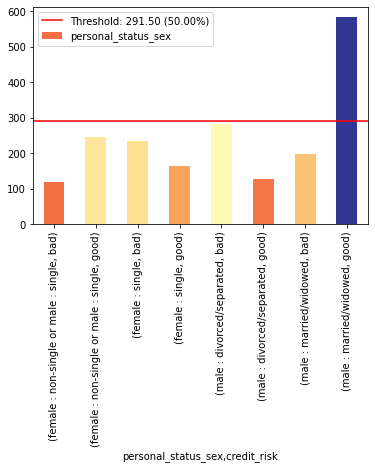

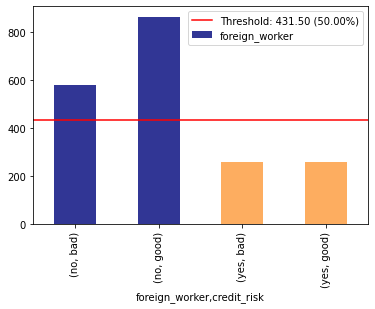

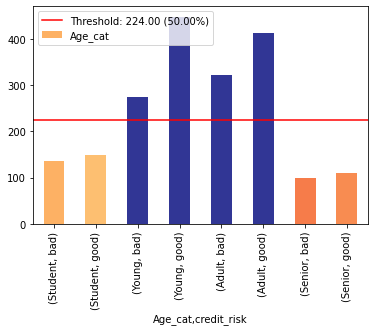

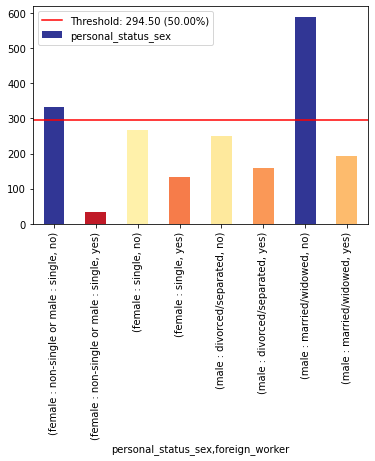

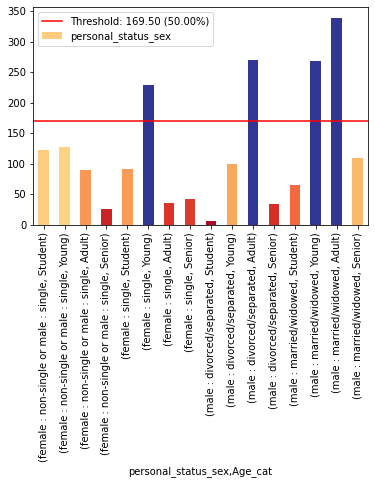

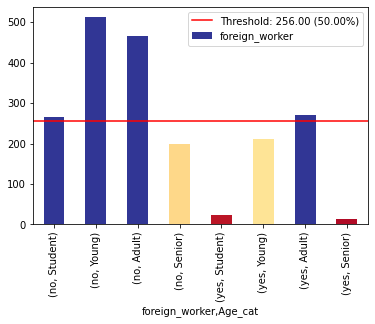

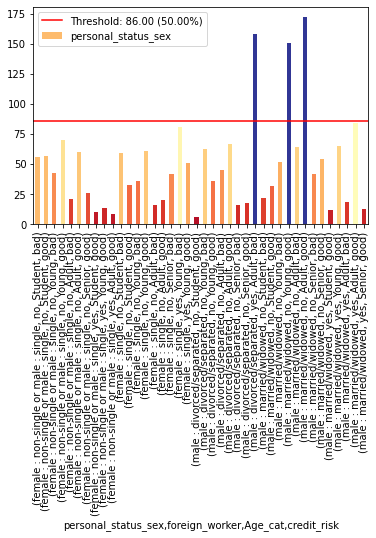

In [1122]:
df_groups_0 = xai.imbalance_plot(bal_df, "personal_status_sex", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_1 = xai.imbalance_plot(bal_df, "foreign_worker", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_2 = xai.imbalance_plot(bal_df, "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_3 = xai.imbalance_plot(bal_df, "personal_status_sex", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_4 = xai.imbalance_plot(bal_df, "foreign_worker", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_5 = xai.imbalance_plot(bal_df, "Age_cat", "credit_risk",categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_6 = xai.imbalance_plot(bal_df, "personal_status_sex", "foreign_worker", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_7 = xai.imbalance_plot(bal_df, "personal_status_sex", "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_8 = xai.imbalance_plot(bal_df, "foreign_worker", "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_9 = xai.imbalance_plot(bal_df, "personal_status_sex","foreign_worker", "Age_cat", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])

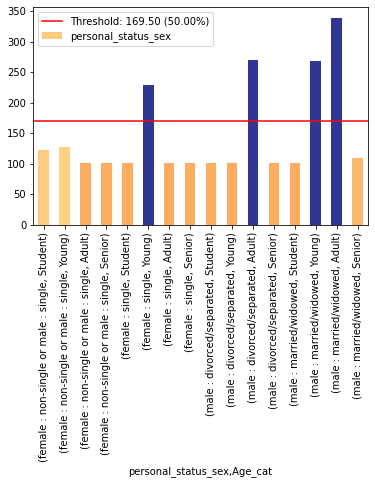

In [1123]:
bal_df = xai.balance(bal_df, "personal_status_sex", "Age_cat", upsample=0.3, categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])

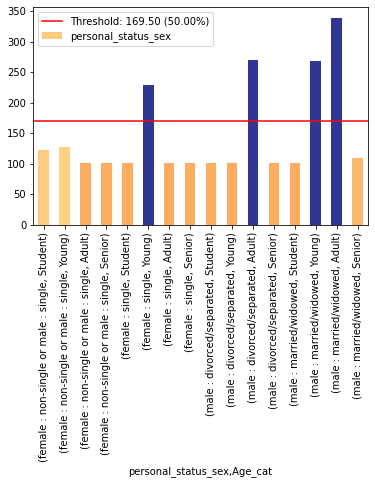

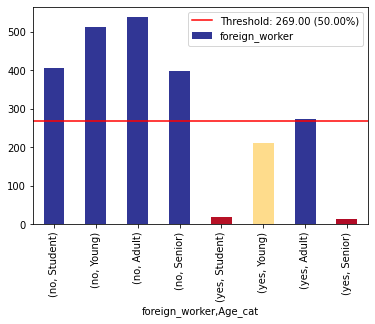

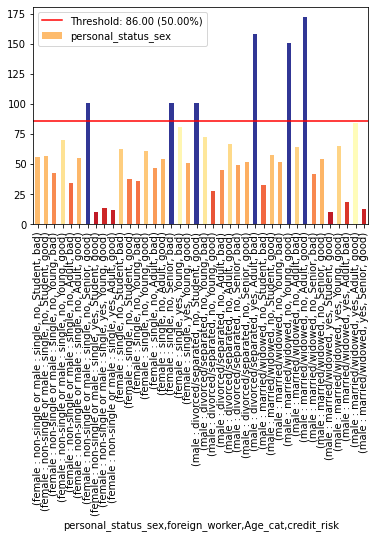

In [1124]:
df_groups_7 = xai.imbalance_plot(bal_df, "personal_status_sex", "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_8 = xai.imbalance_plot(bal_df, "foreign_worker", "Age_cat", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])
df_groups_9 = xai.imbalance_plot(bal_df, "personal_status_sex","foreign_worker", "Age_cat", "credit_risk", categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])

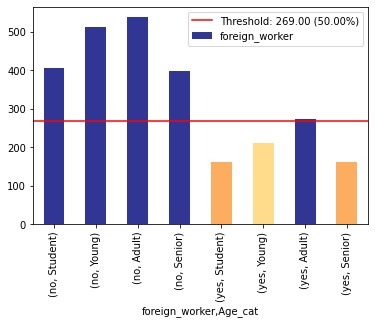

In [1125]:
bal_df = xai.balance(bal_df, "foreign_worker", "Age_cat", upsample=0.3, categorical_cols=categorical_cols+[label,'Credit_cat','Age_cat'])

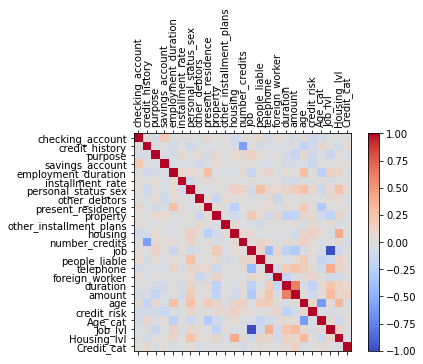

In [1126]:
_ = xai.correlations(df, include_categorical=True, plot_type="matrix")

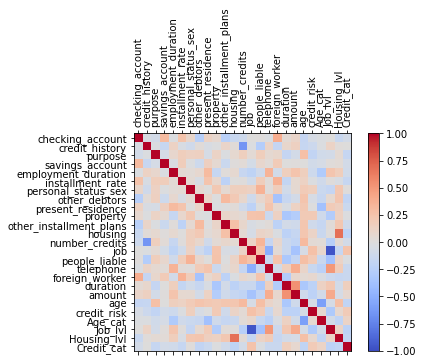

In [1127]:
_ = xai.correlations(bal_df, include_categorical=True, plot_type="matrix")

In [1128]:
bal_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2663 entries, 0 to 2662
Data columns (total 25 columns):
checking_account           2663 non-null category
credit_history             2663 non-null category
purpose                    2663 non-null category
savings_account            2663 non-null category
employment_duration        2663 non-null category
installment_rate           2663 non-null category
personal_status_sex        2663 non-null category
other_debtors              2663 non-null category
present_residence          2663 non-null category
property                   2663 non-null category
other_installment_plans    2663 non-null category
housing                    2663 non-null category
number_credits             2663 non-null category
job                        2663 non-null category
people_liable              2663 non-null category
telephone                  2663 non-null category
foreign_worker             2663 non-null category
duration                   2663 non-null in

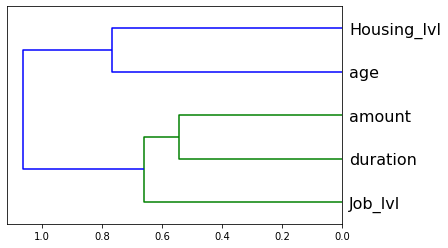

In [1129]:
_ = xai.correlations(bal_df, include_categorical=False)

Group 1: Credit amount, Duration, Job_lvl
Group 2: Age, Housing

In [1130]:
bal_df.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,...,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl,Credit_cat
0,no checking account,no credits taken/all credits paid back duly,repairs,unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,...,no,no,6,448,23,bad,Student,2,1,<2.5k
1,no checking account,no credits taken/all credits paid back duly,furniture/equipment,unknown/no savings account,1 <= ... < 4 yrs,< 20,female : non-single or male : single,none,>= 7 yrs,building soc. savings agr./life insurance,...,no,no,18,1882,25,bad,Student,2,0,<2.5k
2,no checking account,no credits taken/all credits paid back duly,others,unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,...,no,no,24,1207,24,bad,Student,2,0,<2.5k
3,no checking account,no credits taken/all credits paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,unknown / no property,...,yes (under customer name),no,24,3234,23,bad,Student,1,0,<5k
4,... < 0 DM,no credits taken/all credits paid back duly,others,... < 100 DM,< 1 yr,< 20,female : non-single or male : single,none,1 <= ... < 4 yrs,car or other,...,no,no,12,836,23,bad,Student,1,1,<2.5k


In [1131]:
bal_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2663 entries, 0 to 2662
Data columns (total 25 columns):
checking_account           2663 non-null category
credit_history             2663 non-null category
purpose                    2663 non-null category
savings_account            2663 non-null category
employment_duration        2663 non-null category
installment_rate           2663 non-null category
personal_status_sex        2663 non-null category
other_debtors              2663 non-null category
present_residence          2663 non-null category
property                   2663 non-null category
other_installment_plans    2663 non-null category
housing                    2663 non-null category
number_credits             2663 non-null category
job                        2663 non-null category
people_liable              2663 non-null category
telephone                  2663 non-null category
foreign_worker             2663 non-null category
duration                   2663 non-null in

In [1132]:
# Encode labels in column . 
proc_df = bal_df.copy(deep=True)
proc_df['personal_status_sex'] = label_encoder_personal_status_sex.fit_transform(proc_df['personal_status_sex']) 
proc_df['job'] = label_encoder_job.fit_transform(proc_df['job']) 
proc_df['housing'] = label_encoder_housing.fit_transform(proc_df['housing']) 
proc_df['savings_account'] = label_encoder_savings_account.fit_transform(proc_df['savings_account']) 
proc_df['checking_account'] =label_encoder_checking_account.fit_transform(proc_df['checking_account']) 
proc_df['purpose'] = label_encoder_purpose.fit_transform(proc_df['purpose']) 
#proc_df['credit_risk'] = label_encoder_credit_risk.fit_transform(proc_df['credit_risk'])
proc_df['credit_history'] = label_encoder_credit_history.fit_transform(proc_df['credit_history'])
proc_df['employment_duration'] = label_encoder_employment_duration.fit_transform(proc_df['employment_duration'])
proc_df['installment_rate'] = label_encoder_installment_rate.fit_transform(proc_df['installment_rate'])
proc_df['property'] = label_encoder_property.fit_transform(proc_df['property'])
proc_df['other_installment_plans'] = label_encoder_other_installment_plans.fit_transform(proc_df['other_installment_plans'])
proc_df['number_credits'] = label_encoder_number_credits.fit_transform(proc_df['number_credits'])
proc_df['people_liable'] = label_encoder_people_liable.fit_transform(proc_df['people_liable'])
proc_df['telephone'] = label_encoder_telephone.fit_transform(proc_df['telephone'])
proc_df['foreign_worker'] = label_encoder_foreign_worker.fit_transform(proc_df['foreign_worker'])
proc_df['other_debtors'] = label_encoder_other_debtors.fit_transform(proc_df['other_debtors'])
proc_df['present_residence'] = label_encoder_present_residence.fit_transform(proc_df['present_residence'])

# encoding risk as binary
r = {"good":0, "bad": 1}
proc_df[label]=proc_df[label].map(r)

In [1133]:
len(bal_df)

2663

In [1134]:
n_samples = len(proc_df)
indices = np.arange(n_samples)
#proc_df = xai.normalize_numeric(bal_df)
#proc_df = xai.convert_categories(proc_df)
y = proc_df["credit_risk"]
del proc_df["credit_risk"]
del proc_df["Age_cat"]
del proc_df["Credit_cat"]
del proc_df["Job_lvl"]
del proc_df["Housing_lvl"]

scaler = StandardScaler()
scaler.fit(proc_df)
x = pd.DataFrame(scaler.transform(proc_df),columns = proc_df.columns)

#x_train, y_train, x_test, y_test, train_idx, test_idx = \
#    xai.balanced_train_test_split(
#            x, y, "personal_status_sex", 
#            min_per_group=300,
#            max_per_group=300,
#            categorical_cols=categorical_cols)
# Spliting X and y into train and test version
x_train, x_test, y_train, y_test, train_idx, test_idx = train_test_split(x, y, indices, test_size = 0.25, random_state=seed)

x_train_display = bal_df.iloc[train_idx]
x_test_display = bal_df.iloc[test_idx]

print("Total number of examples: ", x_test.shape[0])

df_test = x_test_display.copy()
df_test["credit_risk"] = y_test
proc_df["credit_risk"] = y

Total number of examples:  666


In [1135]:
len(x_test)

666

In [1136]:
bal_df.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,...,telephone,foreign_worker,duration,amount,age,credit_risk,Age_cat,Job_lvl,Housing_lvl,Credit_cat
0,no checking account,no credits taken/all credits paid back duly,repairs,unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,...,no,no,6,448,23,bad,Student,2,1,<2.5k
1,no checking account,no credits taken/all credits paid back duly,furniture/equipment,unknown/no savings account,1 <= ... < 4 yrs,< 20,female : non-single or male : single,none,>= 7 yrs,building soc. savings agr./life insurance,...,no,no,18,1882,25,bad,Student,2,0,<2.5k
2,no checking account,no credits taken/all credits paid back duly,others,unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,car or other,...,no,no,24,1207,24,bad,Student,2,0,<2.5k
3,no checking account,no credits taken/all credits paid back duly,car (used),unknown/no savings account,< 1 yr,< 20,female : non-single or male : single,none,>= 7 yrs,unknown / no property,...,yes (under customer name),no,24,3234,23,bad,Student,1,0,<5k
4,... < 0 DM,no credits taken/all credits paid back duly,others,... < 100 DM,< 1 yr,< 20,female : non-single or male : single,none,1 <= ... < 4 yrs,car or other,...,no,no,12,836,23,bad,Student,1,1,<2.5k


In [1137]:
proc_df.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,...,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age,credit_risk
0,3,4,7,4,2,2,0,2,3,1,...,2,0,1,0,0,0,6,448,23,1
1,3,4,4,4,0,2,0,2,3,0,...,0,1,1,0,0,0,18,1882,25,1
2,3,4,5,4,2,2,0,2,3,1,...,0,0,1,0,0,0,24,1207,24,1
3,3,4,2,4,2,2,0,2,3,3,...,0,0,3,0,1,0,24,3234,23,1
4,0,4,5,0,2,2,0,2,0,1,...,2,0,3,0,0,0,12,836,23,1


In [1138]:
x.head()

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,1.102636,0.862692,1.452555,0.646014,0.477033,0.27318,-1.566984,0.412414,1.069233,-0.416469,0.117414,0.607098,-0.729168,-0.377410,-0.42166,-0.701339,-0.658812,-1.165163,-0.981317,-1.106329
1,1.102636,0.862692,-0.104464,0.646014,-0.972297,0.27318,-1.566984,0.412414,1.069233,-1.244741,-2.100132,-1.786245,0.839309,-0.377410,-0.42166,-0.701339,-0.658812,-0.032606,-0.468288,-0.980913
2,1.102636,0.862692,0.414543,0.646014,0.477033,0.27318,-1.566984,0.412414,1.069233,-0.416469,0.117414,-1.786245,-0.729168,-0.377410,-0.42166,-0.701339,-0.658812,0.533673,-0.709777,-1.043621
3,1.102636,0.862692,-1.142477,0.646014,0.477033,0.27318,-1.566984,0.412414,1.069233,1.240075,0.117414,-1.786245,-0.729168,1.624668,-0.42166,1.425843,-0.658812,0.533673,0.015406,-1.106329
4,-1.348383,0.862692,0.414543,-2.210501,0.477033,0.27318,-1.566984,0.412414,-1.345154,-0.416469,-2.100132,0.607098,-0.729168,1.624668,-0.42166,-0.701339,-0.658812,-0.598884,-0.842506,-1.106329


In [1139]:
#proc_df.info()
#ordinal_cols = ['Age','Credit amount','Duration']
#categorical_cols = ['Sex', 'Job' ,'Housing' ,'Saving accounts','Checking account','Purpose']
protected_cols = ['age','personal_status_sex','foreign_worker']

In [1140]:
x_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1997 entries, 1499 to 860
Data columns (total 20 columns):
checking_account           1997 non-null float64
credit_history             1997 non-null float64
purpose                    1997 non-null float64
savings_account            1997 non-null float64
employment_duration        1997 non-null float64
installment_rate           1997 non-null float64
personal_status_sex        1997 non-null float64
other_debtors              1997 non-null float64
present_residence          1997 non-null float64
property                   1997 non-null float64
other_installment_plans    1997 non-null float64
housing                    1997 non-null float64
number_credits             1997 non-null float64
job                        1997 non-null float64
people_liable              1997 non-null float64
telephone                  1997 non-null float64
foreign_worker             1997 non-null float64
duration                   1997 non-null float64
amount   

In [1141]:
x_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 666 entries, 1474 to 643
Data columns (total 20 columns):
checking_account           666 non-null float64
credit_history             666 non-null float64
purpose                    666 non-null float64
savings_account            666 non-null float64
employment_duration        666 non-null float64
installment_rate           666 non-null float64
personal_status_sex        666 non-null float64
other_debtors              666 non-null float64
present_residence          666 non-null float64
property                   666 non-null float64
other_installment_plans    666 non-null float64
housing                    666 non-null float64
number_credits             666 non-null float64
job                        666 non-null float64
people_liable              666 non-null float64
telephone                  666 non-null float64
foreign_worker             666 non-null float64
duration                   666 non-null float64
amount                     6

# 2. Modeling and Evaluation using XAI 

In [1142]:
ts = TrustScore(alpha=.05,
                filter_type='distance_knn',
                k_filter=10,
                leaf_size=40,
                metric='euclidean',
                dist_filter_type='point')

In [1143]:
ts.fit(x.values, y, classes=2)

In [752]:
limeExplainer = lime.lime_tabular.LimeTabularExplainer(x.values,
                              feature_names=x.columns.values.tolist(),
                              class_names=['credit_risk'],
                              categorical_features=categorical_cols,
                              verbose=True,
                              mode='regression')

In [753]:
RF_grid_search.fit(x_train,y_train)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   29.7s
[Parallel(n_jobs=-1)]: Done  82 tasks      | elapsed:   31.2s
[Parallel(n_jobs=-1)]: Done 317 tasks      | elapsed:   38.4s
[Parallel(n_jobs=-1)]: Done 659 tasks      | elapsed:   50.2s
[Parallel(n_jobs=-1)]: Done 915 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done 1256 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 1582 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done 1800 out of 1800 | elapsed:  1.8min finished


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [3, 5, 7, 10, None],
                         'max_features': [4, 7, 9, 12, 15, 20],
                         'n_estimators': [3, 5, 10, 25, 50, 150]},
             scoring='accuracy', verbose=4)

In [754]:
GNB_grid_search.fit(x_train,y_train)

Fitting 10 folds for each of 100 candidates, totalling 1000 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:    2.9s finished


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=GaussianNB(), n_jobs=-1,
             param_grid={'priors': [None],
                         'var_smoothing': array([1.00000000e+00, 8.11130831e-01, 6.57933225e-01, 5.33669923e-01,
       4.32876128e-01, 3.51119173e-01, 2.84803587e-01, 2.31012970e-01,
       1.87381742e-01, 1.51991108e-01, 1.23284674e-01, 1.00000000e-01,
       8.11130831e-02, 6.5793...
       1.23284674e-07, 1.00000000e-07, 8.11130831e-08, 6.57933225e-08,
       5.33669923e-08, 4.32876128e-08, 3.51119173e-08, 2.84803587e-08,
       2.31012970e-08, 1.87381742e-08, 1.51991108e-08, 1.23284674e-08,
       1.00000000e-08, 8.11130831e-09, 6.57933225e-09, 5.33669923e-09,
       4.32876128e-09, 3.51119173e-09, 2.84803587e-09, 2.31012970e-09,
       1.87381742e-09, 1.51991108e-09, 1.23284674e-09, 1.00000000e-09])},
             scoring='accuracy', verbose=4)

In [755]:
XG_grid_search.fit(x_train, y_train)

Fitting 10 folds for each of 2700 candidates, totalling 27000 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    7.9s
[Parallel(n_jobs=-1)]: Done  82 tasks      | elapsed:   13.7s
[Parallel(n_jobs=-1)]: Done 205 tasks      | elapsed:   19.6s
[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   30.3s
[Parallel(n_jobs=-1)]: Done 597 tasks      | elapsed:   43.0s
[Parallel(n_jobs=-1)]: Done 866 tasks      | elapsed:   58.1s
[Parallel(n_jobs=-1)]: Done 1185 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 1552 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done 1969 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done 2434 tasks      | elapsed:  2.4min
[Parallel(n_jobs=-1)]: Done 2949 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done 3512 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done 4125 tasks      | elapsed:  3.8min
[Parallel(n_jobs=-1)]: Done 4786 tasks      | elapsed:  4.4min
[Parallel(n_jobs=-1)]: Done 5497 tasks      | el

GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, gamma=None,
                                     gpu_id=None, importance_type='gain',
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=None, min_child_weight=None,
                                     missing=nan, mo...
                                     reg_alpha=None, reg_lambda=None,
                                     scale_pos_weight=None, subsample=None,
                                     tree_method=None, validate_parameters=None,
                                     verbosity=None),
             n_jobs=-1,
             pa

In [756]:
KNN_grid_search.fit(x_train, y_train)

Fitting 10 folds for each of 16 candidates, totalling 160 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 104 out of 160 | elapsed:    1.0s remaining:    0.5s
[Parallel(n_jobs=-1)]: Done 160 out of 160 | elapsed:    1.7s finished


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=KNeighborsClassifier(n_neighbors=3), n_jobs=-1,
             param_grid={'metric': ['euclidian', 'manhattan'],
                         'n_neighbors': [3, 5, 11, 19],
                         'weights': ['uniform', 'distance']},
             scoring='accuracy', verbose=4)

In [757]:
LDA_grid_search.fit(x_train, y_train)

Fitting 10 folds for each of 3 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   7 out of  30 | elapsed:    0.0s remaining:    0.4s
[Parallel(n_jobs=-1)]: Done  15 out of  30 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed:    0.2s finished


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
             param_grid={'solver': ['svd', 'lsqr', 'eigen']},
             scoring='accuracy', verbose=4)

In [758]:
SVM_grid_search.fit(x_train, y_train)

Fitting 5 folds for each of 25 candidates, totalling 125 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done  82 tasks      | elapsed:   11.6s
[Parallel(n_jobs=-1)]: Done 125 out of 125 | elapsed:   20.1s finished


GridSearchCV(cv=5, estimator=SVC(probability=True), n_jobs=-1,
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
                         'kernel': ['rbf']},
             scoring='accuracy', verbose=4)

In [759]:
CART_grid_search.fit(x_train,y_train)

Fitting 10 folds for each of 588 candidates, totalling 5880 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 712 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 2188 tasks      | elapsed:    9.2s
[Parallel(n_jobs=-1)]: Done 4240 tasks      | elapsed:   18.6s
[Parallel(n_jobs=-1)]: Done 5880 out of 5880 | elapsed:   25.9s finished


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=DecisionTreeClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_leaf_nodes': [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                            13, 14, 15, 16, 17, 18, 19, 20, 21,
                                            22, 23, 24, 25, 26, 27, 28, 29, 30,
                                            31, ...],
                         'min_samples_split': [2, 3, 4, 5, 6, 7]},
             scoring='accuracy', verbose=4)

In [760]:
LR_grid_search.fit(x_train, y_train)

Fitting 10 folds for each of 2000 candidates, totalling 20000 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 772 tasks      | elapsed:    4.6s
[Parallel(n_jobs=-1)]: Done 1456 tasks      | elapsed:    8.3s
[Parallel(n_jobs=-1)]: Done 2340 tasks      | elapsed:   13.3s
[Parallel(n_jobs=-1)]: Done 3416 tasks      | elapsed:   19.0s
[Parallel(n_jobs=-1)]: Done 4692 tasks      | elapsed:   25.8s
[Parallel(n_jobs=-1)]: Done 6160 tasks      | elapsed:   33.9s
[Parallel(n_jobs=-1)]: Done 7828 tasks      | elapsed:   42.6s
[Parallel(n_jobs=-1)]: Done 9688 tasks      | elapsed:   52.5s
[Parallel(n_jobs=-1)]: Done 11748 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 14000 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 16452 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done 19096 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done 20000 out of 

GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=Pipeline(steps=[('std_slc', StandardScaler()),
                                       ('pca', PCA()),
                                       ('logistic_Reg', LogisticRegression())]),
             n_jobs=-1,
             param_grid={'logistic_Reg__C': array([1.00000000e-04, 1.45634848e-04, 2.12095089e-04, 3.08884360e-04,
       4.49843267e-04, 6.55128557e-04, 9.54095476e-04, 1.38949549e-03,
       2.0235896...
       7.54312006e+01, 1.09854114e+02, 1.59985872e+02, 2.32995181e+02,
       3.39322177e+02, 4.94171336e+02, 7.19685673e+02, 1.04811313e+03,
       1.52641797e+03, 2.22299648e+03, 3.23745754e+03, 4.71486636e+03,
       6.86648845e+03, 1.00000000e+04]),
                         'logistic_Reg__penalty': ['l1', 'l2'],
                         'pca__n_components': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10,
                                               11, 12, 13, 14, 15, 16, 17, 18,
                     

In [761]:
## prepare models
models_xai = []
#models.append(('RF', RF, ))
#models.append(('GNB', GNB))
models_xai.append(('LDA_grid', LDA_grid_search, param_grid_LDA))
models_xai.append(('KNN_grid', KNN_grid_search, param_grid_KNN))
models_xai.append(('CART_grid', CART_grid_search, param_grid_CART))
models_xai.append(('GNB_grid', GNB_grid_search, param_grid_GNB))
models_xai.append(('RF_grid', RF_grid_search, param_grid_RF))
models_xai.append(('SVM_grid', SVM_grid_search, param_grid_SVM))
models_xai.append(('XG_grid', XG_grid_search, param_grid_XG))
models_xai.append(('LR_grid', LR_grid_search, param_grid_LR))

names_xai = []
results_train_xai = []
results_test_xai = []
estimators_accuracy_xai = []
accuracy_scorer_xai = make_scorer(accuracy_score)

In [762]:
# load pickled data
file_names_xai = open("Saved_models/xai/names_xai", 'rb')
names_xai = pickle.load(file_names_xai)

In [763]:
names_xai

['LDA_grid',
 'KNN_grid',
 'CART_grid',
 'GNB_grid',
 'RF_grid',
 'SVM_grid',
 'XG_grid',
 'LR_grid']

In [764]:
# load pickled data
file_results_test_xai = open("Saved_models/xai/results_test_xai", 'rb')
results_test_xai = pickle.load(file_results_test_xai)

In [765]:
results_test_xai

[array([0.578125  , 0.65625   , 0.62109375, 0.671875  , 0.61328125,
        0.44313725, 0.60392157, 0.76470588, 0.64313725, 0.32156863]),
 array([0.6328125 , 0.703125  , 0.53515625, 0.7578125 , 0.67578125,
        0.87843137, 0.68627451, 0.97647059, 0.98823529, 0.96078431]),
 array([0.5546875 , 0.6875    , 0.6171875 , 0.69921875, 0.5234375 ,
        0.7254902 , 0.64705882, 0.67058824, 0.97254902, 0.97254902]),
 array([0.578125  , 0.640625  , 0.609375  , 0.62890625, 0.59765625,
        0.61960784, 0.38039216, 0.46666667, 0.85882353, 0.96078431]),
 array([0.53515625, 0.640625  , 0.52734375, 0.76171875, 0.48046875,
        0.82745098, 0.89019608, 0.8745098 , 0.84705882, 0.97254902]),
 array([0.68359375, 0.6875    , 0.67578125, 0.75      , 0.62890625,
        0.89019608, 0.65098039, 0.97647059, 1.        , 0.96078431]),
 array([0.63671875, 0.734375  , 0.55859375, 0.703125  , 0.609375  ,
        0.72156863, 0.66666667, 0.97647059, 0.8627451 , 0.96078431]),
 array([0.55078125, 0.59375   , 0.45703125, 0.68359375, 0.5546875 ,
        0.49019608, 0.36862745, 0.67843137, 0.50196078, 0.94509804])]

In [766]:
# load pickled data
file_results_train_xai = open("Saved_models/xai/results_train_xai", 'rb')
results_train_xai = pickle.load(file_results_train_xai)

In [767]:
results_train_xai

[array([0.78642888, 0.78207916, 0.78860374, 0.76903001, 0.77946933,
        0.75869565, 0.7526087 , 0.69478261, 0.73608696, 0.74608696]),
 array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1.]),
 array([0.97303175, 0.85819922, 0.86211396, 0.87124837, 0.96868204,
        0.84956522, 0.95869565, 0.84826087, 0.77956522, 0.89956522]),
 array([0.78033928, 0.75511092, 0.77033493, 0.76076555, 0.75293606,
        0.75      , 0.73043478, 0.69652174, 0.72826087, 0.74695652]),
 array([0.98695085, 0.98390605, 0.98738582, 0.99130057, 0.98869074,
        0.98695652, 1.        , 0.99043478, 0.9426087 , 0.99086957]),
 array([0.97303175, 1.        , 0.99782514, 1.        , 0.97564158,
        0.96695652, 1.        , 1.        , 0.9026087 , 0.90217391]),
 array([0.92301   , 0.99869508, 1.        , 0.95606786, 0.9969552 ,
        0.99782609, 0.97173913, 0.99521739, 0.99913043, 0.96565217]),
 array([0.63853849, 0.63375381, 0.64897782, 0.71944324, 0.73727708,
        0.75521739, 0.65782609, 0.70869565, 0.6473913 , 0.61521739])]

In [768]:
# load pickled data
file_estimators_accuracy_xai = open("Saved_models/xai/estimators_accuracy_xai", 'rb')
estimators_accuracy_xai = pickle.load(file_estimators_accuracy_xai)

In [769]:
estimators_accuracy_xai

[(GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
               param_grid={'solver': ['svd', 'lsqr', 'eigen']},
               scoring='accuracy', verbose=4)),
 (GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=KNeighborsClassifier(n_neighbors=3), n_jobs=-1,
               param_grid={'metric': ['euclidian', 'manhattan'],
                           'n_neighbors': [3, 5, 11, 19],
                           'weights': ['uniform', 'distance']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=KNeighborsClassifier(n_neighbors=3), n_jobs=-1,
               param_grid={'metric': ['euclidian', 'manhattan'],
                           'n_neighbors': [3, 5, 11, 19],
                           'weights': ['uniform', 'distance']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=KNeighborsClassifier(n_neighbors=3), n_jobs=-1,
               param_grid={'metric': ['euclidian', 'manhattan'],
                           'n_neighbors': [3, 5, 11, 19],
                           'weights': ['uniform', 'distance']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
               estimator=KNeighborsClassifier(n_neighbors=3), n_jobs=-1,
               param_grid={'metric': ['euclidian', 'manhattan'],
                           'n_neighbors': [3, 5, 11, 19],
                           'weights': ['uniform', 'distance']},
               scoring='accuracy', verbose=4),
  GridSearchCV(cv=KFo

In [770]:
#for name, model,params in models_xai:
#        cv_results = cross_validate(estimator=model, X=x, y=y, return_train_score=True, return_estimator=True, cv=kfold, scoring=accuracy_scorer_xai, n_jobs=-1, verbose=4)
#        results_train_xai.append(cv_results['train_score'])
#        results_test_xai.append(cv_results['test_score'])
#        names_xai.append(name)
#        estimators_accuracy_xai.append(cv_results['estimator'])
#        #msg = "%s: %f (%f)" % (name, cv_results['train_score'], cv_results['test_score'])
#        #print(msg)

In [771]:
results_test_xai[0:8]

[array([0.578125  , 0.65625   , 0.62109375, 0.671875  , 0.61328125,
        0.44313725, 0.60392157, 0.76470588, 0.64313725, 0.32156863]),
 array([0.6328125 , 0.703125  , 0.53515625, 0.7578125 , 0.67578125,
        0.87843137, 0.68627451, 0.97647059, 0.98823529, 0.96078431]),
 array([0.5546875 , 0.6875    , 0.6171875 , 0.69921875, 0.5234375 ,
        0.7254902 , 0.64705882, 0.67058824, 0.97254902, 0.97254902]),
 array([0.578125  , 0.640625  , 0.609375  , 0.62890625, 0.59765625,
        0.61960784, 0.38039216, 0.46666667, 0.85882353, 0.96078431]),
 array([0.53515625, 0.640625  , 0.52734375, 0.76171875, 0.48046875,
        0.82745098, 0.89019608, 0.8745098 , 0.84705882, 0.97254902]),
 array([0.68359375, 0.6875    , 0.67578125, 0.75      , 0.62890625,
        0.89019608, 0.65098039, 0.97647059, 1.        , 0.96078431]),
 array([0.63671875, 0.734375  , 0.55859375, 0.703125  , 0.609375  ,
        0.72156863, 0.66666667, 0.97647059, 0.8627451 , 0.96078431]),
 array([0.55078125, 0.59375   , 0.45703125, 0.68359375, 0.5546875 ,
        0.49019608, 0.36862745, 0.67843137, 0.50196078, 0.94509804])]

In [772]:
import pickle
import math

#optimization_approach = ['fbeta_score','accuracy_score','recall_score']
#estimator_list = [estimators_fbeta,estimators_accuracy,estimators_recall]
best_index_xai = []
best_estimators_xai = []

def optimization_index(i):
    return math.floor(i / 8)

def estimator_index(i):
    return i % 8

def highest_value(a):
    return np.argmax(a)

for index in range(0,8):
    msg = names_xai[index] + ' Optimized params for ' + 'Accuracy'
    bst_idx = highest_value(results_test_xai[index])
    bst_estimator = estimators_accuracy_xai[index][bst_idx]
    
    print(msg)
    print('Best Index : {0}'.format(bst_idx))
    print('Best Test Score : ',results_test_xai[index][bst_idx])
    print('Best Index : %s',bst_estimator)
    
    best_index_xai.append(bst_idx)
    best_estimators_xai.append(bst_estimator)

    #save the model to disk
    #filename = 'Saved_models/'+names[index] + '_' + optimization_approach[optimization_index(index)] + '_model.sav'
    filename = 'Saved_models/xai/'+names_xai[index] + '_' + 'Accuracy_score' + '_model.sav'
    print(filename)
    #pickle.dump(bst_estimator, open(filename, 'wb'))

LDA_grid Optimized params for Accuracy
Best Index : 7
Best Test Score :  0.7647058823529411
Best Index : %s GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=LinearDiscriminantAnalysis(), n_jobs=-1,
             param_grid={'solver': ['svd', 'lsqr', 'eigen']},
             scoring='accuracy', verbose=4)
Saved_models/xai/LDA_grid_Accuracy_score_model.sav
KNN_grid Optimized params for Accuracy
Best Index : 8
Best Test Score :  0.9882352941176471
Best Index : %s GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=False),
             estimator=KNeighborsClassifier(n_neighbors=3), n_jobs=-1,
             param_grid={'metric': ['euclidian', 'manhattan'],
                         'n_neighbors': [3, 5, 11, 19],
                         'weights': ['uniform', 'distance']},
             scoring='accuracy', verbose=4)
Saved_models/xai/KNN_grid_Accuracy_score_model.sav
CART_grid Optimized params for Accuracy
Best Index : 8
Best Test Score :  0.9725

In [773]:
#filename = 'Saved_models/xai/names_xai'
#pickle.dump(names_xai, open(filename, 'wb'))
#filename = 'Saved_models/xai/results_test_xai'
#pickle.dump(results_test_xai, open(filename, 'wb'))
#filename = 'Saved_models/xai/results_train_xai'
#pickle.dump(results_train_xai, open(filename, 'wb'))
#filename = 'Saved_models/xai/estimators_accuracy_xai'
#pickle.dump(estimators_accuracy_xai, open(filename, 'wb'))

In [774]:
data = {'Model_name': [],
        'test_score': [],
        'train_score': []}

#create dataframe
model_df_xai = pd.DataFrame(data)

for index in range(0,8):
    name = names_xai[index]
    test_score = results_test_xai[index]
    train_score = results_train_xai[index]
    for j in range(0,10):
        new_row = {'Model_name':name, 'test_score':test_score[j], 'train_score':train_score[j]}
        model_df_xai = model_df_xai.append(new_row, ignore_index=True)

model_df_xai['Model_name'] = model_df_xai['Model_name'].astype('category')
model_df_xai.set_index('Model_name')
        
print(model_df_xai.head())
model_df_xai.info()

  Model_name  test_score  train_score
0   LDA_grid    0.578125     0.786429
1   LDA_grid    0.656250     0.782079
2   LDA_grid    0.621094     0.788604
3   LDA_grid    0.671875     0.769030
4   LDA_grid    0.613281     0.779469
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 80 entries, 0 to 79
Data columns (total 3 columns):
Model_name     80 non-null category
test_score     80 non-null float64
train_score    80 non-null float64
dtypes: category(1), float64(2)
memory usage: 1.8 KB


In [775]:
trace0 = go.Box(
    y=model_df_xai['train_score'],
    x=model_df_xai['Model_name'],
    name='Performance on Training set',
    marker=dict(
        color='#3D9970'
    )
)

trace1 = go.Box(
    y=model_df_xai['test_score'],
    x=model_df_xai['Model_name'],
    name='Performance on Test set',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [trace0, trace1]

layout = go.Layout(
    yaxis=dict(
        title='Model performance - optimized for Accuracy'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)
fig.update_yaxes(autorange=True)

py.iplot(fig, filename='box-models-performance')

In [776]:
best_index_xai

[7, 8, 8, 9, 9, 8, 7, 9]

# Model Blackbox explainations

Model 1 : RF

In [777]:
print(RF_grid_search.best_params_)

{'max_depth': 10, 'max_features': 12, 'n_estimators': 25}


In [778]:
RF_grid_search.best_estimator_

RandomForestClassifier(max_depth=10, max_features=12, n_estimators=25,
                       random_state=42)

In [779]:
RF_grid_search.best_score_

0.9307980115122974

In [780]:
best_estimators_xai[4].best_score_

0.7621739130434781

In [781]:
RF = best_estimators_xai[4].best_estimator_
#RF = RF_grid_search.best_estimator_
RF

RandomForestClassifier(max_depth=10, max_features=12, n_estimators=25,
                       random_state=42)

Model 1 Predictive Accuracy

In [782]:
#Testing the model 
#Predicting using our  model
y_pred_RF = RF.predict(x_test)

# Verificaar os resultados obtidos
print(accuracy_score(y_test,y_pred_RF)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_RF))
print("\n")
print(fbeta_score(y_test, y_pred_RF, beta=2))
print("\n")
print(classification_report(y_test, y_pred_RF))

97.6958525345622
 percent


[[398   5]
 [ 10 238]]


0.9635627530364373


              precision    recall  f1-score   support

           0       0.98      0.99      0.98       403
           1       0.98      0.96      0.97       248

    accuracy                           0.98       651
   macro avg       0.98      0.97      0.98       651
weighted avg       0.98      0.98      0.98       651



In [783]:
print("Actual # : ",len(y_pred_RF)," Successfully Predicted # :",len(y_test))

Actual # :  651  Successfully Predicted # : 651


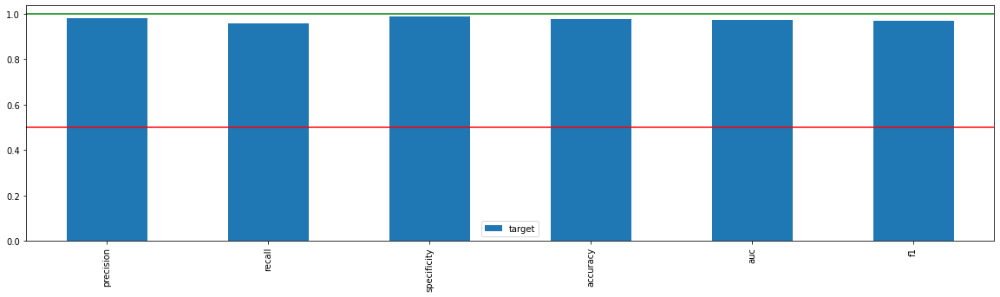

In [784]:
_= xai.metrics_plot(y_test,y_pred_RF)

In [785]:
 protected_cols

['age', 'personal_status_sex', 'foreign_worker']

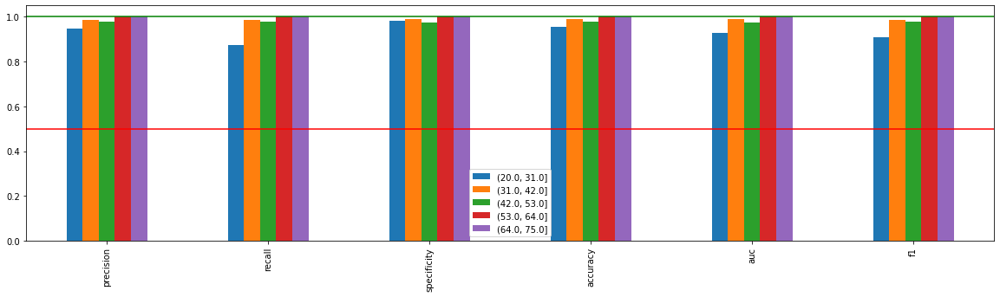

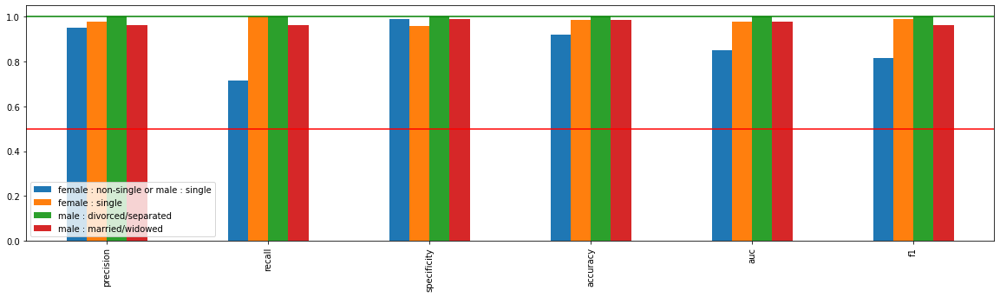

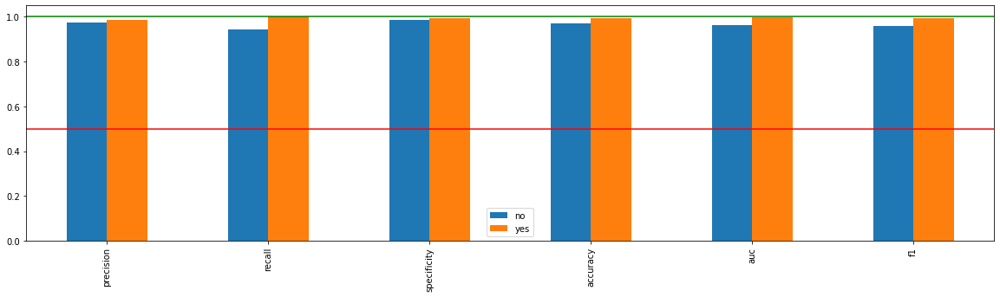

In [786]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_RF, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Plot 1: Model performance based on Sex [Male,Female] Plot 2: Model performance based on Age [Student, Adult1, Adult2, Adult3, Senior]

Model 1 Descriptive Accuracy and Relevance

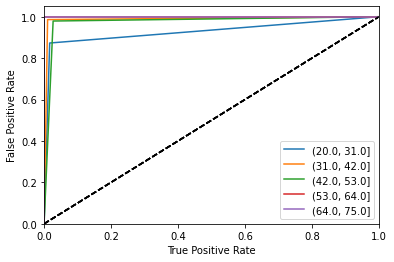

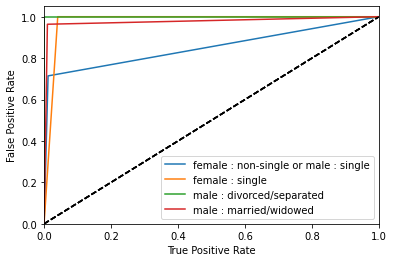

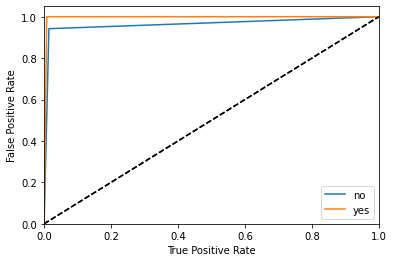

In [787]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_RF, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Model 1 RF Feature level explainations 

In [788]:
perm_RF = PermutationImportance(RF, random_state=seed).fit(x,y)
eli5.show_weights(perm_RF, feature_names = x.columns.tolist())

Weight,Feature
0.1463 ± 0.0097,property
0.1161 ± 0.0078,checking_account
0.0670 ± 0.0066,purpose
0.0424 ± 0.0045,personal_status_sex
0.0324 ± 0.0027,duration
0.0200 ± 0.0028,amount
0.0188 ± 0.0032,age
0.0135 ± 0.0028,installment_rate
0.0091 ± 0.0025,credit_history
0.0075 ± 0.0018,housing


,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,0.117141,0.009301,0.065334,0.00465,0.002767,0.014105,0.04166,0.000692,0.004573,0.143659,0.003651,0.006726,0.005803,0.006418,0.001345,0.000961,0.00711,0.034051,0.024366,0.020215


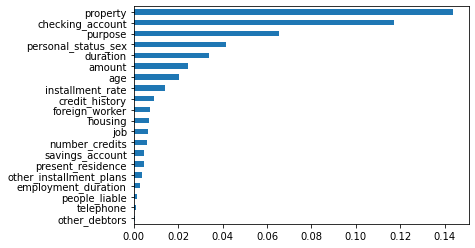

In [789]:
def get_avg(x, y):
    return accuracy_score(RF.predict(x), y)

imp1 = xai.feature_importance(x, y,get_avg)
imp1.head()

Model 1 RF Global Explainations

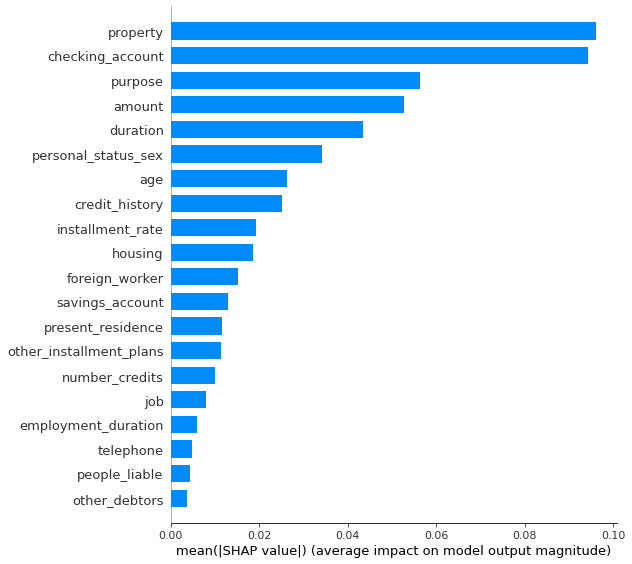

In [1179]:
RF_explainer =  shap.TreeExplainer(RF)
RF_shap_values = RF_explainer.shap_values(x)
shap.summary_plot(RF_shap_values[1], x,plot_type="bar")

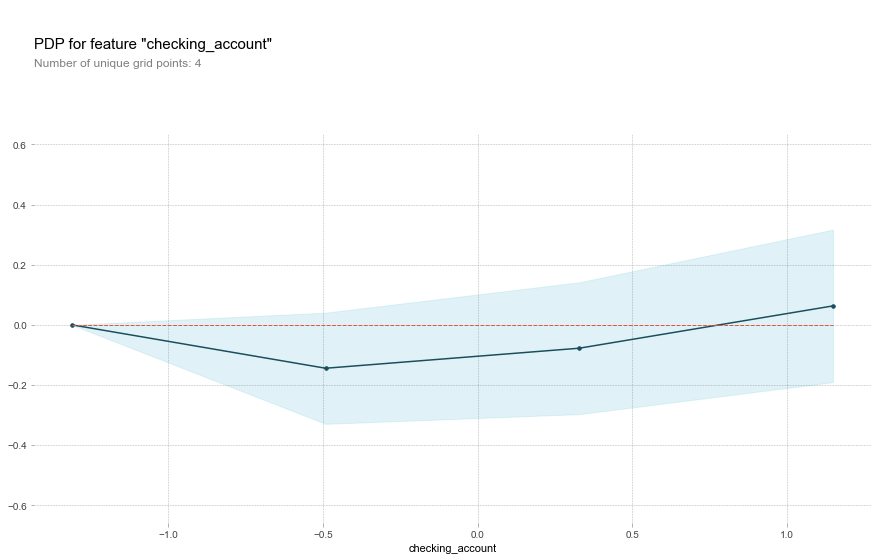

In [791]:
# Create the data that we will plot
pdp_CheckingAccount_RF = pdp.pdp_isolate(model=RF, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_RF, 'checking_account')
plt.show()

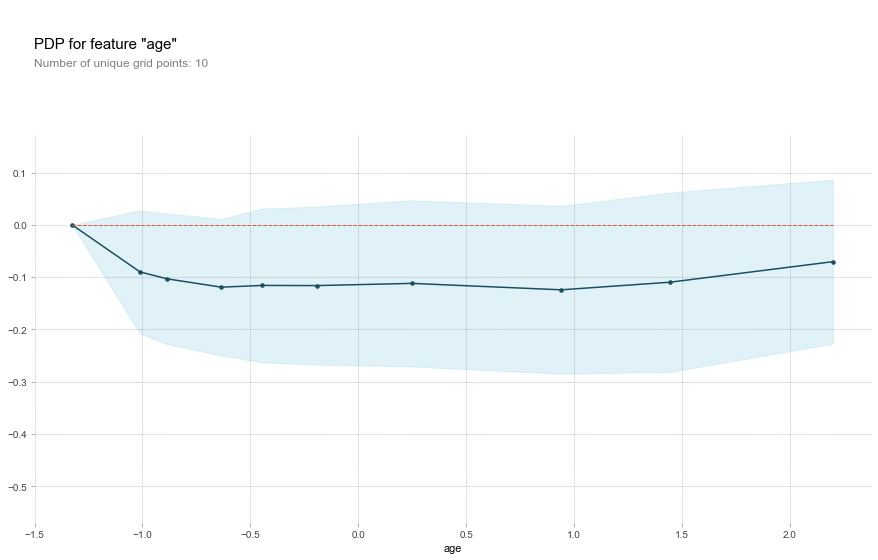

In [792]:
# Create the data that we will plot
pdp_Age_RF = pdp.pdp_isolate(model=RF, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_RF, 'age')
plt.show()

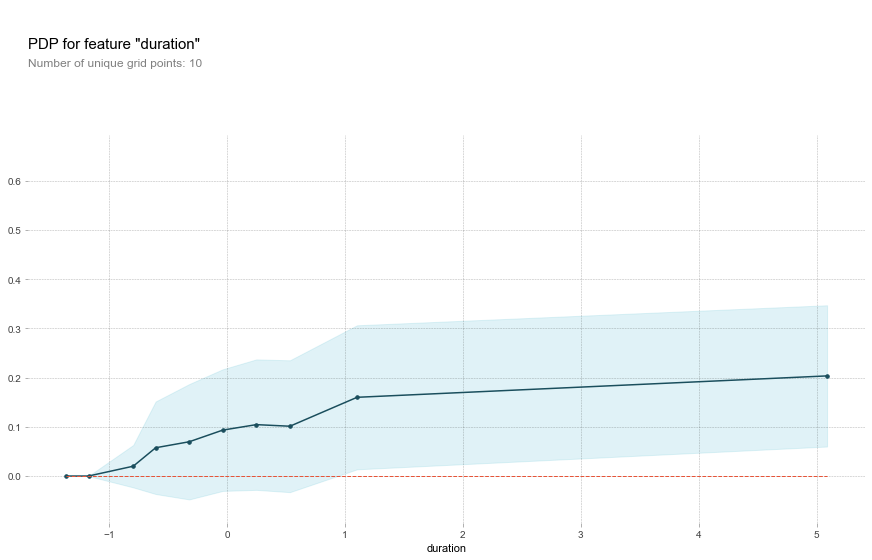

In [793]:
# Create the data that we will plot
pdp_Duration_RF = pdp.pdp_isolate(model=RF, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_RF, 'duration')
plt.show()

In [794]:
# Similar to previous PDP plot except we use pdp_interact instead of pdp_isolate and pdp_interact_plot instead of pdp_isolate_plot
interRF  =  pdp.pdp_interact(model=RF, dataset=x, model_features=x.columns, features=protected_cols)

#pdp.pdp_interact_plot(pdp_interact_out=interRF, feature_names=['Risk','Age'], plot_type='contour')
#plt.show()

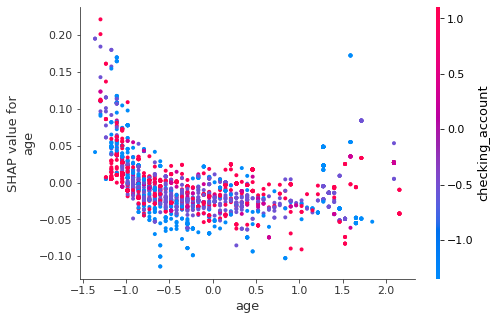

In [1273]:
# make plot.
shap.dependence_plot('age', RF_shap_values[1], x)

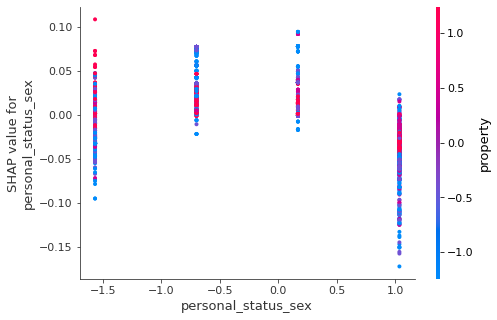

Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...


2021-01-17 19:27:13.909 INFO    shap: num_full_subsets = 2
2021-01-17 19:27:13.925 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 19:27:13.926 INFO    shap: num_full_subsets = 2
2021-01-17 19:27:13.937 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 19:27:13.950 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 19:27:14.000 INFO    shap: num_paired_subset_sizes = 9


Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...


2021-01-17 19:27:22.684 INFO    shap: num_full_subsets = 2
2021-01-17 19:27:22.770 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 19:27:23.044 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 19:27:24.360 INFO    shap: num_full_subsets = 2
2021-01-17 19:27:24.364 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 19:27:24.371 INFO    shap: num_paired_subset_sizes = 9



Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...


2021-01-17 19:27:41.167 INFO    shap: num_full_subsets = 2
2021-01-17 19:27:41.181 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 19:27:41.200 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 19:27:41.255 INFO    shap: num_full_subsets = 2
2021-01-17 19:27:41.265 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 19:27:41.282 INFO    shap: num_paired_subset_sizes = 9


2021-01-17 19:32:35.262 INFO    shap: num_full_subsets = 2
2021-01-17 19:32:35.288 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 19:32:35.317 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 19:32:40.783 INFO    shap: weight_left = 0.5467009166626137
2021-01-17 19:32:42.536 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 19:32:42.579 INFO    shap: np.sum(self.kernelWeights) = 1.0
2021-01-17 19:32:43.029 INFO    shap: phi = [ 0.00957937  0.          0.00486577 -0.01592758  0.00610641 -0.00415494
  0.00163816 -0.02585237 -0.00244773 -0.04812591  0.02500889  0.02703849
  0.02008036  0.02890982  0.          0.01169784  0.00555296  0.0097329
  0.06484285  0.03144444]
2021-01-17 19:32:43.048 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 19:32:43.065 INFO    shap: np.sum(self.kernelWeights) = 1.0
2021-01-17 19:32:43.239 INFO    shap: phi = [-0.00957937  0.         -0.00486577  0.01592758 -0.00610

2021-01-17 19:32:45.789 INFO    shap: num_full_subsets = 2
2021-01-17 19:32:45.813 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 19:32:45.831 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 19:32:51.122 INFO    shap: weight_left = 0.5467009166626137
2021-01-17 19:32:52.801 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 19:32:52.885 INFO    shap: np.sum(self.kernelWeights) = 0.9999999999999999
2021-01-17 19:32:53.265 INFO    shap: phi = [ 0.00928451  0.          0.00500014 -0.01618794  0.00611505 -0.00418136
  0.00156252 -0.02587792 -0.00261691 -0.04795774  0.02492468  0.0274646
  0.01991592  0.02886017  0.          0.01146295  0.00587408  0.0097947
  0.06494941  0.03160287]
2021-01-17 19:32:53.325 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 19:32:53.355 INFO    shap: np.sum(self.kernelWeights) = 0.9999999999999999
2021-01-17 19:32:53.631 INFO    shap: phi = [-0.00928451  0.         -0.

2021-01-17 19:32:56.947 INFO    shap: num_full_subsets = 2
2021-01-17 19:32:57.006 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 19:32:57.127 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 19:33:02.527 INFO    shap: weight_left = 0.5467009166626137


2021-01-17 19:33:07.359 INFO    shap: num_full_subsets = 2
2021-01-17 19:33:07.381 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 19:33:07.407 INFO    shap: num_paired_subset_sizes = 9


2021-01-17 19:33:09.721 INFO    shap: num_full_subsets = 2
2021-01-17 19:33:09.734 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 19:33:09.752 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 19:33:10.674 INFO    shap: weight_left = 0.5467009166626137
2021-01-17 19:33:20.332 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 19:33:20.363 INFO    shap: np.sum(self.kernelWeights) = 0.9999999999999999
2021-01-17 19:33:20.657 INFO    shap: phi = [ 0.10405282  0.04739163  0.0249957   0.01210948 -0.00271563 -0.01863754
  0.02267155 -0.0099221  -0.02451284 -0.00503701  0.00807081 -0.02594921
 -0.00682558 -0.01003136 -0.00188986 -0.04611373 -0.00423807  0.02311086
  0.00740488 -0.00461916]
2021-01-17 19:33:20.711 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 19:33:20.743 INFO    shap: np.sum(self.kernelWeights) = 0.9999999999999999
2021-01-17 19:33:21.048 INFO    shap: phi = [-0.10405282 -0.04739163 -


Calculating shap interaction values...
Calculating shap interaction values...Calculating shap interaction values...

Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...Calculating shap interaction values...

Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...


Calculating shap interaction values...


Calculating shap interaction values...


2021-01-17 20:01:50.909 INFO    shap: num_full_subsets = 2
2021-01-17 20:01:50.936 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 20:01:50.958 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 20:01:51.027 INFO    shap: num_full_subsets = 2
2021-01-17 20:01:51.053 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 20:01:51.067 INFO    shap: num_paired_subset_sizes = 9



Calculating shap interaction values...Calculating shap interaction values...

Calculating shap interaction values...


Calculating shap interaction values...Calculating shap interaction values...



Calculating shap interaction values...
Calculating shap interaction values...


2021-01-17 20:02:01.668 INFO    shap: num_full_subsets = 2
2021-01-17 20:02:01.766 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 20:02:01.868 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 20:02:02.788 INFO    shap: num_full_subsets = 2
2021-01-17 20:02:02.815 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 20:02:02.849 INFO    shap: num_paired_subset_sizes = 9


2021-01-17 21:07:48.767 INFO    shap: num_full_subsets = 2
2021-01-17 21:07:48.770 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 21:07:48.774 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 21:07:48.997 INFO    shap: weight_left = 0.5467009166626137
2021-01-17 21:07:51.293 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 21:07:51.298 INFO    shap: np.sum(self.kernelWeights) = 1.0
2021-01-17 21:07:51.340 INFO    shap: phi = [-0.04591851 -0.05435921 -0.02026961  0.         -0.01679395 -0.00430112
 -0.0149669  -0.06924609 -0.06177375 -0.01060416 -0.07115958 -0.06849478
 -0.04910816 -0.02164023 -0.01937174 -0.02230466 -0.06952903 -0.01767591
  0.         -0.01744118]
2021-01-17 21:07:51.347 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 21:07:51.353 INFO    shap: np.sum(self.kernelWeights) = 1.0
2021-01-17 21:07:51.397 INFO    shap: phi = [0.04591851 0.05435921 0.02026961 0.         0.01679395 

2021-01-17 21:07:54.562 INFO    shap: num_full_subsets = 2
2021-01-17 21:07:54.567 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 21:07:54.570 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 21:07:54.908 INFO    shap: weight_left = 0.5467009166626137
2021-01-17 21:07:57.286 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 21:07:57.292 INFO    shap: np.sum(self.kernelWeights) = 0.9999999999999999
2021-01-17 21:07:57.339 INFO    shap: phi = [-0.04406962 -0.06158336 -0.03072108 -0.01935433 -0.02433798 -0.01616541
 -0.0117723  -0.06824349 -0.05192043 -0.0133536  -0.08120114 -0.06944311
 -0.04627421 -0.01247243 -0.01407187 -0.02517525 -0.05446903 -0.00736316
  0.         -0.00296678]
2021-01-17 21:07:57.343 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 21:07:57.348 INFO    shap: np.sum(self.kernelWeights) = 0.9999999999999999
2021-01-17 21:07:57.390 INFO    shap: phi = [0.04406962 0.06158336 0.0


Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...
Calculating shap interaction values...


2021-01-17 21:11:14.800 INFO    shap: num_full_subsets = 2
2021-01-17 21:11:14.810 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 21:11:14.816 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 21:11:14.993 INFO    shap: num_full_subsets = 2
2021-01-17 21:11:14.998 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 21:11:15.003 INFO    shap: num_paired_subset_sizes = 9


2021-01-17 21:11:26.177 INFO    shap: num_full_subsets = 2
2021-01-17 21:11:26.180 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 21:11:26.182 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 21:11:26.698 INFO    shap: weight_left = 0.5467009166626137
2021-01-17 21:11:26.933 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 21:11:26.935 INFO    shap: np.sum(self.kernelWeights) = 1.0
2021-01-17 21:11:26.962 INFO    shap: phi = [ 0.01347264  0.06227692 -0.04757997  0.00670843 -0.0077508  -0.00387878
  0.05983079 -0.01071813  0.05874345  0.03548403 -0.00463586  0.05452403
 -0.04250603 -0.0236127  -0.00924085  0.05433623 -0.001603   -0.00307152
  0.02584585 -0.00856523]
2021-01-17 21:11:26.967 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 21:11:26.970 INFO    shap: np.sum(self.kernelWeights) = 1.0
2021-01-17 21:11:27.014 INFO    shap: phi = [-0.01347264 -0.06227692  0.04757997 -0.00670843  0.0077

2021-01-17 21:11:28.801 INFO    shap: num_full_subsets = 2
2021-01-17 21:11:28.804 INFO    shap: remaining_weight_vector = [0.19227593 0.15321988 0.13074763 0.11673896 0.10775904 0.10214659
 0.09905124 0.09806073]
2021-01-17 21:11:28.808 INFO    shap: num_paired_subset_sizes = 9
2021-01-17 21:11:29.161 INFO    shap: weight_left = 0.5467009166626137
2021-01-17 21:11:29.393 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 21:11:29.395 INFO    shap: np.sum(self.kernelWeights) = 0.9999999999999999
2021-01-17 21:11:29.420 INFO    shap: phi = [ 0.01362213  0.06265263 -0.04846445  0.00646459 -0.00766466 -0.0039284
  0.06033957 -0.01128756  0.05915876  0.03611024 -0.00519655  0.05518126
 -0.04300427 -0.02349525 -0.00908553  0.05459641 -0.00199082 -0.00295067
  0.02572547 -0.00872341]
2021-01-17 21:11:29.427 INFO    shap: np.sum(w_aug) = 20.0
2021-01-17 21:11:29.431 INFO    shap: np.sum(self.kernelWeights) = 0.9999999999999999
2021-01-17 21:11:29.464 INFO    shap: phi = [-0.01362213 -0.06265263  0


Intercept 0.044290845393625794
Prediction_local [0.4653961]
Right: 1


In [1276]:
# make plot.
shap.dependence_plot('personal_status_sex', RF_shap_values[1], x)

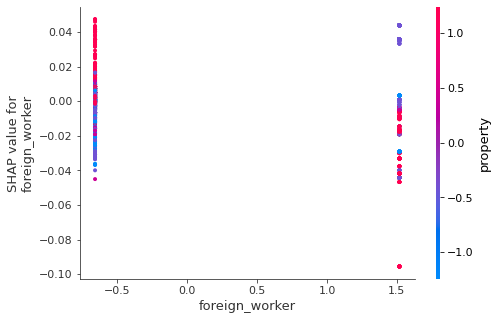

In [1269]:
shap.dependence_plot('foreign_worker', RF_shap_values[1], x)

Model 1 RF Local Explainations

In [1182]:
RF_explainer.expected_value

array([0.58573913, 0.41426087])

In [1183]:
len(RF_shap_values[0])

2663

In [1184]:
RF_shap_values[1]

array([[ 0.05668119,  0.0200228 ,  0.09989974, ..., -0.07641238,
        -0.04734597,  0.05750465],
       [ 0.06131186,  0.01642943,  0.03058991, ..., -0.03624021,
        -0.04605028, -0.01133397],
       [ 0.11197855,  0.02311595,  0.1263118 , ...,  0.0329078 ,
         0.03254509,  0.00528721],
       ...,
       [-0.06959218, -0.03994604,  0.00811936, ..., -0.08137601,
        -0.0330107 ,  0.02698737],
       [-0.06959218, -0.03994604,  0.00811936, ..., -0.08137601,
        -0.0330107 ,  0.02698737],
       [-0.06959218, -0.03994604,  0.00811936, ..., -0.08137601,
        -0.0330107 ,  0.02698737]])

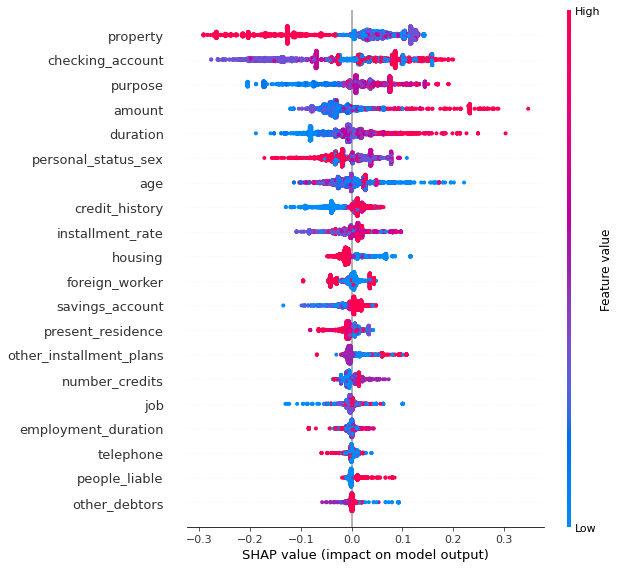

In [1185]:
shap.summary_plot(RF_shap_values[1], x)

In [1204]:
idx = 7
x.iloc[idx]

checking_account           1.102636
credit_history             0.862692
purpose                    0.933549
savings_account           -1.496372
employment_duration       -0.972297
installment_rate           0.273180
personal_status_sex       -1.566984
other_debtors              0.412414
present_residence         -1.345154
property                  -1.244741
other_installment_plans    0.117414
housing                   -1.786245
number_credits            -0.729168
job                       -0.377410
people_liable             -0.421660
telephone                 -0.701339
foreign_worker            -0.658812
duration                  -0.315745
amount                    -0.685449
age                       -1.043621
Name: 7, dtype: float64

In [1186]:
shap.initjs()
shap.force_plot(RF_explainer.expected_value[0], RF_shap_values[0][idx], features=x.columns)

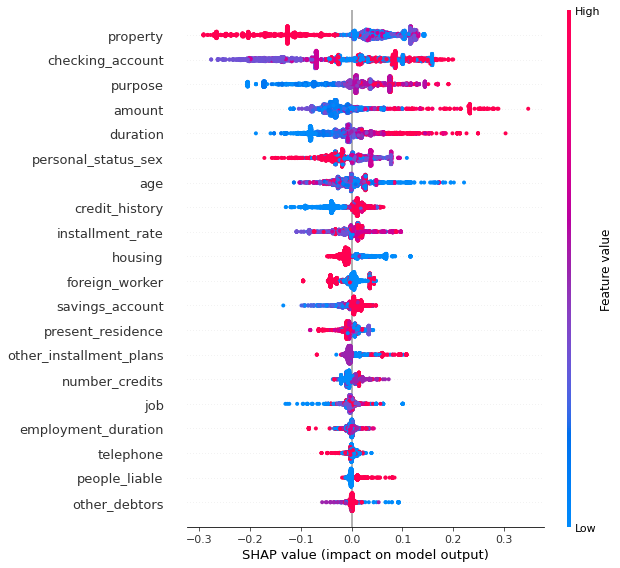

In [1187]:
shap.summary_plot(RF_shap_values[1], x)

In [1188]:
shap.force_plot(RF_explainer.expected_value[1], RF_shap_values[1][idx], features=x.columns)

In [1189]:
test_idx = 5
predict_fn_RF = lambda a: RF.predict(a)
x_test.iloc[test_idx]

checking_account          -1.348383
credit_history            -1.361267
purpose                    0.414543
savings_account            0.646014
employment_duration        0.477033
installment_rate           0.273180
personal_status_sex        0.169183
other_debtors              0.412414
present_residence          1.069233
property                  -1.244741
other_installment_plans    0.117414
housing                    0.607098
number_credits             0.839309
job                       -0.377410
people_liable             -0.421660
telephone                 -0.701339
foreign_worker            -0.658812
duration                   1.666230
amount                    -0.132708
age                       -0.855497
Name: 650, dtype: float64

In [805]:
y_pred_RF = predict_fn_RF(x_test)
#y_pred_RF

In [806]:
expRF = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_RF,num_features=20)

Intercept 0.12770552179856057
Prediction_local [0.3809008]
Right: 0


In [807]:
expRF.show_in_notebook(show_table=True)

In [808]:
scoreRF, closest_classRF = ts.score(x_test,
                                y_pred_RF,
                                k=2,
                                dist_type='point')

In [809]:
#scoreRF, closest_classRF

Model 2: GNB 

In [810]:
GNB_grid_search.best_params_

{'priors': None, 'var_smoothing': 0.2848035868435802}

In [811]:
best_estimators_xai[3].best_params_

{'priors': None, 'var_smoothing': 0.43287612810830584}

In [812]:
GNB_grid_search.best_score_

0.7831841967556252

In [813]:
best_estimators_xai[3].best_score_

0.6234782608695653

In [814]:
#GNB = GNB_grid_search.best_estimator_
GNB = best_estimators_xai[3].best_estimator_
GNB

GaussianNB(var_smoothing=0.43287612810830584)

In [815]:
y_pred_gnb = GNB.predict(x_test)
#y_pred_gnb = np.array([1 if a >= 0.5 else 0 for a in y_pred_gnb])
print(accuracy_score(y_test,y_pred_gnb)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_gnb))
print("\n")
print(classification_report(y_test, y_pred_gnb))

76.49769585253456
 percent


[[344  59]
 [ 94 154]]


              precision    recall  f1-score   support

           0       0.79      0.85      0.82       403
           1       0.72      0.62      0.67       248

    accuracy                           0.76       651
   macro avg       0.75      0.74      0.74       651
weighted avg       0.76      0.76      0.76       651



In [816]:
print("Actual # : ",len(y_pred_gnb)," Successfully Predicted # :",len(y_test))

Actual # :  651  Successfully Predicted # : 651


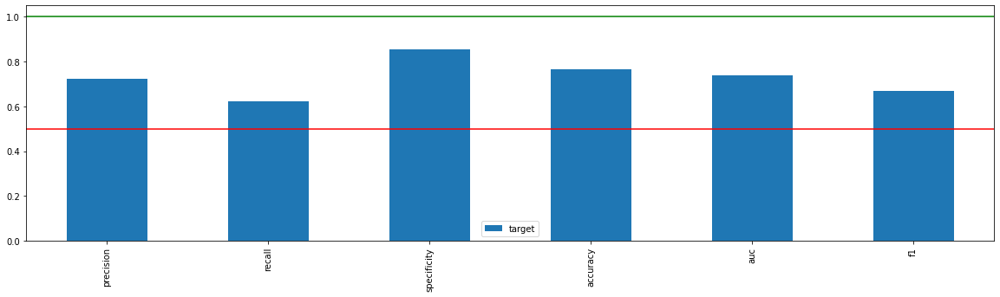

In [817]:
_= xai.metrics_plot(y_test,y_pred_gnb)

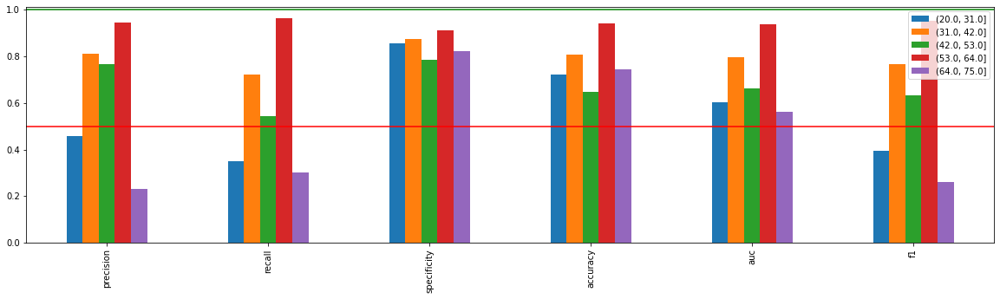

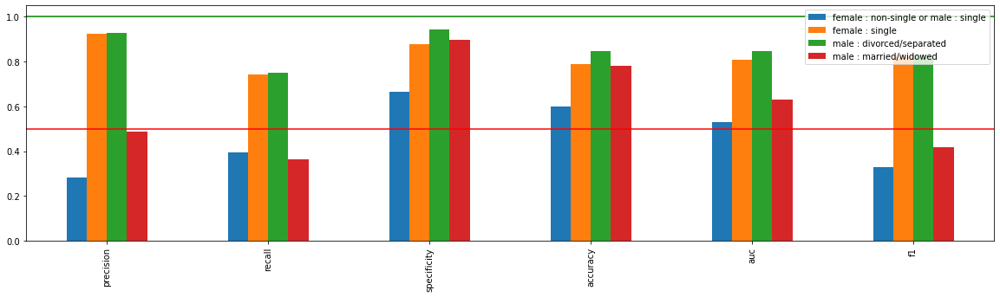

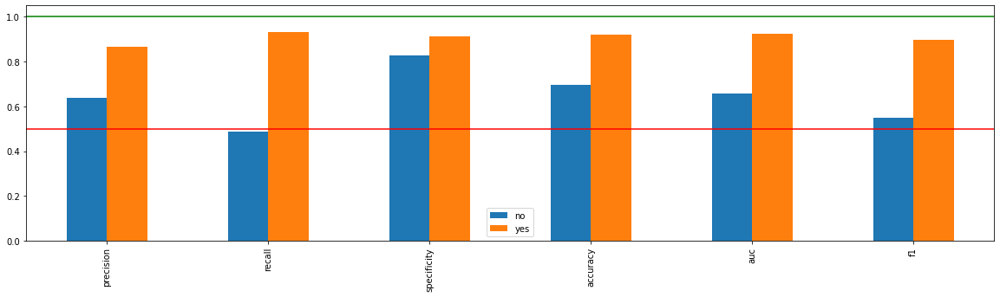

In [818]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_gnb, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Plot 1: Model performance based on Sex [Male,Female]  Plot 2: Model performance based on Age [Student, Adult1, Adult2, Adult3, Senior]

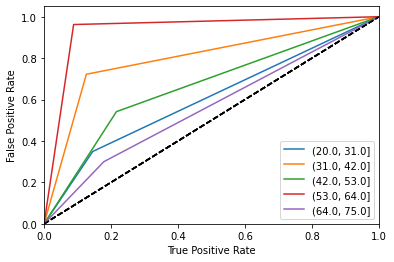

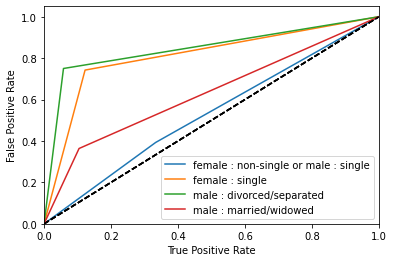

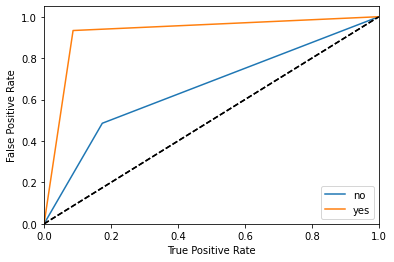

In [819]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_gnb, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

In [820]:
#d2 = xai.smile_imbalance(y_test,y_pred_gnb,threshold=0.75,display_breakdown=True)

In [821]:
#d2 = xai.smile_imbalance(
#    y_test, 
#    y_pred_gnb,
#    bins=1,
#    threshold=0.75,
#    manual_review=0.00001,
#    display_breakdown=True)

Model 2 GNB Feature level explainations

In [822]:
perm_GNB = PermutationImportance(GNB, random_state=seed).fit(x,y)
eli5.show_weights(perm_GNB, feature_names = x.columns.tolist())

Weight,Feature
0.0662 ± 0.0119,other_installment_plans
0.0417 ± 0.0028,property
0.0361 ± 0.0101,amount
0.0249 ± 0.0072,age
0.0245 ± 0.0028,duration
0.0201 ± 0.0036,purpose
0.0171 ± 0.0038,other_debtors
0.0131 ± 0.0037,housing
0.0122 ± 0.0054,personal_status_sex
0.0108 ± 0.0038,number_credits


,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,0.005304,0.000769,0.022022,0.007033,0.00123,0.004689,0.011952,0.016257,0.002229,0.043736,0.066603,0.015219,0.010953,0.009454,0.000384,0.000346,0.00342,0.022406,0.039547,0.025288


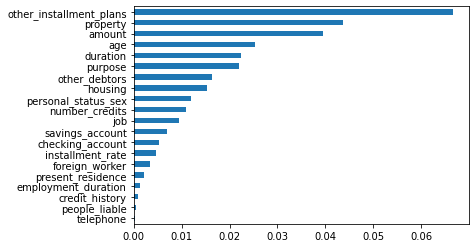

In [823]:
def get_avg_gnb(x, y):
    return accuracy_score(GNB.predict(x), y)

#Shapley values - showing importance of features for this model.
imp2 = xai.feature_importance(x, y, get_avg_gnb)
imp2.head()

Model 3 GNB Global Explainations

In [824]:
GNB_explainer =  shap.PermutationExplainer(GNB.predict,x)
GNB_shap_values = GNB_explainer.shap_values(x.values,npermutations=5)
#shap.summary_plot(GNB_shap_values.data, x.values, plot_type="bar", features = x.columns)

Permutation explainer: 2603it [00:52, 49.97it/s]                                                                                                                                                                                                                           


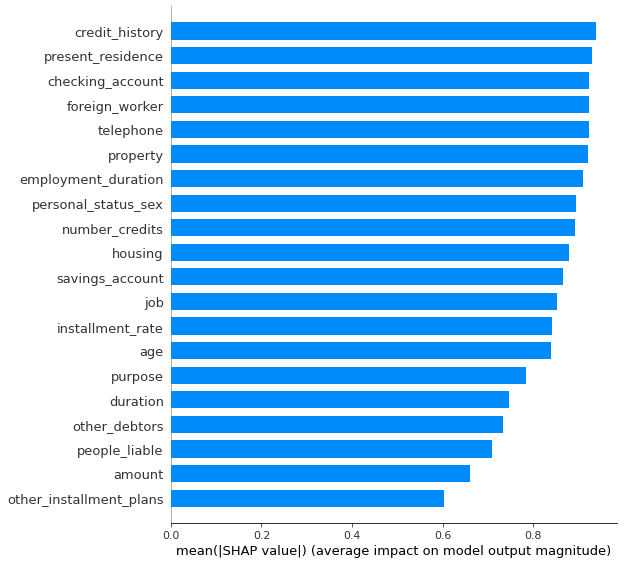

In [825]:
shap.summary_plot(GNB_shap_values.data, x.values, plot_type="bar", feature_names = x.columns)

In [826]:
GNB_shap_values

.values =
array([[ 6.9388939e-18,  0.0000000e+00, -4.0000000e-02, ...,
        -2.5000000e-02, -8.0000000e-02, -2.5000000e-02],
       [ 4.0000000e-02,  1.0000000e-02,  1.2500000e-01, ...,
         1.4500000e-01, -1.0000000e-01, -1.8500000e-01],
       [ 3.0000000e-02,  0.0000000e+00, -1.5000000e-02, ...,
         2.3000000e-01,  1.4500000e-01,  0.0000000e+00],
       ...,
       [ 0.0000000e+00, -1.5000000e-02,  5.0000000e-03, ...,
        -3.0000000e-02, -8.5000000e-02,  1.5000000e-01],
       [ 0.0000000e+00, -5.0000000e-03, -1.5000000e-02, ...,
        -2.5000000e-02, -8.5000000e-02,  1.4500000e-01],
       [-1.0000000e-02, -5.0000000e-03,  5.0000000e-03, ...,
        -4.5000000e-02, -7.5000000e-02,  2.8500000e-01]])

.base_values =
array([0.31, 0.31, 0.31, ..., 0.31, 0.31, 0.31])

.data =
array([[ 1.1488124 ,  0.8448553 , -1.16862051, ..., -0.03853577,
        -0.34652777, -1.26342089],
       [-1.31144264,  0.8448553 ,  0.39877669, ...,  1.10089688,
        -0.30614035, -1.011636

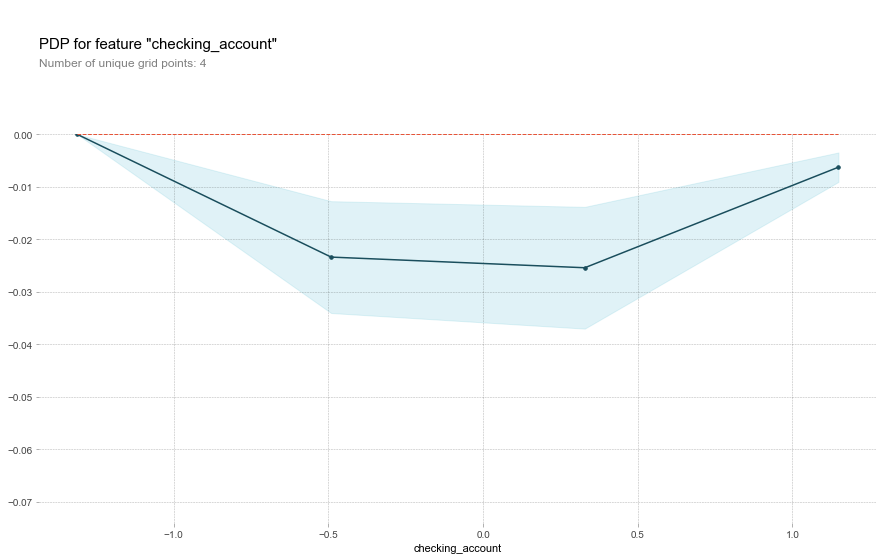

In [827]:
# Create the data that we will plot
pdp_CheckingAccount_GNB = pdp.pdp_isolate(model=GNB, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_GNB, 'checking_account')
plt.show()

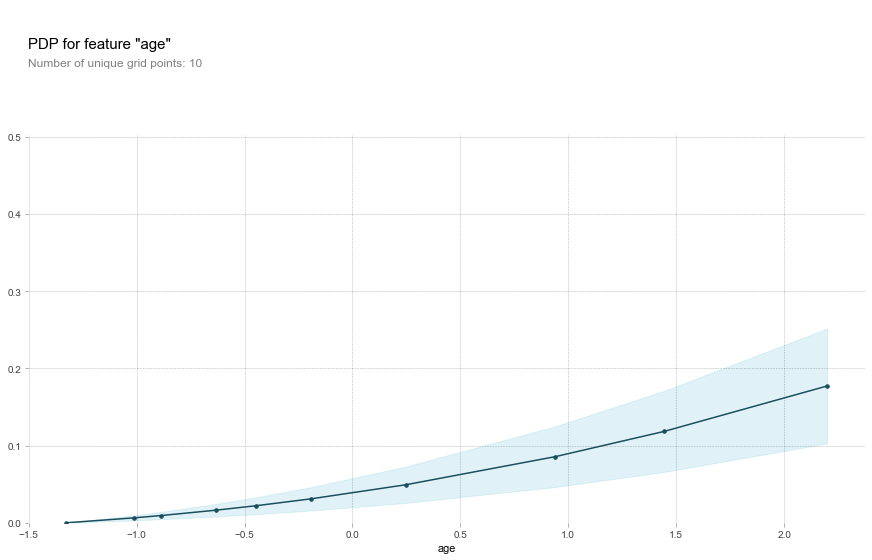

In [828]:
# Create the data that we will plot
pdp_Age_GNB = pdp.pdp_isolate(model=GNB, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_GNB, 'age')
plt.show()

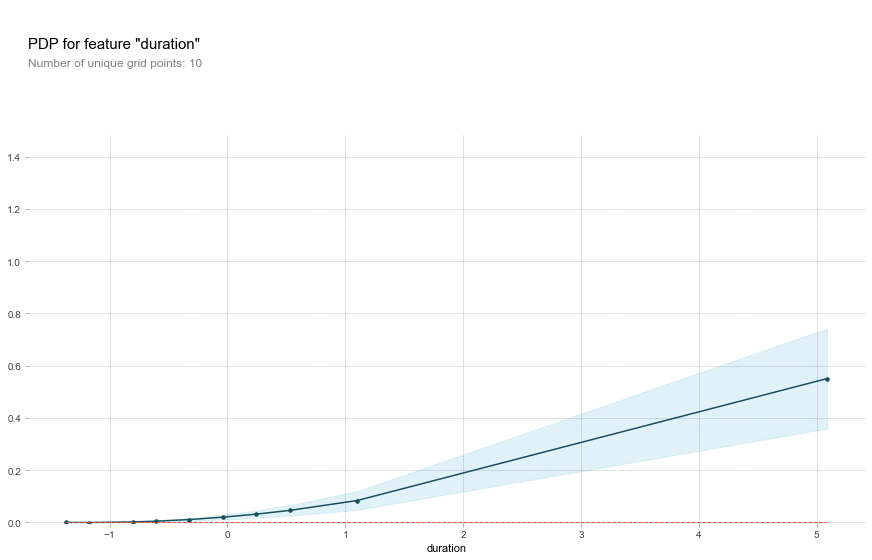

In [829]:
# Create the data that we will plot
pdp_Duration_GNB = pdp.pdp_isolate(model=GNB, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_GNB, 'duration')
plt.show()

In [1272]:
 GNB_shap_values.data

array([[ 1.1488124 ,  0.8448553 , -1.16862051, ..., -0.03853577,
        -0.34652777, -1.26342089],
       [-1.31144264,  0.8448553 ,  0.39877669, ...,  1.10089688,
        -0.30614035, -1.01163664],
       [ 1.1488124 , -1.36895486, -1.16862051, ...,  1.67061321,
         1.17800655, -1.0745827 ],
       ...,
       [ 0.32872739, -1.36895486,  0.39877669, ..., -1.17796842,
        -0.61577727,  2.13566659],
       [ 0.32872739, -1.36895486,  0.39877669, ..., -1.17796842,
        -0.61577727,  2.13566659],
       [ 0.32872739, -1.36895486,  0.39877669, ..., -1.17796842,
        -0.61577727,  2.13566659]])

In [1271]:
shap.dependence_plot('age',  GNB_shap_values.data[0], x)

TypeError: order must be str, not int

In [ ]:
shap.dependence_plot('personal_status_sex',  GNB_shap_values.data, x)

In [ ]:
shap.dependence_plot('foreign_worker',  GNB_shap_values.data, x)

Model 2 GNB Local Explainations

In [830]:
#GNB_explainer.expected_value

In [1190]:
idx = 7
shap.initjs()
shap.force_plot(GNB_shap_values.base_values[0], GNB_shap_values.data[idx], features=x_train.columns)

In [1191]:
test_idx = 5
predict_fn_GNB = lambda a: GNB.predict(a)
x_test.iloc[test_idx]

checking_account          -1.348383
credit_history            -1.361267
purpose                    0.414543
savings_account            0.646014
employment_duration        0.477033
installment_rate           0.273180
personal_status_sex        0.169183
other_debtors              0.412414
present_residence          1.069233
property                  -1.244741
other_installment_plans    0.117414
housing                    0.607098
number_credits             0.839309
job                       -0.377410
people_liable             -0.421660
telephone                 -0.701339
foreign_worker            -0.658812
duration                   1.666230
amount                    -0.132708
age                       -0.855497
Name: 650, dtype: float64

In [833]:
y_pred_GNB = GNB.predict(x_test)
y_pred_GNB

array([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0,
       1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1,
       0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1,
       0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0,
       0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0,
       1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0,
       0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1,
       1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1,

In [834]:
expGNB = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_GNB,num_features=20)

Intercept 0.8346171137087193
Prediction_local [0.08668495]
Right: 0


In [835]:
expGNB.show_in_notebook(show_table=True)

In [836]:
scoreGNB, closest_classGNB = ts.score(x_test,
                                y_pred_GNB,
                                k=2,
                                dist_type='point')

In [837]:
#scoreGNB, closest_classGNB

Model 3 : XG boost

In [838]:
XG_grid_search.best_score_

0.9277158555729985

In [839]:
XG_grid_search.best_params_

{'colsample_bytree': 0.75,
 'gamma': 0.2,
 'max_depth': 5,
 'min_child_weight': 3,
 'reg_alpha': 1e-05,
 'subsample': 0.75}

In [840]:
best_estimators_xai[6].best_params_

{'colsample_bytree': 0.8,
 'gamma': 0.1,
 'max_depth': 6,
 'min_child_weight': 5,
 'reg_alpha': 0.1,
 'subsample': 0.8}

In [841]:
best_estimators_xai[6].best_score_

0.8091304347826087

In [842]:
#xGB = XG_grid_search.best_estimator_
xGB = best_estimators_xai[6].best_estimator_
#xGB

In [843]:
# Printing the Training Score
print("Training score data: ")
print(xGB.score(x_train, y_train))

Training score data: 
0.9671963095848283


In [844]:
y_pred_xgb = xGB.predict(x_test)
y_pred_xgb = np.array([1 if a >= 0.5 else 0 for a in y_pred_xgb])

print(accuracy_score(y_test,y_pred_xgb)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_xgb))
print("\n")
print(classification_report(y_test, y_pred_xgb))

96.00614439324117
 percent


[[393  10]
 [ 16 232]]


              precision    recall  f1-score   support

           0       0.96      0.98      0.97       403
           1       0.96      0.94      0.95       248

    accuracy                           0.96       651
   macro avg       0.96      0.96      0.96       651
weighted avg       0.96      0.96      0.96       651



In [845]:
print("Actual # : ",len(y_pred_xgb)," Successfully Predicted # :",len(y_test))

Actual # :  651  Successfully Predicted # : 651


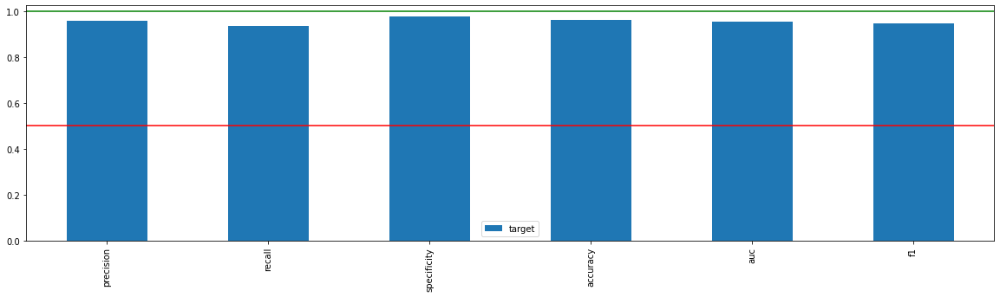

In [846]:
_= xai.metrics_plot(y_test,y_pred_xgb)

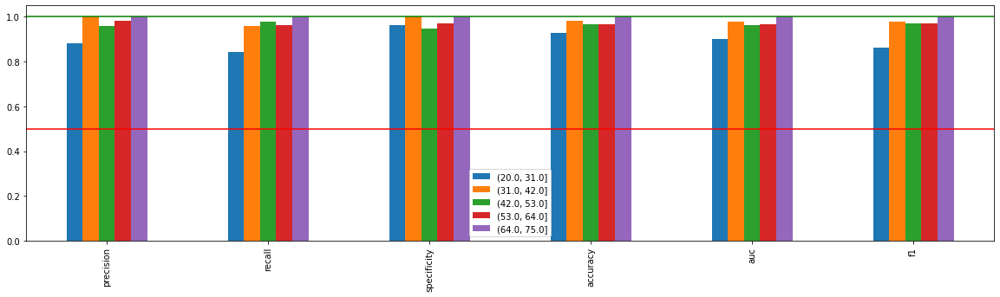

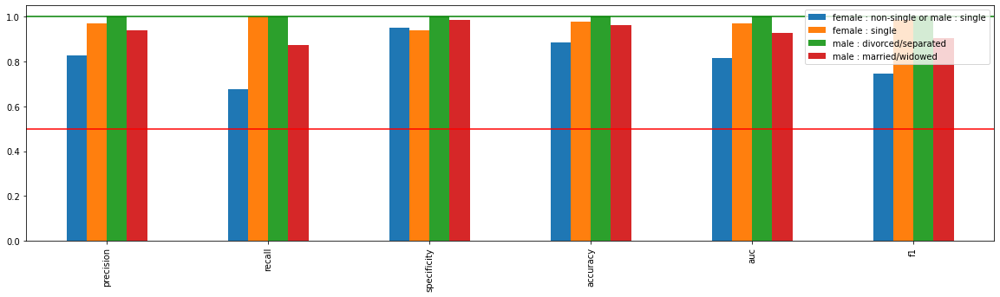

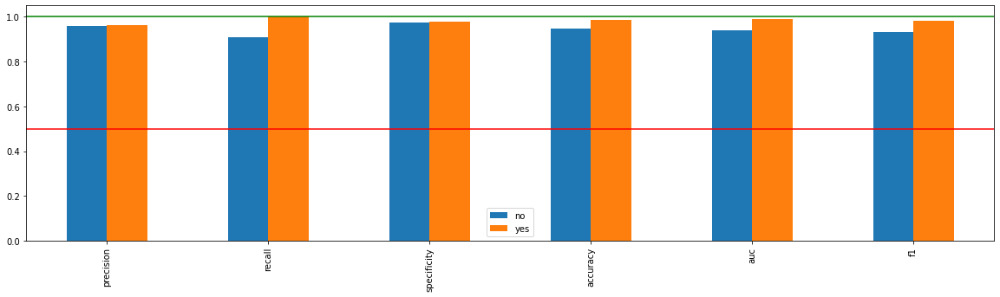

In [847]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_xgb, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Plot 1: Model performance based on Sex [Male,Female]  Plot 2: Model performance based on Age [Student, Adult1, Adult2, Adult3, Senior]

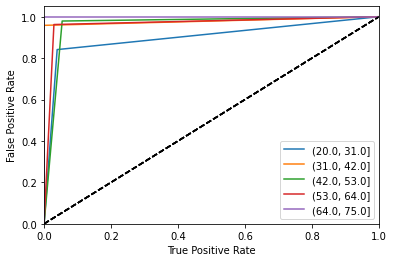

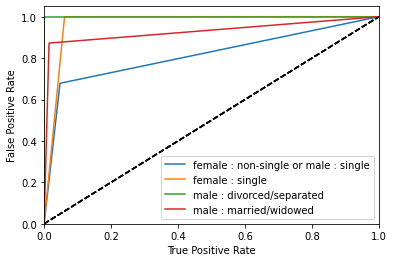

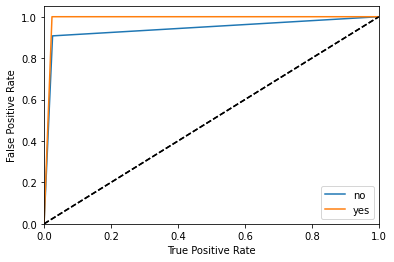

In [848]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_xgb, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

In [849]:
#d2 = xai.smile_imbalance(y_test,y_pred_gnb,threshold=0.75,display_breakdown=True)

In [850]:
#d2 = xai.smile_imbalance(
#    y_test, 
#    y_pred_gnb,
#    bins=1,
#    threshold=0.75,
#    manual_review=0.00001,
#    display_breakdown=True)

In [851]:
perm_xGB = PermutationImportance(xGB, random_state=seed).fit(x,y)
eli5.show_weights(perm_xGB, feature_names = x.columns.tolist())

Weight,Feature
0.0778 ± 0.0068,checking_account
0.0563 ± 0.0049,age
0.0557 ± 0.0071,duration
0.0452 ± 0.0074,amount
0.0376 ± 0.0053,purpose
0.0361 ± 0.0052,property
0.0295 ± 0.0059,credit_history
0.0243 ± 0.0052,foreign_worker
0.0173 ± 0.0031,personal_status_sex
0.0153 ± 0.0026,present_residence


,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,0.078209,0.027825,0.037586,0.015373,0.00784,0.009032,0.015642,0.001653,0.01568,0.032859,0.001345,0.012798,0.007341,0.005035,0.00269,0.005611,0.022598,0.057686,0.045772,0.059954


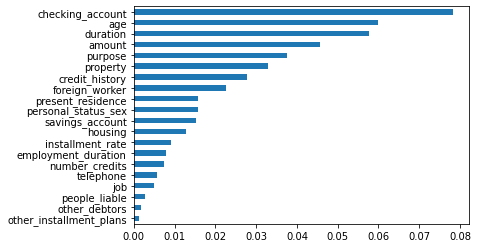

In [852]:
def get_avg_xgb(x, y):
    return accuracy_score(np.array([1 if a >= 0.5 else 0 for a in xGB.predict(x)]), y)

#Shapley values - showing importance of features for this model.
imp2 = xai.feature_importance(x, y, get_avg_xgb)
imp2.head()

Model 3 XG Boost Global Explainations

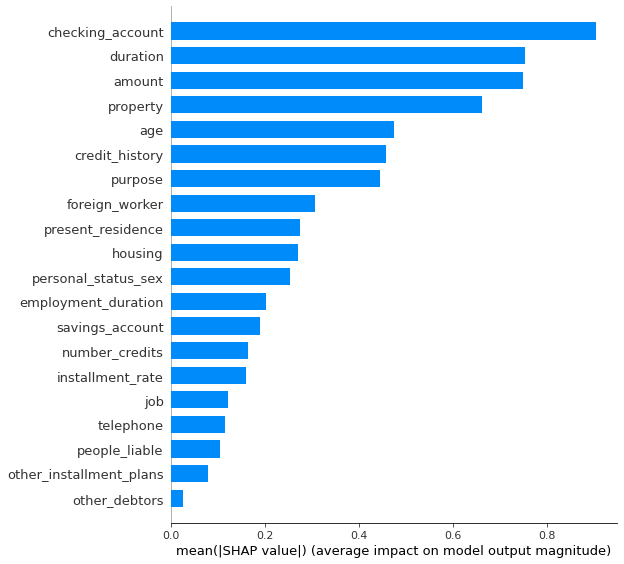

In [1193]:
xGB_explainer =  shap.TreeExplainer(xGB)
xGB_shap_values = xGB_explainer.shap_values(x)
shap.summary_plot(xGB_shap_values, x, plot_type="bar")

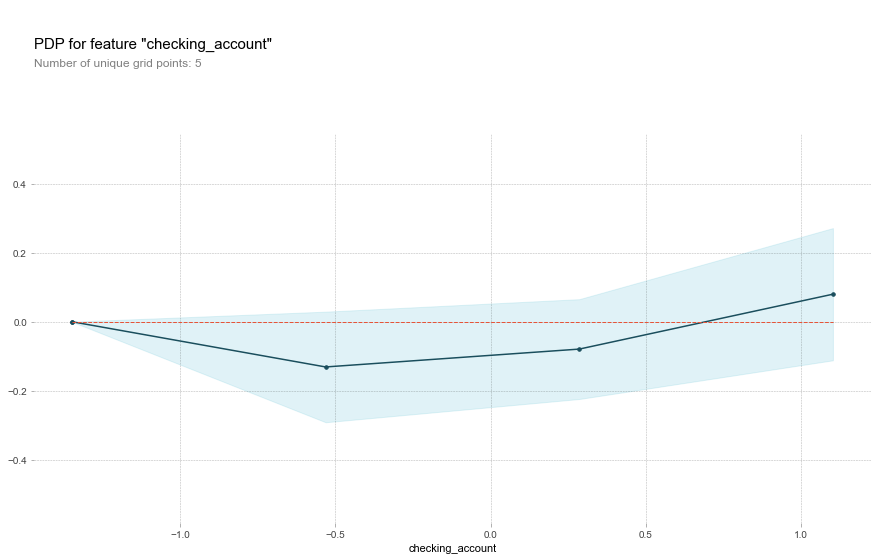

In [1194]:
# Create the data that we will plot
pdp_CheckingAccount_xGB = pdp.pdp_isolate(model=xGB, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_xGB, 'checking_account')
plt.show()

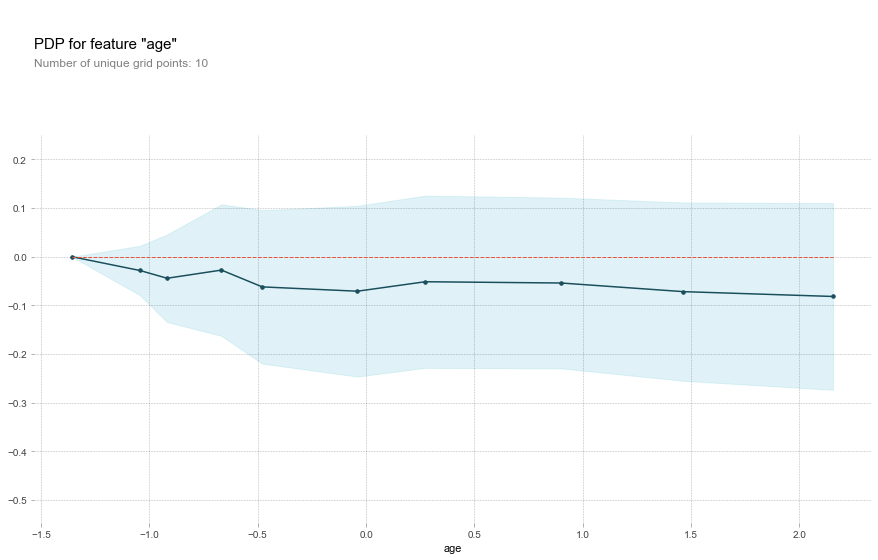

In [1195]:
# Create the data that we will plot
pdp_Age_xGB = pdp.pdp_isolate(model=xGB, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_xGB, 'age')
plt.show()

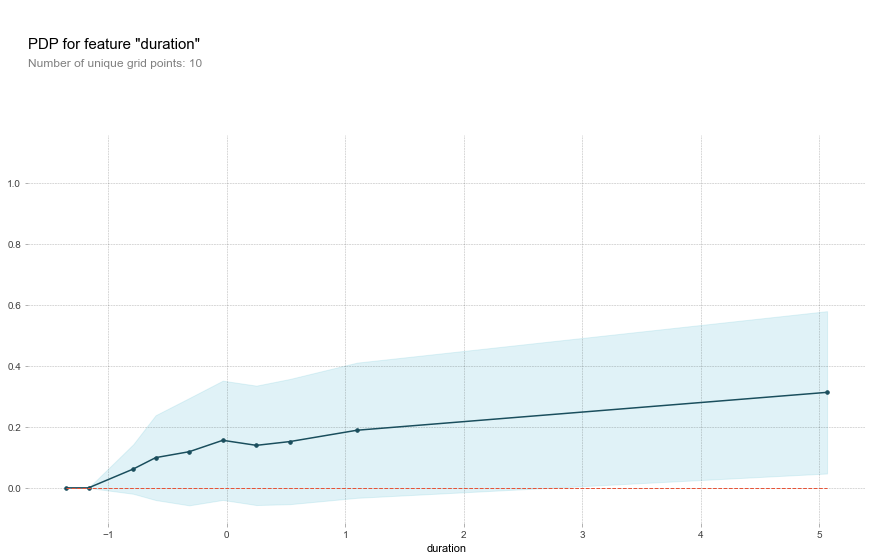

In [1196]:
# Create the data that we will plot
pdp_Duration_xGB = pdp.pdp_isolate(model=xGB, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_xGB, 'duration')
plt.show()

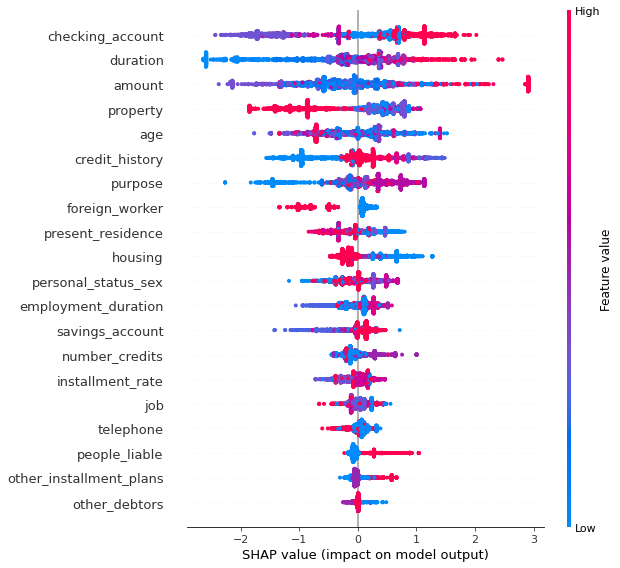

In [1197]:
shap.summary_plot(xGB_shap_values, x)

In [1198]:
xGB_shap_values

array([[ 1.1475713 ,  0.01447187,  0.5533806 , ..., -1.7315806 ,
        -0.02715063,  0.9325635 ],
       [ 0.86302495,  0.08099876, -0.14397223, ..., -0.13901693,
        -0.73692095, -0.4103878 ],
       [ 1.2203361 , -0.15741031,  0.91654533, ...,  0.01981245,
         0.15437107, -0.03445813],
       ...,
       [-0.32458112, -0.96927243,  0.34526703, ..., -2.5906796 ,
        -0.06481507, -0.70943403],
       [-0.32458112, -0.96927243,  0.34526703, ..., -2.5906796 ,
        -0.06481507, -0.70943403],
       [-0.32458112, -0.96927243,  0.34526703, ..., -2.5906796 ,
        -0.06481507, -0.70943403]], dtype=float32)

Model 3 XG Local Explainations

In [1199]:
xGB_explainer.expected_value

-0.6409584

In [1200]:
idx = 7
shap.initjs()
shap.force_plot(xGB_explainer.expected_value, xGB_shap_values[idx], features=x_train.columns)

In [1201]:
predict_lambda_xGB = lambda x: xGB.predict(pd.DataFrame(x).rename(columns={0 : 'checking_account',1 : 'credit_history',2 : 'purpose',3 : 'savings_account',4 : 'employment_duration',5 : 'installment_rate',6 : 'personal_status_sex',7 : 'other_debtors',8 : 'present_residence',9 : 'property',10 : 'other_installment_plans',11 : 'housing',12 : 'number_credits',13 : 'job',14 : 'people_liable',15 : 'telephone',16 : 'foreign_worker',17 : 'duration',18 : 'amount',19 : 'age'}))
predict_fn_xGB = lambda x: np.array([1 if a > 0.5 else 0 for a in predict_lambda_xGB(x)]).astype('int8')
                                                                                   
test_idx = 5
#names = xGB.get_booster().feature_names
#predict_fn_xGB(test_value)
#pd.DataFrame(x_test.values[test_idx]).T
#x_test.iloc[[test_idx]]
#pd.DataFrame(x_test.values[test_idx].reshape(1,-1)).rename(columns={0:'Age',1:'Sex',2:'Job',3:'Housing',4:'Saving accounts',5:'Checking account',6:'Credit amount',7:'Duration',8:'Purpose',9:'Job_lvl'})
x_test.iloc[test_idx]

checking_account          -1.348383
credit_history            -1.361267
purpose                    0.414543
savings_account            0.646014
employment_duration        0.477033
installment_rate           0.273180
personal_status_sex        0.169183
other_debtors              0.412414
present_residence          1.069233
property                  -1.244741
other_installment_plans    0.117414
housing                    0.607098
number_credits             0.839309
job                       -0.377410
people_liable             -0.421660
telephone                 -0.701339
foreign_worker            -0.658812
duration                   1.666230
amount                    -0.132708
age                       -0.855497
Name: 650, dtype: float64

In [862]:
y_pred_xGB = predict_fn_xGB(x_test)
y_pred_xGB

array([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1,
       1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
       0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1,
       0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0,
       1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0,
       0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0,
       1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0,
       0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1,
       0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
       0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1,
       1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1,

In [863]:
expxGB = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_xGB, num_features=20)

Intercept 0.35503115729066015
Prediction_local [0.34182413]
Right: 0


In [864]:
expxGB.show_in_notebook(show_table=True)

In [865]:
score_xGB, closest_class_xGB = ts.score(x_test,
                                y_pred_xGB,
                                k=2,
                                dist_type='point')

In [866]:
#score_xGB, closest_class_xGB

Model 4 : KNN 

In [867]:
KNN_grid_search.best_score_

0.9082391418105704

In [868]:
KNN_grid_search.best_params_

{'metric': 'manhattan', 'n_neighbors': 3, 'weights': 'distance'}

In [869]:
best_estimators_xai[1].best_score_

0.7030434782608695

In [870]:
best_estimators_xai[1].best_estimator_

KNeighborsClassifier(metric='manhattan', n_neighbors=11, weights='distance')

In [871]:
KNN = best_estimators_xai[1].best_estimator_
#KNN = KNN_grid_search.best_estimator_
#KNN

In [872]:
# Printing the Training Score
print("Training score data: ")
print(KNN.score(x_train, y_train))

Training score data: 
0.9712967708867247


In [873]:
y_pred_knn = KNN.predict(x_test)

print(accuracy_score(y_test,y_pred_knn)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_knn))
print("\n")
print(classification_report(y_test, y_pred_knn))

98.0030721966206
 percent


[[395   8]
 [  5 243]]


              precision    recall  f1-score   support

           0       0.99      0.98      0.98       403
           1       0.97      0.98      0.97       248

    accuracy                           0.98       651
   macro avg       0.98      0.98      0.98       651
weighted avg       0.98      0.98      0.98       651



In [874]:
print("Actual # : ",len(y_pred_knn)," Successfully Predicted # :",len(y_test))

Actual # :  651  Successfully Predicted # : 651


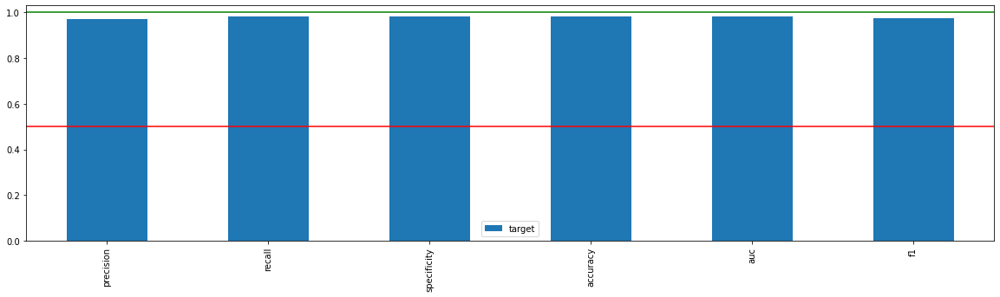

In [875]:
_= xai.metrics_plot(y_test,y_pred_knn)

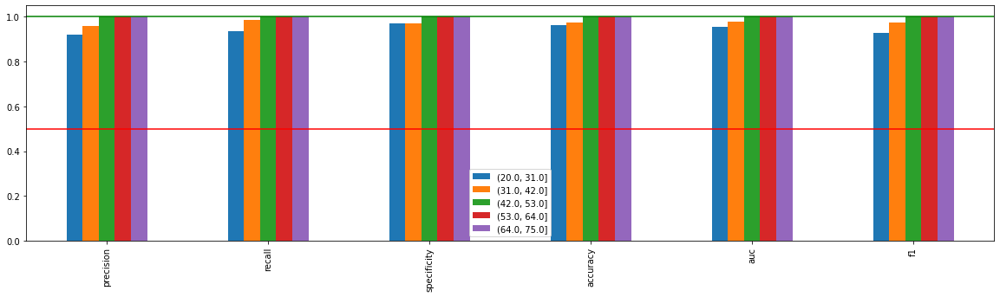

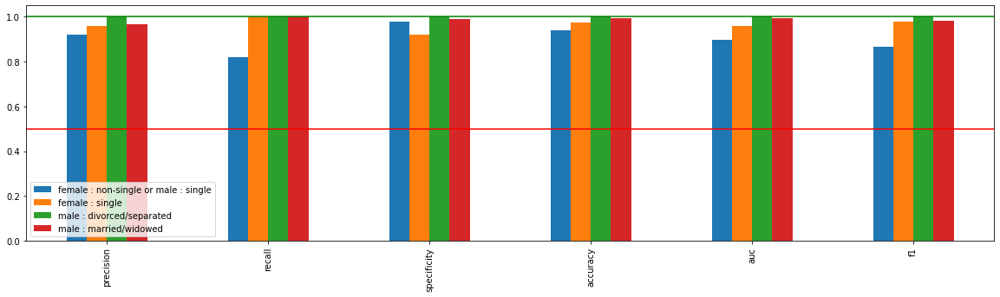

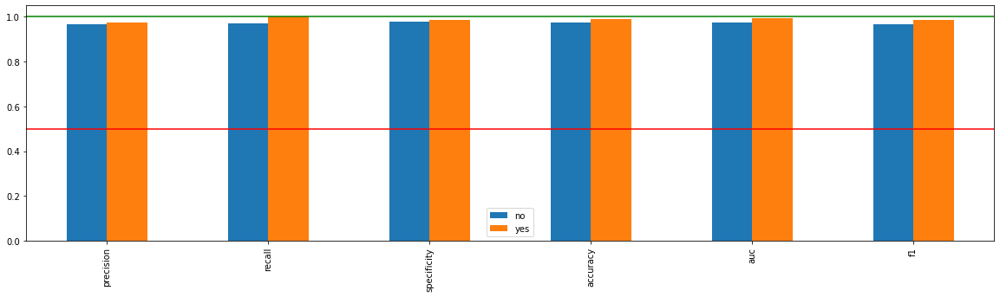

In [876]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_knn, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Plot 1: Model performance based on Sex [Male,Female]  Plot 2: Model performance based on Age [Student, Adult1, Adult2, Adult3, Senior]

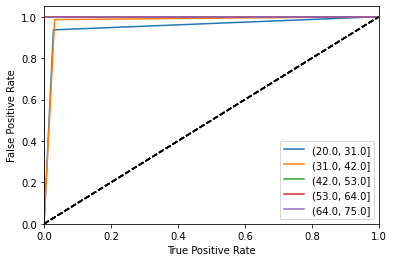

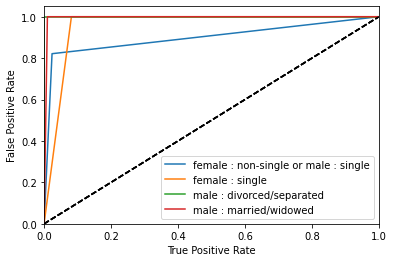

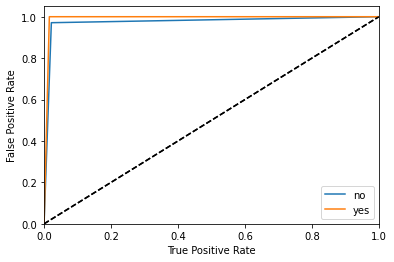

In [877]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_knn, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

In [878]:
#d2 = xai.smile_imbalance(y_test,y_pred_gnb,threshold=0.75,display_breakdown=True)

In [879]:
#d2 = xai.smile_imbalance(
#    y_test, 
#    y_pred_gnb,
#    bins=1,
#    threshold=0.75,
#    manual_review=0.00001,
#    display_breakdown=True)

In [880]:
perm_KNN = PermutationImportance(KNN, random_state=seed).fit(x,y)
eli5.show_weights(perm_KNN, feature_names = x.columns.tolist())

Weight,Feature
0.0379 ± 0.0070,checking_account
0.0378 ± 0.0072,personal_status_sex
0.0322 ± 0.0037,savings_account
0.0321 ± 0.0031,number_credits
0.0320 ± 0.0052,property
0.0280 ± 0.0040,credit_history
0.0269 ± 0.0035,duration
0.0267 ± 0.0023,present_residence
0.0262 ± 0.0056,purpose
0.0259 ± 0.0062,employment_duration


,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,0.039008,0.029862,0.026902,0.03236,0.026287,0.023021,0.035626,0.010915,0.026672,0.031553,0.016487,0.023789,0.031937,0.024212,0.014527,0.022329,0.015104,0.028363,0.022444,0.021752


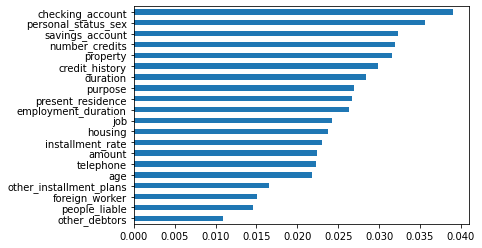

In [881]:
def get_avg_knn(x, y):
    return accuracy_score(np.array([1 if a >= 0.5 else 0 for a in KNN.predict(x)]), y)

#Shapley values - showing importance of features for this model.
imp2 = xai.feature_importance(x, y, get_avg_knn)
imp2.head()

Model 4 KNN Global Explainations

In [882]:
KNN_explainer =  shap.PermutationExplainer(KNN.predict,x)
KNN_shap_values = KNN_explainer.shap_values(x.values,npermutations=5)
#shap.summary_plot(KNN_shap_values.data, x.values, plot_type="bar", feature = x.columns)

Permutation explainer: 2603it [19:47,  2.22it/s]                                                                                                                                                                                                                           


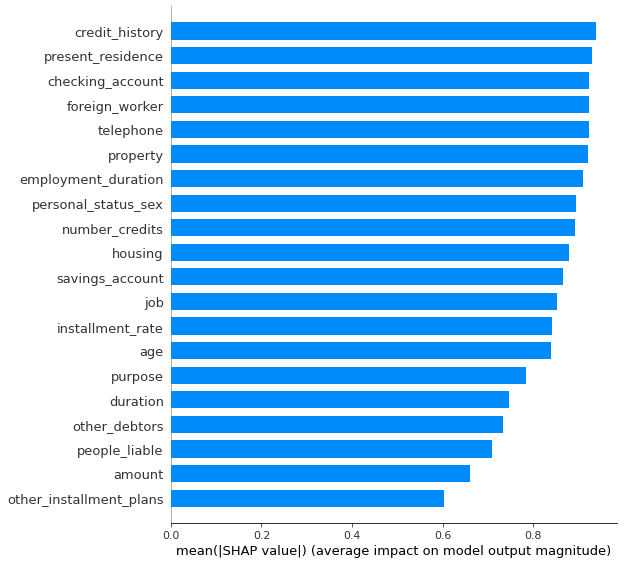

In [883]:
shap.summary_plot(KNN_shap_values.data, x.values, plot_type="bar", feature_names = x.columns)

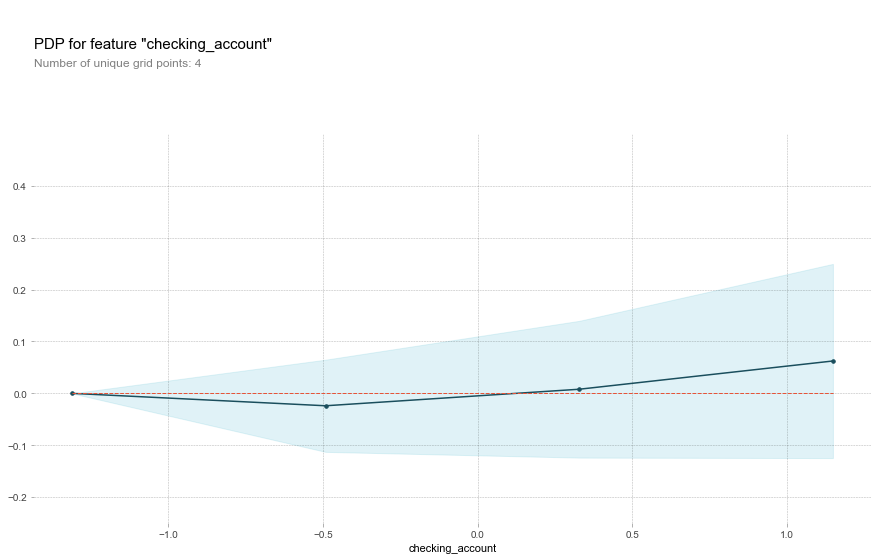

In [884]:
# Create the data that we will plot
pdp_CheckingAccount_KNN = pdp.pdp_isolate(model=KNN, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_KNN, 'checking_account')
plt.show()

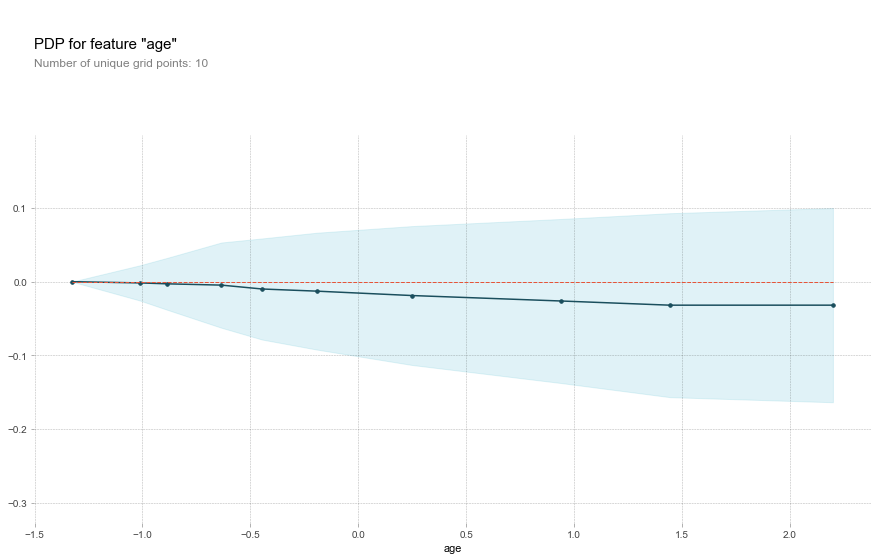

In [885]:
# Create the data that we will plot
pdp_Age_KNN = pdp.pdp_isolate(model=KNN, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_KNN, 'age')
plt.show()

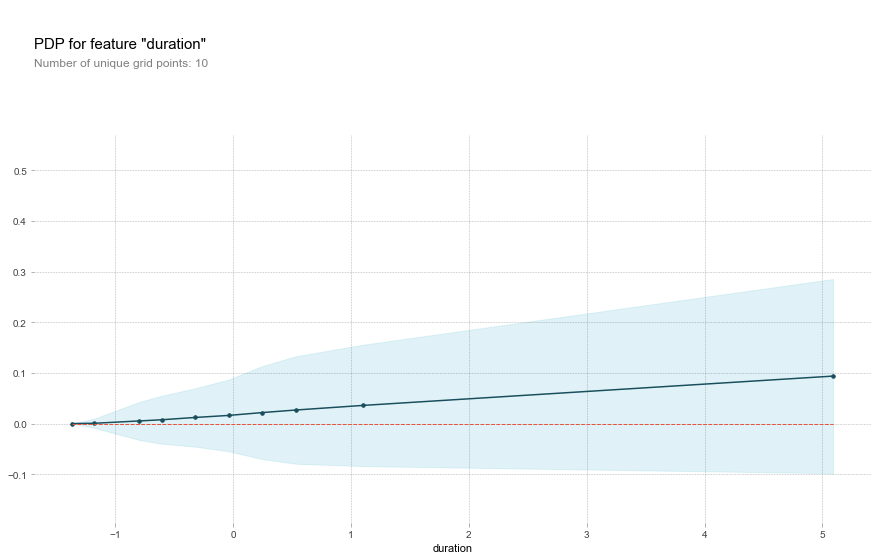

In [886]:
# Create the data that we will plot
pdp_Duration_KNN = pdp.pdp_isolate(model=KNN, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_KNN, 'duration')
plt.show()

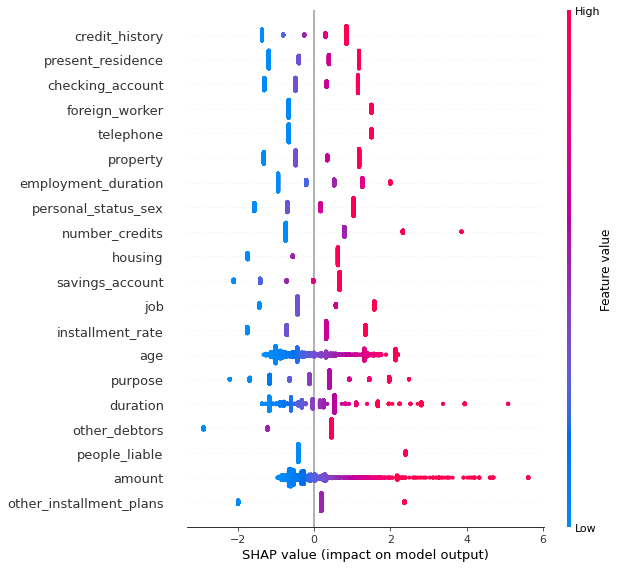

In [887]:
shap.summary_plot(KNN_shap_values.data, x)

In [888]:
KNN_shap_values.data

array([[ 1.1488124 ,  0.8448553 , -1.16862051, ..., -0.03853577,
        -0.34652777, -1.26342089],
       [-1.31144264,  0.8448553 ,  0.39877669, ...,  1.10089688,
        -0.30614035, -1.01163664],
       [ 1.1488124 , -1.36895486, -1.16862051, ...,  1.67061321,
         1.17800655, -1.0745827 ],
       ...,
       [ 0.32872739, -1.36895486,  0.39877669, ..., -1.17796842,
        -0.61577727,  2.13566659],
       [ 0.32872739, -1.36895486,  0.39877669, ..., -1.17796842,
        -0.61577727,  2.13566659],
       [ 0.32872739, -1.36895486,  0.39877669, ..., -1.17796842,
        -0.61577727,  2.13566659]])

In [889]:
KNN_shap_values.base_values

array([0.31, 0.31, 0.31, ..., 0.31, 0.31, 0.31])

Model 4 KNN Local Explainations

In [1202]:
idx = 5
shap.initjs()
shap.force_plot(KNN_shap_values.base_values[0], KNN_shap_values.data[idx], features=x_train.columns)

In [891]:
test_idx = 5
#names = xGB.get_booster().feature_names
#predict_fn_xGB(test_value)
#pd.DataFrame(x_test.values[test_idx]).T
#x_test.iloc[[test_idx]]
#pd.DataFrame(x_test.values[test_idx].reshape(1,-1)).rename(columns={0:'Age',1:'Sex',2:'Job',3:'Housing',4:'Saving accounts',5:'Checking account',6:'Credit amount',7:'Duration',8:'Purpose',9:'Job_lvl'})
predict_fn_KNN = lambda a: KNN.predict(a)
x_test.iloc[test_idx]

checking_account           1.148812
credit_history             0.844855
purpose                    0.398777
savings_account           -1.416869
employment_duration       -0.212180
installment_rate          -0.721069
personal_status_sex        1.036061
other_debtors             -2.902509
present_residence         -1.191297
property                   1.177538
other_installment_plans    0.185375
housing                    0.623639
number_credits            -0.745881
job                        1.577131
people_liable             -0.416088
telephone                 -0.665094
foreign_worker             1.502189
duration                   0.246322
amount                     0.280751
age                       -1.011637
Name: 1937, dtype: float64

In [892]:
y_pred_KNN = predict_fn_KNN(x_test)
y_pred_KNN

array([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1,
       1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1,
       1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0,
       1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0,
       0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0,
       1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0,
       0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1,
       0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
       0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1,
       0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1,

In [893]:
expKNN = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_KNN, num_features=20)

Intercept 0.41828123074715723
Prediction_local [0.22521596]
Right: 0


In [894]:
expKNN.show_in_notebook(show_table=True)

In [895]:
score_KNN, closest_class_KNN = ts.score(x_test,
                                y_pred_KNN,
                                k=2,
                                dist_type='point')

In [896]:
#score_KNN, closest_class_KNN

Model 5 LDA

In [897]:
LDA_grid_search.best_score_

0.7452433281004709

In [898]:
LDA_grid_search.best_params_

{'solver': 'svd'}

In [899]:
best_estimators_xai[0].best_score_

0.5417391304347827

In [900]:
best_estimators_xai[0].best_estimator_

LinearDiscriminantAnalysis()

In [901]:
LDA = best_estimators_xai[0].best_estimator_
#LDA = LDA_grid_search.best_estimator_
#LDA

In [902]:
# Printing the Training Score
print("Training score data: ")
print(LDA.score(x_train, y_train))

Training score data: 
0.7150179395181958


In [903]:
y_pred_lda = LDA.predict(x_test)

print(accuracy_score(y_test,y_pred_lda)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_lda))
print("\n")
print(classification_report(y_test, y_pred_lda))

71.7357910906298
 percent


[[322  81]
 [103 145]]


              precision    recall  f1-score   support

           0       0.76      0.80      0.78       403
           1       0.64      0.58      0.61       248

    accuracy                           0.72       651
   macro avg       0.70      0.69      0.69       651
weighted avg       0.71      0.72      0.71       651



In [904]:
print("Actual # : ",len(y_pred_lda)," Successfully Predicted # :",len(y_test))

Actual # :  651  Successfully Predicted # : 651


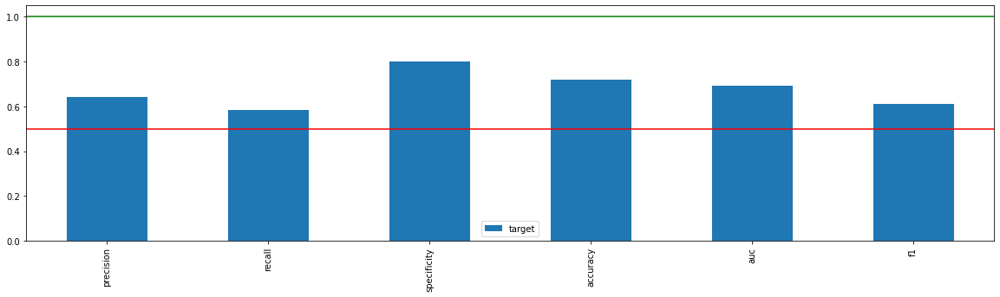

In [905]:
_= xai.metrics_plot(y_test,y_pred_lda)

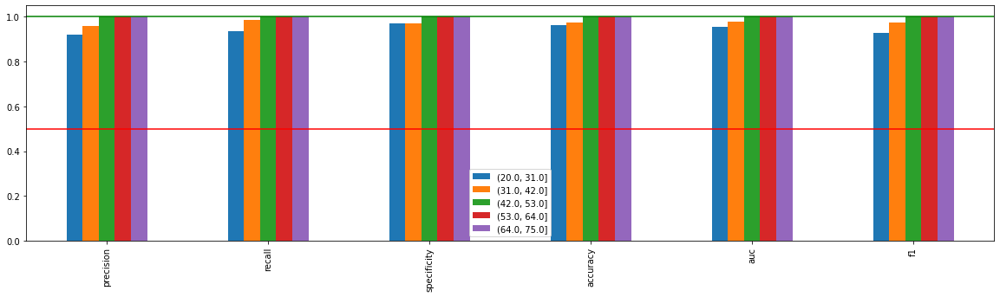

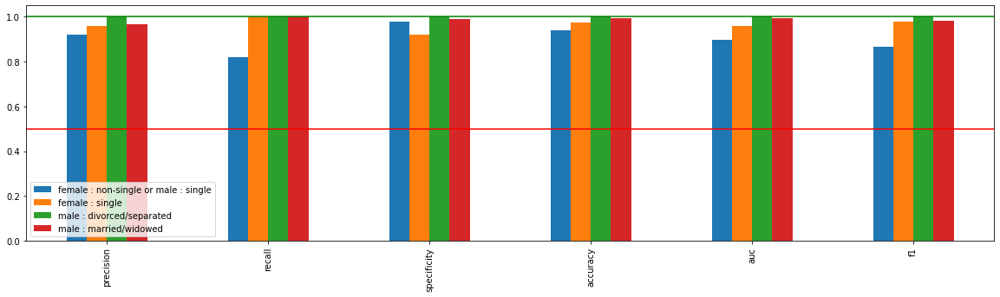

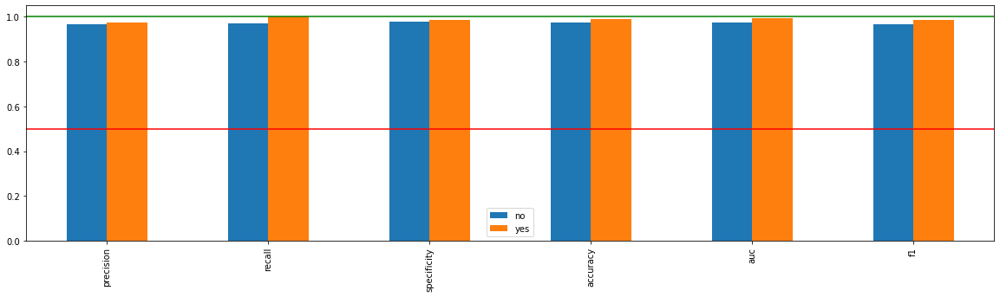

In [906]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_knn, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Plot 1: Model performance based on Sex [Male,Female]  Plot 2: Model performance based on Age [Student, Adult1, Adult2, Adult3, Senior]

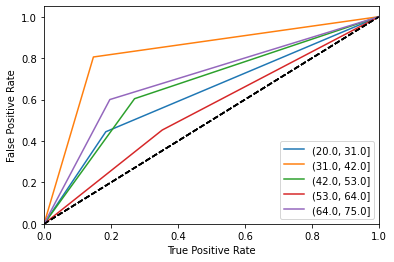

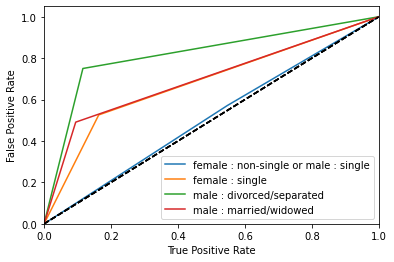

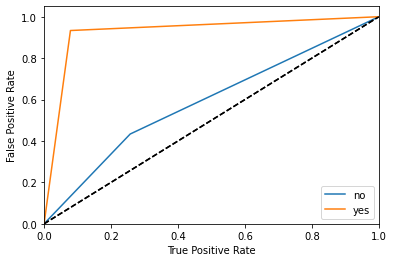

In [907]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_lda, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

In [908]:
#d2 = xai.smile_imbalance(y_test,y_pred_gnb,threshold=0.75,display_breakdown=True)

In [909]:
#d2 = xai.smile_imbalance(
#    y_test, 
#    y_pred_gnb,
#    bins=1,
#    threshold=0.75,
#    manual_review=0.00001,
#    display_breakdown=True)

In [910]:
perm_LDA = PermutationImportance(LDA, random_state=seed).fit(x,y)
eli5.show_weights(perm_LDA, feature_names = x.columns.tolist())

Weight,Feature
0.0254 ± 0.0129,housing
0.0078 ± 0.0069,personal_status_sex
0.0058 ± 0.0177,property
0.0057 ± 0.0063,job
0.0042 ± 0.0015,telephone
0.0011 ± 0.0009,foreign_worker
0.0008 ± 0.0023,people_liable
0.0006 ± 0.0020,other_installment_plans
0.0003 ± 0.0026,other_debtors
0 ± 0.0000,installment_rate


,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,-0.022752,-0.014988,0.000269,-0.002114,-0.015104,0.0,0.007225,0.000461,-0.010684,0.00784,-0.000576,0.024827,-0.005534,0.004035,0.000653,0.003613,0.000999,-0.006764,-0.000154,-0.009224


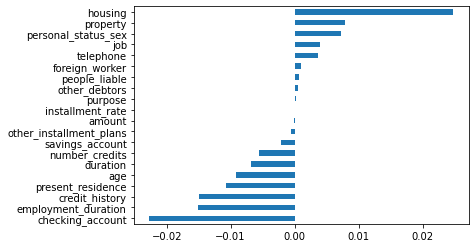

In [911]:
def get_avg_lda(x, y):
    return accuracy_score(np.array([1 if a >= 0.5 else 0 for a in LDA.predict(x)]), y)

#Shapley values - showing importance of features for this model.
imp2 = xai.feature_importance(x, y, get_avg_lda)
imp2.head()

Model 5 LDA Global Explainations

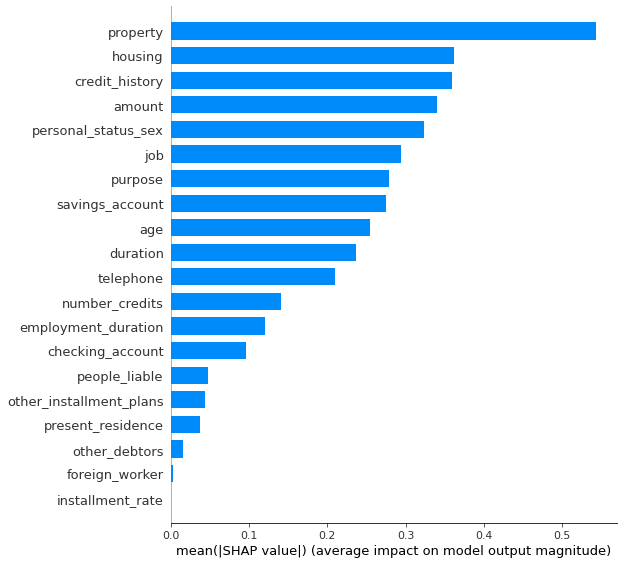

In [912]:
LDA_explainer =  shap.LinearExplainer(LDA,x)
LDA_shap_values = LDA_explainer.shap_values(x)
shap.summary_plot(LDA_shap_values, x.values, plot_type="bar", feature_names = x.columns)

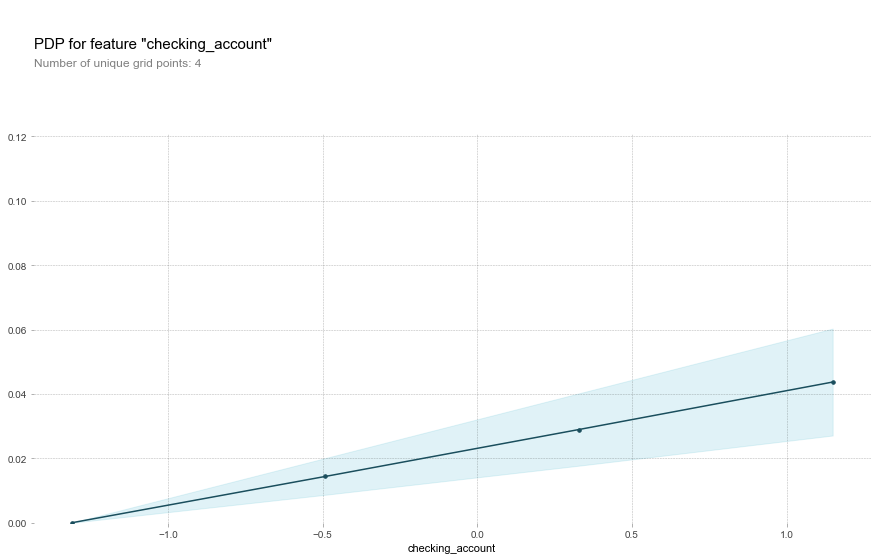

In [913]:
# Create the data that we will plot
pdp_CheckingAccount_LDA = pdp.pdp_isolate(model=LDA, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_LDA, 'checking_account')
plt.show()

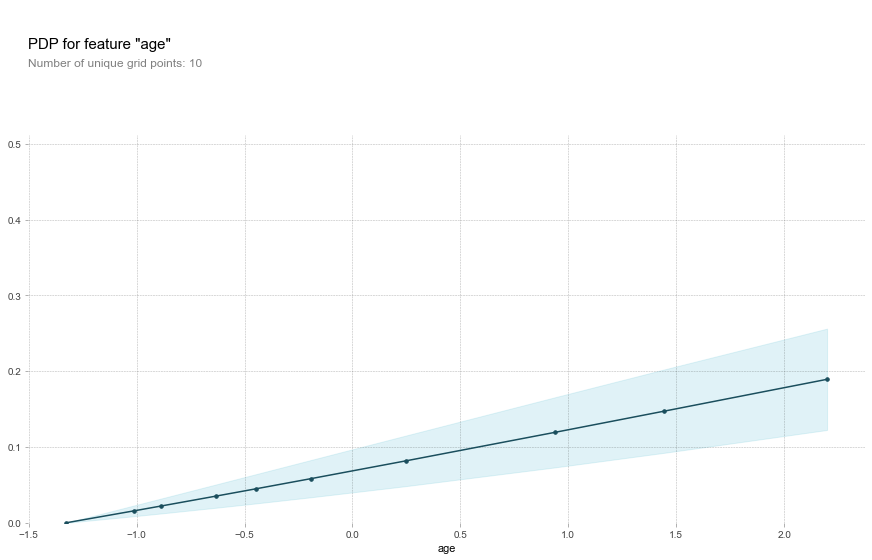

In [914]:
# Create the data that we will plot
pdp_Age_LDA = pdp.pdp_isolate(model=LDA, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_LDA, 'age')
plt.show()

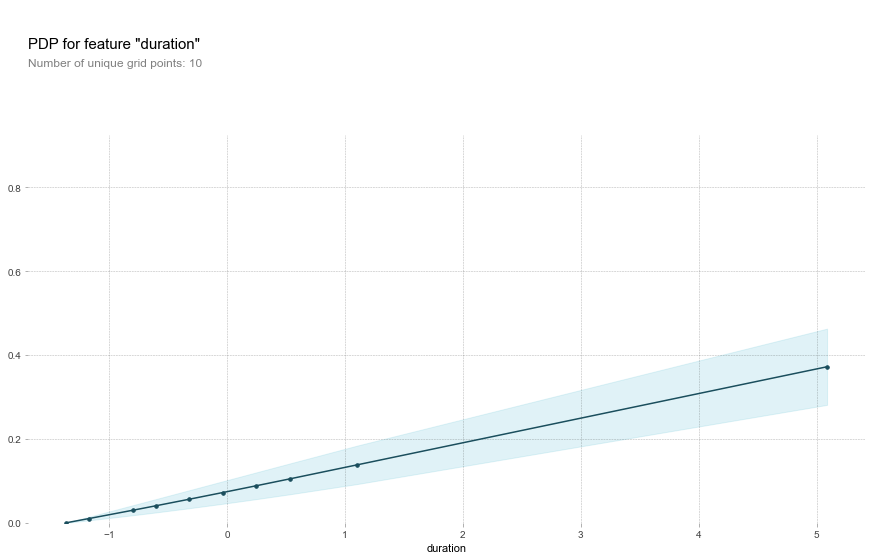

In [915]:
# Create the data that we will plot
pdp_Duration_LDA = pdp.pdp_isolate(model=LDA, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_LDA, 'duration')
plt.show()

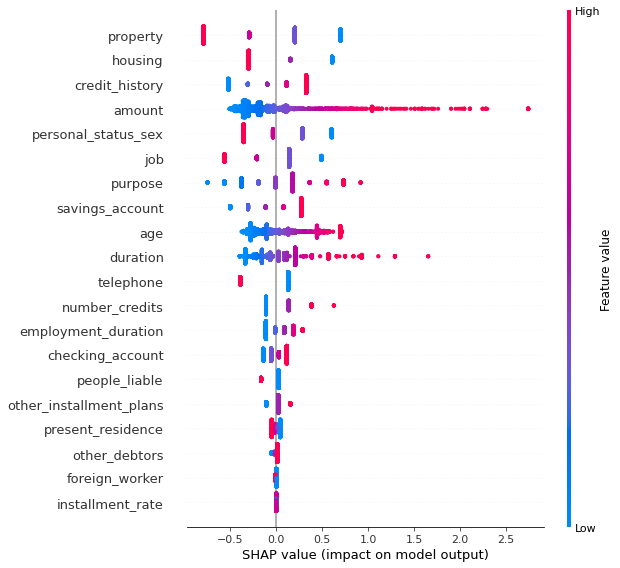

In [916]:
shap.summary_plot(LDA_shap_values, x)

In [917]:
LDA_explainer.expected_value

-0.6496782580488352

In [918]:
LDA_shap_values

array([[ 0.11491731,  0.32554392, -0.37790281, ...,  0.025619  ,
        -0.20506831, -0.35656402],
       [-0.14045449,  0.32554392,  0.17783662, ...,  0.38729898,
        -0.18510988, -0.27854126],
       [ 0.11491731, -0.5200247 , -0.37790281, ...,  0.56813896,
         0.54831723, -0.29804695],
       ...,
       [ 0.02979338, -0.5200247 ,  0.17783662, ..., -0.33606098,
        -0.33812446,  0.69674325],
       [ 0.02979338, -0.5200247 ,  0.17783662, ..., -0.33606098,
        -0.33812446,  0.69674325],
       [ 0.02979338, -0.5200247 ,  0.17783662, ..., -0.33606098,
        -0.33812446,  0.69674325]])

Model 5 LDA Local Explainations

In [919]:
idx = 7
shap.initjs()
shap.force_plot(LDA_explainer.expected_value, LDA_shap_values[idx], features=x_train.columns)

In [920]:
test_idx = 5
#names = xGB.get_booster().feature_names
#predict_fn_xGB(test_value)
#pd.DataFrame(x_test.values[test_idx]).T
#x_test.iloc[[test_idx]]
#pd.DataFrame(x_test.values[test_idx].reshape(1,-1)).rename(columns={0:'Age',1:'Sex',2:'Job',3:'Housing',4:'Saving accounts',5:'Checking account',6:'Credit amount',7:'Duration',8:'Purpose',9:'Job_lvl'})
predict_fn_LDA = lambda a: LDA.predict(a)
x_test.iloc[test_idx]

checking_account           1.148812
credit_history             0.844855
purpose                    0.398777
savings_account           -1.416869
employment_duration       -0.212180
installment_rate          -0.721069
personal_status_sex        1.036061
other_debtors             -2.902509
present_residence         -1.191297
property                   1.177538
other_installment_plans    0.185375
housing                    0.623639
number_credits            -0.745881
job                        1.577131
people_liable             -0.416088
telephone                 -0.665094
foreign_worker             1.502189
duration                   0.246322
amount                     0.280751
age                       -1.011637
Name: 1937, dtype: float64

In [921]:
y_pred_LDA = predict_fn_LDA(x_test)
y_pred_LDA

array([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0,
       1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1,
       0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1,
       0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1,
       0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0,
       1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0,
       0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0,
       0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0,
       0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0,

In [922]:
expLDA = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_LDA, num_features=20)

Intercept 0.6767510806427351
Prediction_local [-0.04549288]
Right: 0


In [923]:
expLDA.show_in_notebook(show_table=True)

In [924]:
score_LDA, closest_class_LDA = ts.score(x_test,
                                y_pred_LDA,
                                k=2,
                                dist_type='point')

In [925]:
#score_LDA, closest_class_LDA

Model 6 SVM

In [926]:
SVM_grid_search.best_score_

0.9190071480097055

In [927]:
SVM_grid_search.best_params_

{'C': 1, 'gamma': 1, 'kernel': 'rbf'}

In [928]:
best_estimators_xai[5].best_params_

{'C': 1000, 'gamma': 0.001, 'kernel': 'rbf'}

In [929]:
SVM = SVM_grid_search.best_estimator_
#SVM

In [930]:
# Printing the Training Score
print("Training score data: ")
print(SVM.score(x_train, y_train))

Training score data: 
1.0


In [931]:
y_pred_svm = SVM.predict(x_test)

print(accuracy_score(y_test,y_pred_svm)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_svm))
print("\n")
print(classification_report(y_test, y_pred_svm))

93.70199692780338
 percent


[[403   0]
 [ 41 207]]


              precision    recall  f1-score   support

           0       0.91      1.00      0.95       403
           1       1.00      0.83      0.91       248

    accuracy                           0.94       651
   macro avg       0.95      0.92      0.93       651
weighted avg       0.94      0.94      0.94       651



In [932]:
print("Actual # : ",len(y_pred_svm)," Successfully Predicted # :",len(y_test))

Actual # :  651  Successfully Predicted # : 651


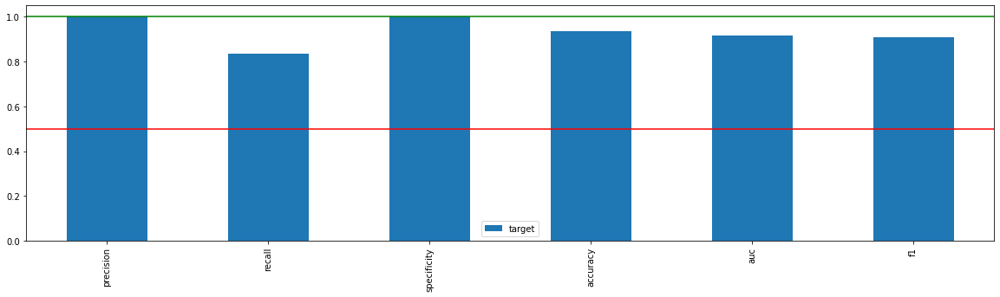

In [933]:
_= xai.metrics_plot(y_test,y_pred_svm)

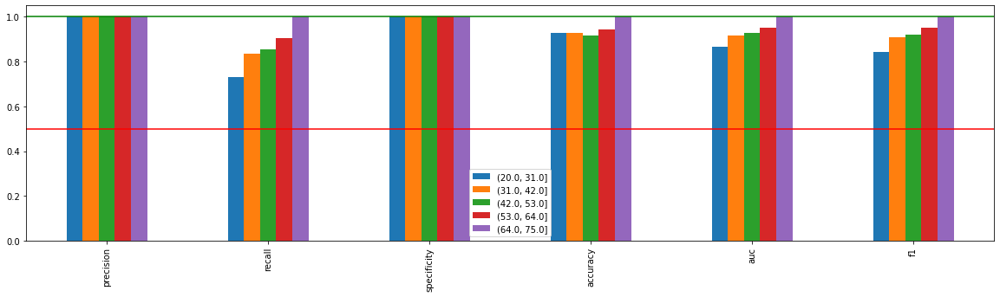

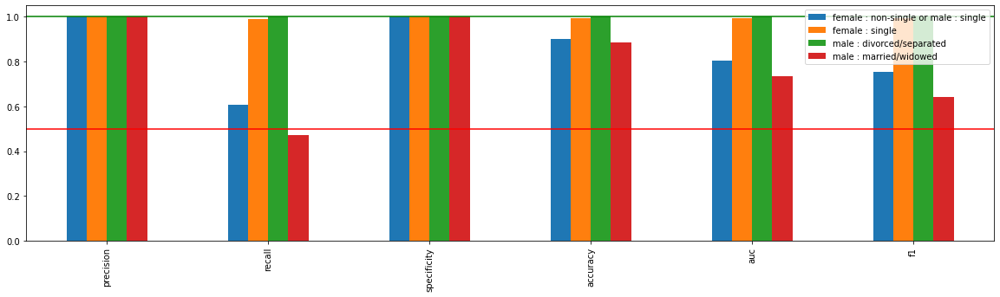

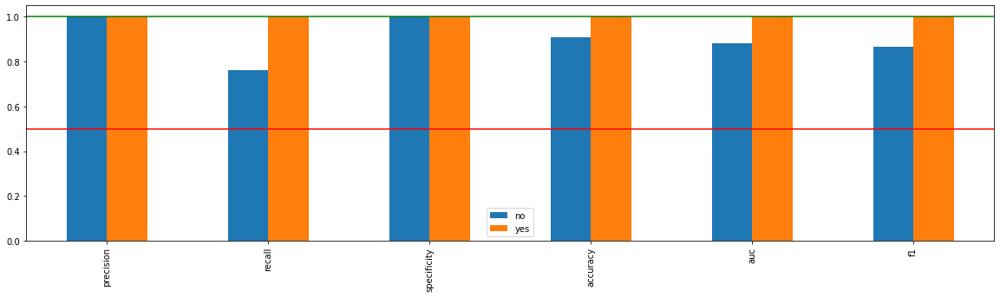

In [934]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_svm, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Plot 1: Model performance based on Sex [Male,Female]  Plot 2: Model performance based on Age [Student, Adult1, Adult2, Adult3, Senior]

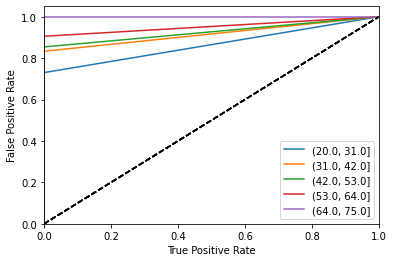

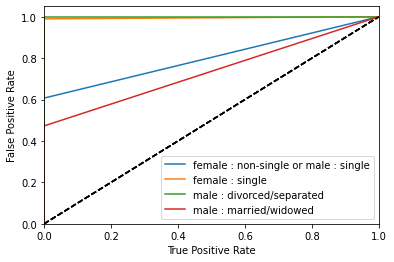

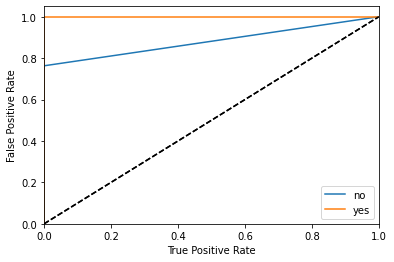

In [935]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_svm, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

In [936]:
#d2 = xai.smile_imbalance(y_test,y_pred_gnb,threshold=0.75,display_breakdown=True)

In [937]:
#d2 = xai.smile_imbalance(
#    y_test, 
#    y_pred_gnb,
#    bins=1,
#    threshold=0.75,
#    manual_review=0.00001,
#    display_breakdown=True)

In [938]:
perm_SVM = PermutationImportance(SVM, random_state=seed).fit(x,y)
eli5.show_weights(perm_SVM, feature_names = x.columns.tolist())

Weight,Feature
0.1922 ± 0.0080,number_credits
0.1786 ± 0.0136,housing
0.1762 ± 0.0114,checking_account
0.1714 ± 0.0080,other_installment_plans
0.1696 ± 0.0072,employment_duration
0.1654 ± 0.0090,property
0.1605 ± 0.0073,purpose
0.1604 ± 0.0091,credit_history
0.1593 ± 0.0131,present_residence
0.1570 ± 0.0054,telephone


,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,0.176902,0.164604,0.161261,0.126211,0.170177,0.128517,0.148002,0.122713,0.157763,0.165065,0.170869,0.177633,0.190315,0.1304,0.064604,0.153805,0.148732,0.138278,0.118947,0.152767


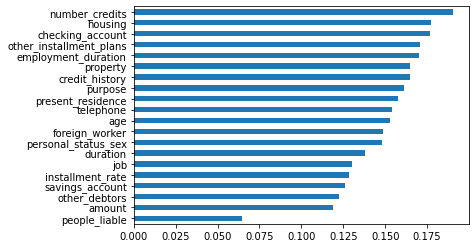

In [939]:
def get_avg_svm(x, y):
    return accuracy_score(np.array([1 if a >= 0.5 else 0 for a in SVM.predict(x)]), y)

#Shapley values - showing importance of features for this model.
imp2 = xai.feature_importance(x, y, get_avg_svm)
imp2.head()

Model 6 SVM Global Explainations

Permutation explainer: 2603it [08:38,  4.62it/s]                                                                                                                                                                                                                           


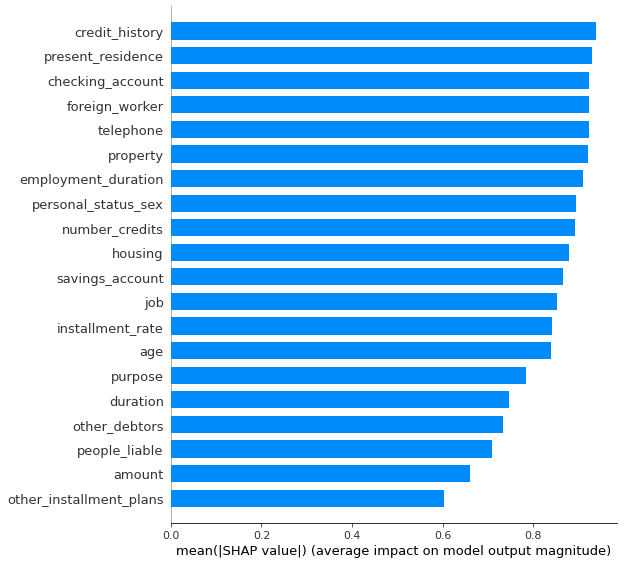

In [940]:
SVM_explainer =  shap.PermutationExplainer(SVM.predict,x)
SVM_shap_values = SVM_explainer.shap_values(x.values,npermutations=5)
shap.summary_plot(SVM_shap_values.data, x.values, plot_type="bar", feature_names = x.columns)

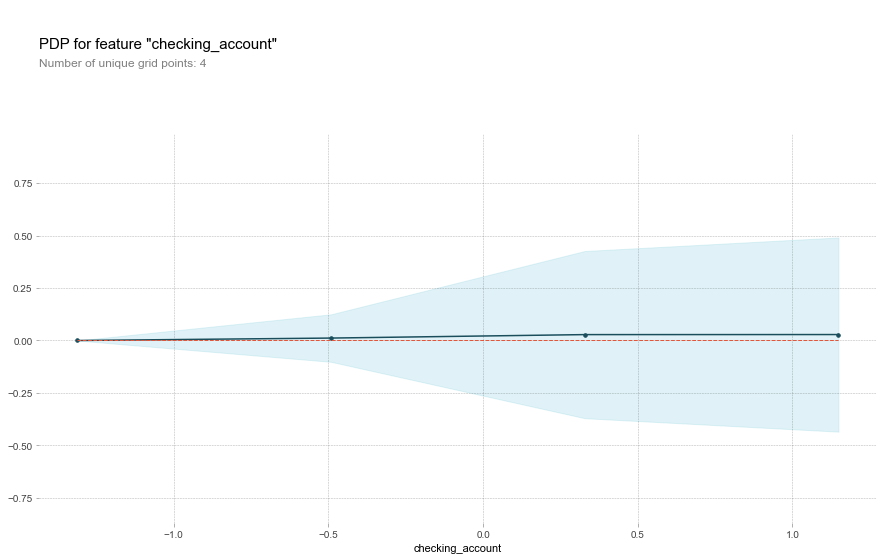

In [941]:
# Create the data that we will plot
pdp_CheckingAccount_SVM = pdp.pdp_isolate(model=SVM, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_SVM, 'checking_account')
plt.show()

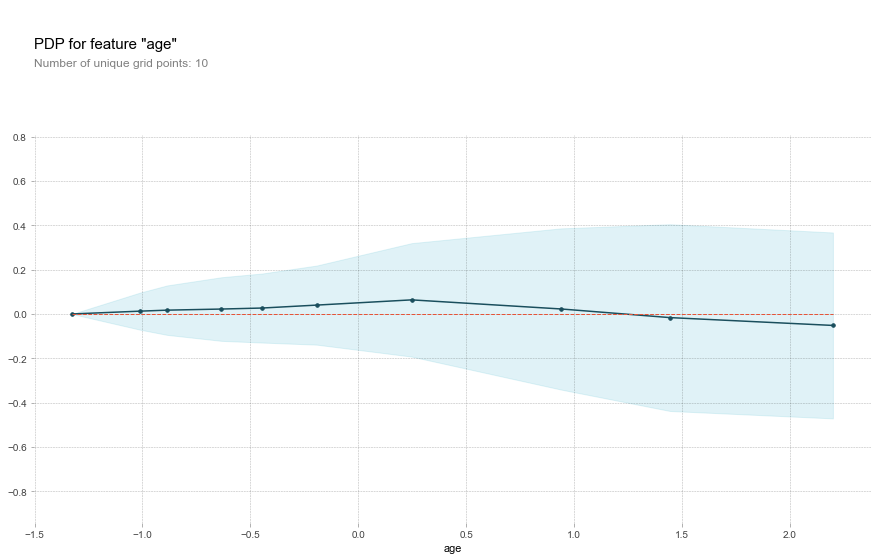

In [942]:
# Create the data that we will plot
pdp_Age_SVM = pdp.pdp_isolate(model=SVM, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_SVM, 'age')
plt.show()

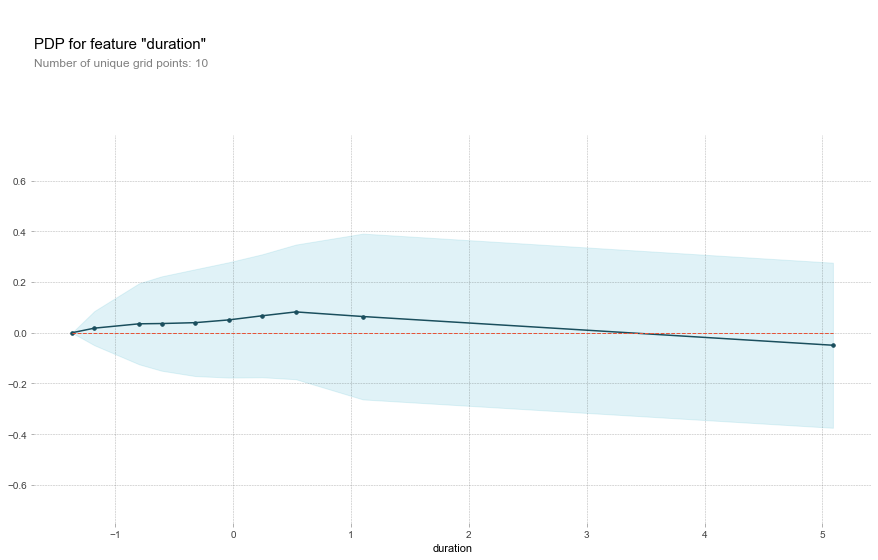

In [943]:
# Create the data that we will plot
pdp_Duration_SVM = pdp.pdp_isolate(model=SVM, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_SVM, 'duration')
plt.show()

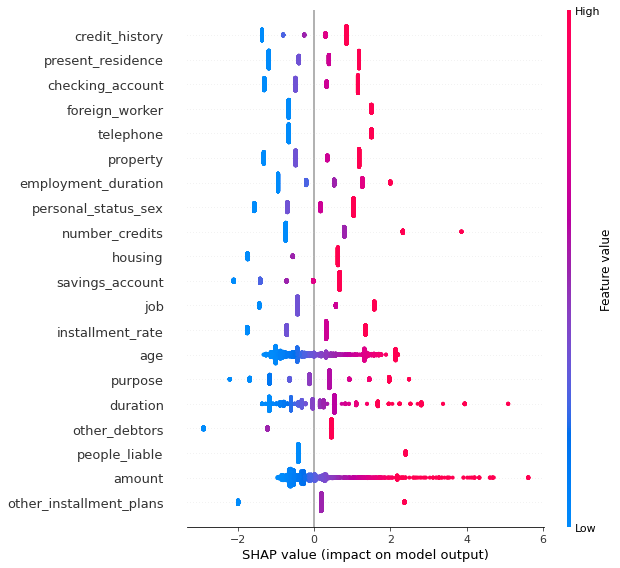

In [944]:
shap.summary_plot(SVM_shap_values.data, x)

In [945]:
SVM_shap_values.base_values

array([0.29, 0.29, 0.29, ..., 0.29, 0.29, 0.29])

In [946]:
SVM_shap_values.data

array([[ 1.1488124 ,  0.8448553 , -1.16862051, ..., -0.03853577,
        -0.34652777, -1.26342089],
       [-1.31144264,  0.8448553 ,  0.39877669, ...,  1.10089688,
        -0.30614035, -1.01163664],
       [ 1.1488124 , -1.36895486, -1.16862051, ...,  1.67061321,
         1.17800655, -1.0745827 ],
       ...,
       [ 0.32872739, -1.36895486,  0.39877669, ..., -1.17796842,
        -0.61577727,  2.13566659],
       [ 0.32872739, -1.36895486,  0.39877669, ..., -1.17796842,
        -0.61577727,  2.13566659],
       [ 0.32872739, -1.36895486,  0.39877669, ..., -1.17796842,
        -0.61577727,  2.13566659]])

Model 6 SVM Local Explainations

In [947]:
idx = 7
shap.initjs()
shap.force_plot(SVM_shap_values.base_values[idx], SVM_shap_values.data[idx], features=x_train.columns)

In [948]:
test_idx = 5
#names = xGB.get_booster().feature_names
#predict_fn_xGB(test_value)
#pd.DataFrame(x_test.values[test_idx]).T
#x_test.iloc[[test_idx]]
#pd.DataFrame(x_test.values[test_idx].reshape(1,-1)).rename(columns={0:'Age',1:'Sex',2:'Job',3:'Housing',4:'Saving accounts',5:'Checking account',6:'Credit amount',7:'Duration',8:'Purpose',9:'Job_lvl'})
predict_fn_SVM = lambda a: SVM.predict(a)
x_test.iloc[test_idx]

checking_account           1.148812
credit_history             0.844855
purpose                    0.398777
savings_account           -1.416869
employment_duration       -0.212180
installment_rate          -0.721069
personal_status_sex        1.036061
other_debtors             -2.902509
present_residence         -1.191297
property                   1.177538
other_installment_plans    0.185375
housing                    0.623639
number_credits            -0.745881
job                        1.577131
people_liable             -0.416088
telephone                 -0.665094
foreign_worker             1.502189
duration                   0.246322
amount                     0.280751
age                       -1.011637
Name: 1937, dtype: float64

In [949]:
y_pred_SVM = predict_fn_SVM(x_test)
y_pred_SVM

array([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0,
       1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1,
       0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0,
       1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0,
       0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0,
       0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
       0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1,
       0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1,

In [950]:
expSVM = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_SVM, num_features=20)

Intercept 0.0
Prediction_local [0.]
Right: 0


In [951]:
expSVM.show_in_notebook(show_table=True)

In [952]:
score_SVM, closest_class_SVM = ts.score(x_test,
                                y_pred_SVM,
                                k=2,
                                dist_type='point')

In [953]:
#score_SVM, closest_class_SVM

Model 7 : CART Descision Trees

In [1144]:
print(CART_grid_search.best_params_)

{'max_leaf_nodes': 91, 'min_samples_split': 5}


In [1145]:
CART_grid_search.best_score_

0.9010622710622711

In [1146]:
best_estimators_xai[2].best_score_

0.7421739130434782

In [1147]:
best_estimators_xai[2].best_estimator_

DecisionTreeClassifier(max_leaf_nodes=5, random_state=42)

In [1148]:
#CART = best_estimators_xai[2].best_estimator_
CART = CART_grid_search.best_estimator_
CART

DecisionTreeClassifier(max_leaf_nodes=91, min_samples_split=5, random_state=42)

Model 7 Predictive Accuracy

In [1149]:
#Testing the model 
#Predicting using our  model
y_pred_CART = CART.predict(x_test)

# Verificaar os resultados obtidos
print(accuracy_score(y_test,y_pred_CART)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_CART))
print("\n")
print(fbeta_score(y_test, y_pred_CART, beta=2))
print("\n")
print(classification_report(y_test, y_pred_CART))

88.13813813813813
 percent


[[384  34]
 [ 45 203]]


0.8258746948738814


              precision    recall  f1-score   support

           0       0.90      0.92      0.91       418
           1       0.86      0.82      0.84       248

    accuracy                           0.88       666
   macro avg       0.88      0.87      0.87       666
weighted avg       0.88      0.88      0.88       666



In [1150]:
print("Actual # : ",len(y_pred_CART)," Successfully Predicted # :",len(y_test))

Actual # :  666  Successfully Predicted # : 666


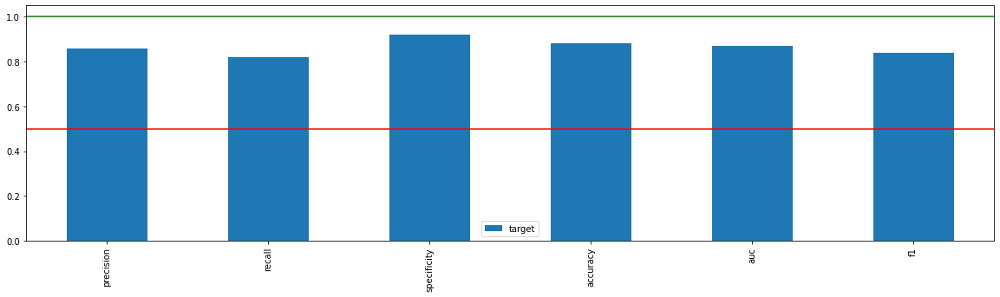

In [1151]:
_= xai.metrics_plot(y_test,y_pred_CART)

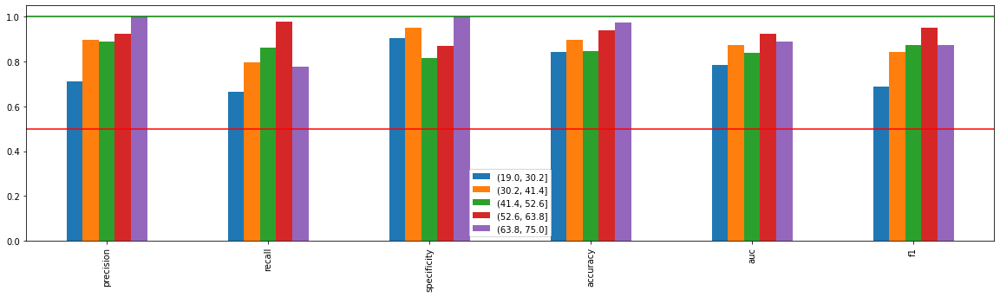

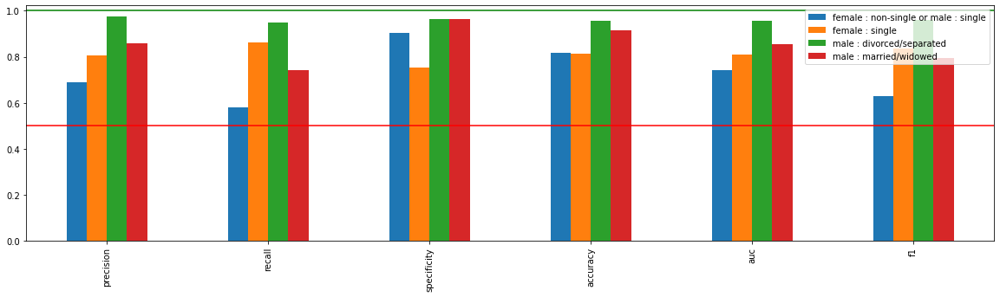

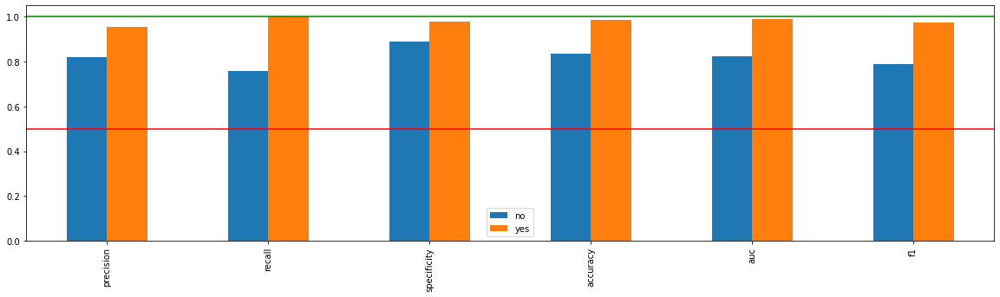

In [1152]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_CART, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Plot 1: Model performance based on Sex [Male,Female] Plot 2: Model performance based on Age [Student, Adult1, Adult2, Adult3, Senior]

Model 7 Descriptive Accuracy and Relevance

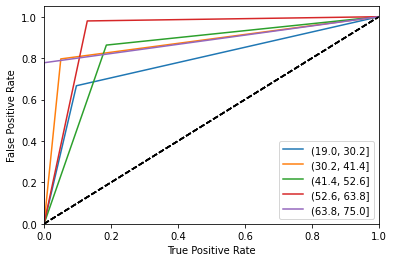

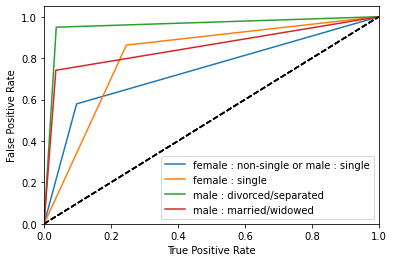

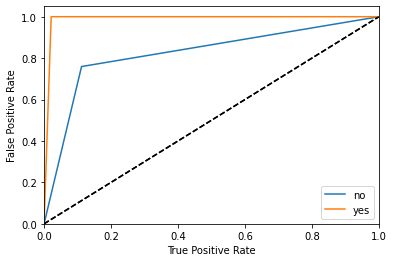

In [1153]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_CART, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Model 7 CART Feature level explainations 

In [1154]:
perm_CART = PermutationImportance(CART, random_state=seed).fit(x,y)
eli5.show_weights(perm_CART, feature_names = x.columns.tolist())

Weight,Feature
0.1992 ± 0.0086,personal_status_sex
0.1601 ± 0.0099,duration
0.0825 ± 0.0062,purpose
0.0558 ± 0.0102,property
0.0544 ± 0.0098,age
0.0466 ± 0.0043,savings_account
0.0397 ± 0.0112,amount
0.0387 ± 0.0056,employment_duration
0.0374 ± 0.0063,job
0.0357 ± 0.0085,people_liable


,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,0.020879,0.013744,0.082013,0.044499,0.037552,0.020841,0.198648,0.0,0.017086,0.055952,0.004882,0.000038,0.002629,0.036012,0.037063,0.020503,0.0,0.162448,0.035712,0.052197


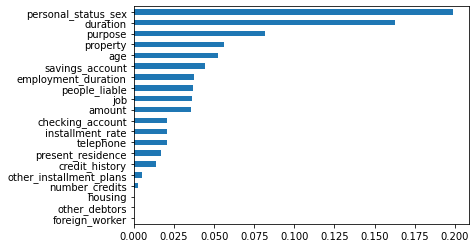

In [1155]:
def get_avg_cart(x, y):
    return accuracy_score(CART.predict(x), y)

imp1 = xai.feature_importance(x, y,get_avg_cart)
imp1.head()

Model 7 CART Global Explainations

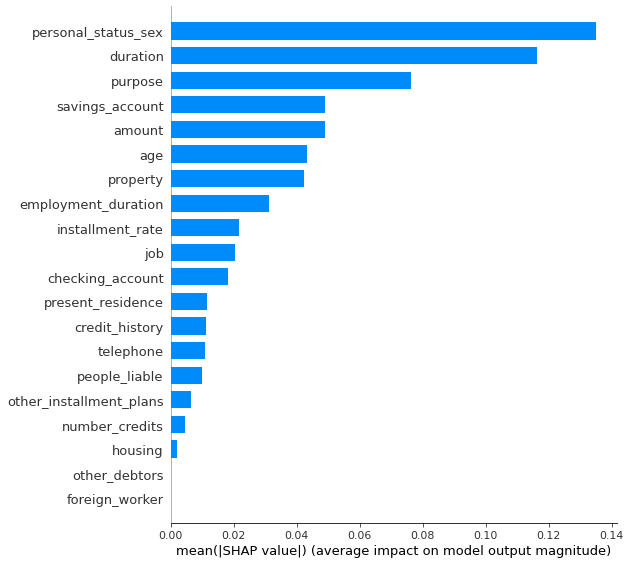

In [1156]:
CART_explainer =  shap.TreeExplainer(CART)
CART_shap_values = CART_explainer.shap_values(x)
shap.summary_plot(CART_shap_values[1], x,plot_type="bar")

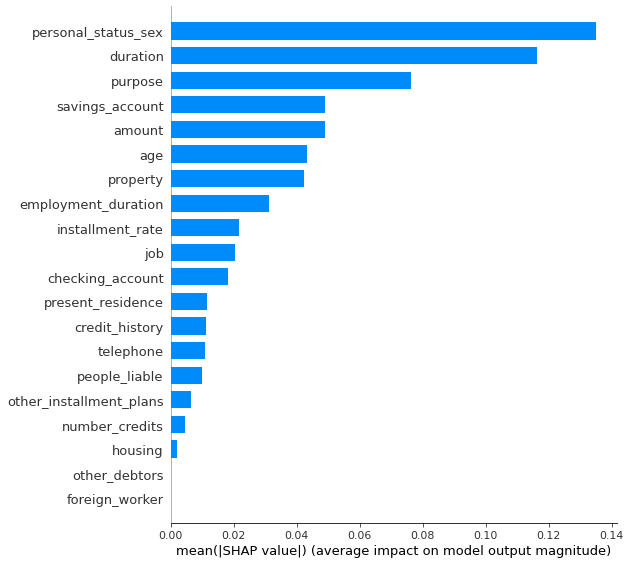

In [1157]:
CART_explainer =  shap.TreeExplainer(CART)
CART_shap_values = CART_explainer.shap_values(x)
shap.summary_plot(CART_shap_values[0], x,plot_type="bar")

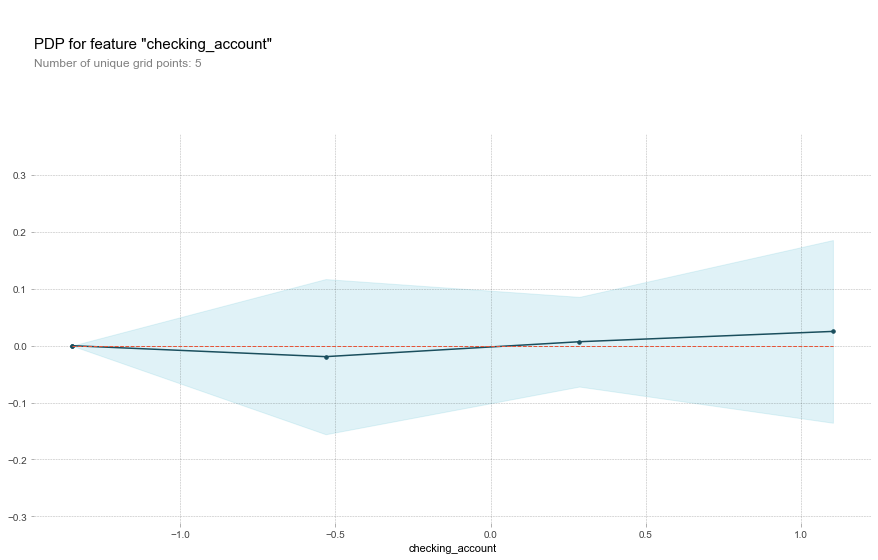

In [1158]:
# Create the data that we will plot
pdp_CheckingAccount_CART = pdp.pdp_isolate(model=CART, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_CART, 'checking_account')
plt.show()

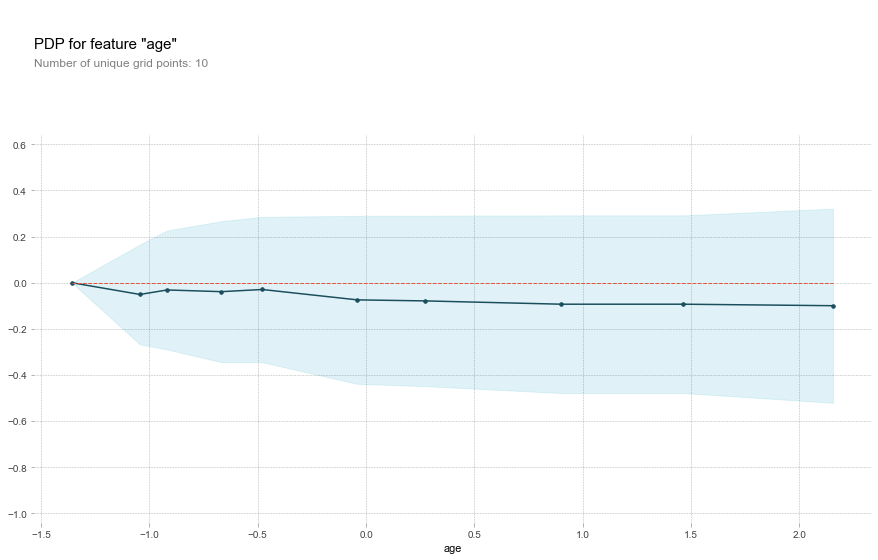

In [1159]:
# Create the data that we will plot
pdp_Age_CART = pdp.pdp_isolate(model=CART, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_CART, 'age')
plt.show()

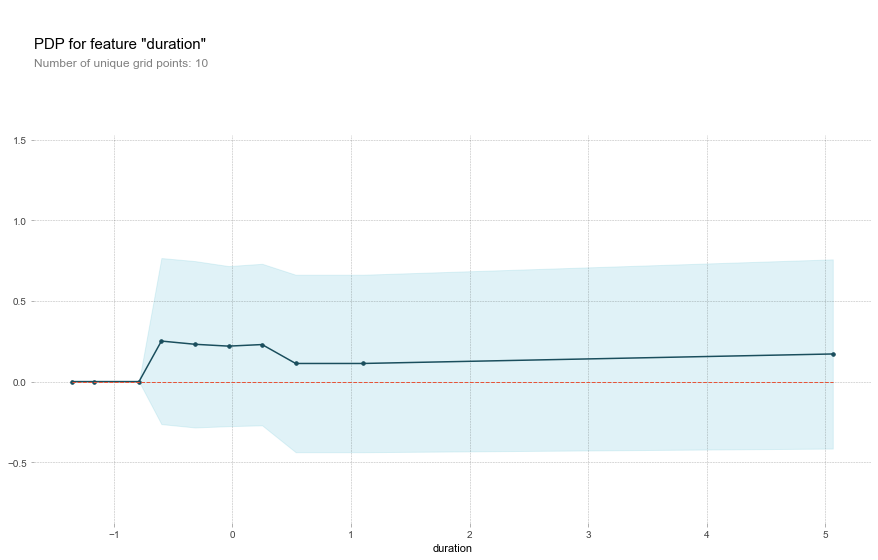

In [1160]:
# Create the data that we will plot
pdp_Duration_CART = pdp.pdp_isolate(model=CART, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_CART, 'duration')
plt.show()

In [1161]:
# Similar to previous PDP plot except we use pdp_interact instead of pdp_isolate and pdp_interact_plot instead of pdp_isolate_plot
interCART  =  pdp.pdp_interact(model=CART, dataset=x, model_features=x.columns, features=protected_cols)

#pdp.pdp_interact_plot(pdp_interact_out=interRF, feature_names=['Risk','Age'], plot_type='contour')
#plt.show()

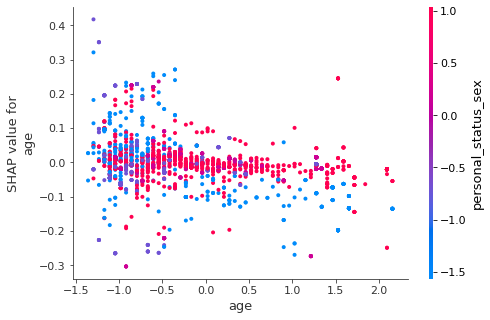

In [1162]:
# make plot.
shap.dependence_plot('age', CART_shap_values[1], x)

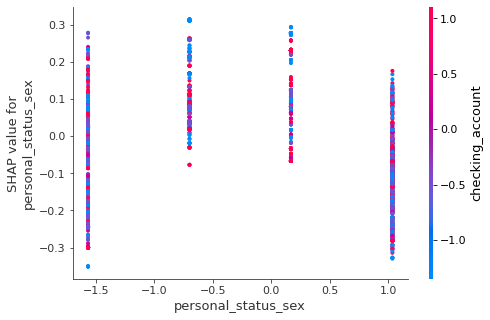

In [1163]:
# make plot.
shap.dependence_plot('personal_status_sex', CART_shap_values[1], x, interaction_index='checking_account')

Model 7 CART Local Explainations

In [1164]:
CART_explainer.expected_value

array([0.6319836, 0.3680164])

In [1165]:
CART_shap_values[0]

array([[-0.00488722, -0.00225134, -0.01674156, ...,  0.2761628 ,
        -0.0016646 ,  0.02737449],
       [-0.03302845,  0.00249157, -0.03263906, ..., -0.05848646,
         0.05431742, -0.00678358],
       [-0.15751041, -0.00277874, -0.11114057, ..., -0.20978892,
         0.01606247, -0.14141319],
       ...,
       [ 0.00232483,  0.00458963, -0.00324934, ...,  0.26375463,
        -0.01177886,  0.02013072],
       [ 0.00232483,  0.00458963, -0.00324934, ...,  0.26375463,
        -0.01177886,  0.02013072],
       [ 0.00232483,  0.00458963, -0.00324934, ...,  0.26375463,
        -0.01177886,  0.02013072]])

In [1166]:
CART_shap_values[1]

array([[ 0.00488722,  0.00225134,  0.01674156, ..., -0.2761628 ,
         0.0016646 , -0.02737449],
       [ 0.03302845, -0.00249157,  0.03263906, ...,  0.05848646,
        -0.05431742,  0.00678358],
       [ 0.15751041,  0.00277874,  0.11114057, ...,  0.20978892,
        -0.01606247,  0.14141319],
       ...,
       [-0.00232483, -0.00458963,  0.00324934, ..., -0.26375463,
         0.01177886, -0.02013072],
       [-0.00232483, -0.00458963,  0.00324934, ..., -0.26375463,
         0.01177886, -0.02013072],
       [-0.00232483, -0.00458963,  0.00324934, ..., -0.26375463,
         0.01177886, -0.02013072]])

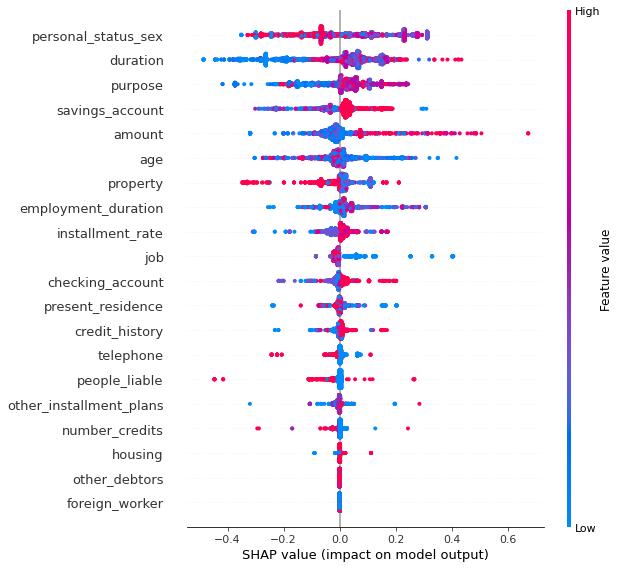

In [1167]:
shap.summary_plot(CART_shap_values[1], x)

In [1168]:
idx = 7
shap.initjs()
shap.force_plot(CART_explainer.expected_value[0], CART_shap_values[0][idx], features=x.columns)

In [1169]:
shap.force_plot(CART_explainer.expected_value[1], CART_shap_values[1][idx], features=x.columns)

In [1170]:
test_idx = 5
predict_fn_CART = lambda a: CART.predict(a)
x_test.iloc[test_idx]

checking_account          -1.348383
credit_history            -1.361267
purpose                    0.414543
savings_account            0.646014
employment_duration        0.477033
installment_rate           0.273180
personal_status_sex        0.169183
other_debtors              0.412414
present_residence          1.069233
property                  -1.244741
other_installment_plans    0.117414
housing                    0.607098
number_credits             0.839309
job                       -0.377410
people_liable             -0.421660
telephone                 -0.701339
foreign_worker            -0.658812
duration                   1.666230
amount                    -0.132708
age                       -0.855497
Name: 650, dtype: float64

In [1171]:
y_pred_CART = predict_fn_CART(x_test)
#y_pred_RF

In [1172]:
expCART = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_CART,num_features=20)

Intercept 0.2596439800981606
Prediction_local [0.29028945]
Right: 1


In [1173]:
expCART.show_in_notebook(show_table=True)

In [1174]:
scoreCART, closest_classCART = ts.score(x_test,
                                y_pred_CART,
                                k=2,
                                dist_type='point')

In [1175]:
#scoreCART, closest_classCART

Model 8 Logistic Regression

In [986]:
LR_grid_search.best_score_

0.7595970695970695

In [987]:
LR_grid_search.best_params_

{'logistic_Reg__C': 0.5689866029018293,
 'logistic_Reg__penalty': 'l2',
 'pca__n_components': 20,
 'std_slc': StandardScaler()}

In [988]:
best_estimators_xai[7].best_score_

0.6230434782608696

In [989]:
best_estimators_xai[7].best_estimator_

Pipeline(steps=[('std_slc', StandardScaler()), ('pca', PCA(n_components=2)),
                ('logistic_Reg', LogisticRegression(C=0.019306977288832496))])

In [1176]:
#LR = best_estimators_xai[7].best_estimator_
LR = LR_grid_search.best_estimator_
LR

Pipeline(steps=[('std_slc', StandardScaler()), ('pca', PCA(n_components=20)),
                ('logistic_Reg', LogisticRegression(C=0.5689866029018293))])

In [991]:
# Printing the Training Score
print("Training score data: ")
print(LR.score(x_train, y_train))

Training score data: 
0.6345463864684777


In [992]:
y_pred_LR = LR.predict(x_test)

print(accuracy_score(y_test,y_pred_LR)*100)
print(" percent")
print("\n")
print(confusion_matrix(y_test, y_pred_LR))
print("\n")
print(classification_report(y_test, y_pred_LR))

61.597542242703526
 percent


[[340  63]
 [187  61]]


              precision    recall  f1-score   support

           0       0.65      0.84      0.73       403
           1       0.49      0.25      0.33       248

    accuracy                           0.62       651
   macro avg       0.57      0.54      0.53       651
weighted avg       0.59      0.62      0.58       651



In [993]:
print("Actual # : ",len(y_pred_LR)," Successfully Predicted # :",len(y_test))

Actual # :  651  Successfully Predicted # : 651


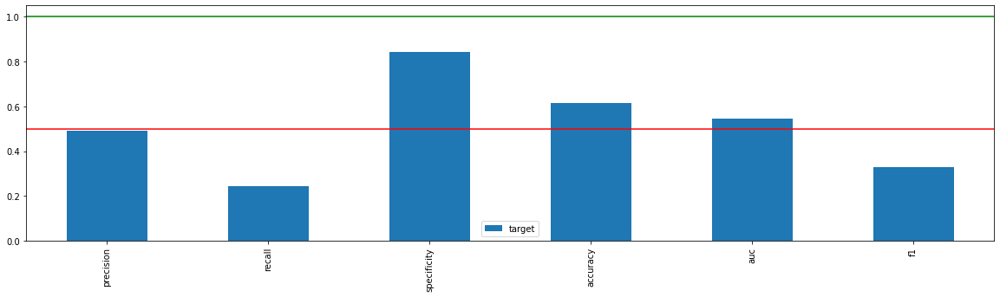

In [994]:
_= xai.metrics_plot(y_test,y_pred_LR)

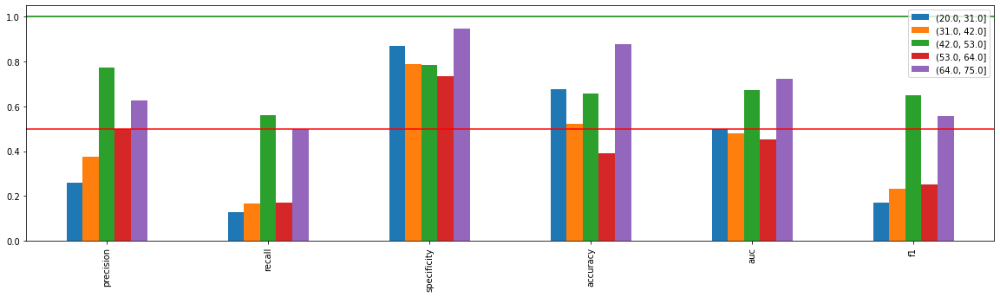

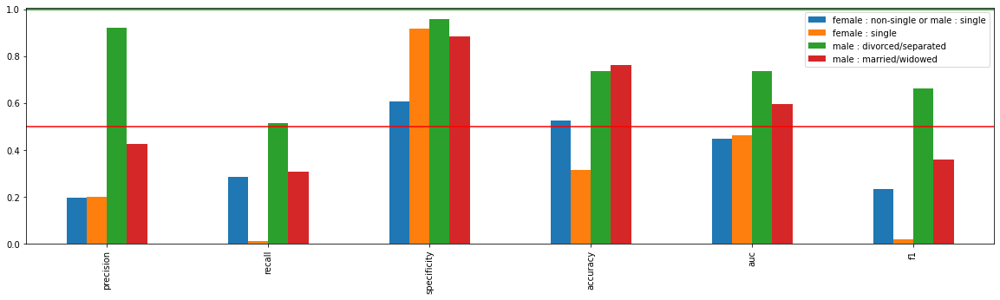

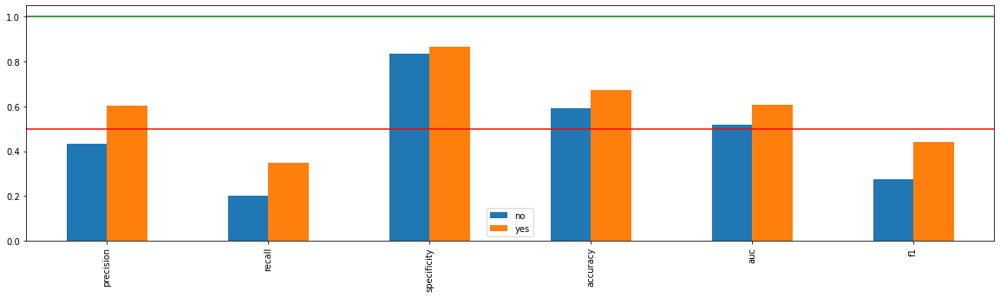

In [995]:
_ = [xai.metrics_plot(
    y_test, 
    y_pred_LR, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

Plot 1: Model performance based on Sex [Male,Female]  Plot 2: Model performance based on Age [Student, Adult1, Adult2, Adult3, Senior]

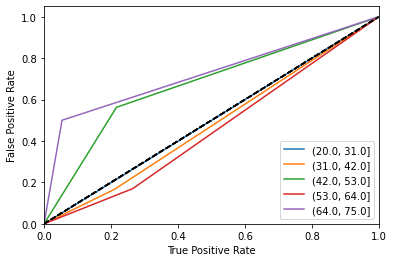

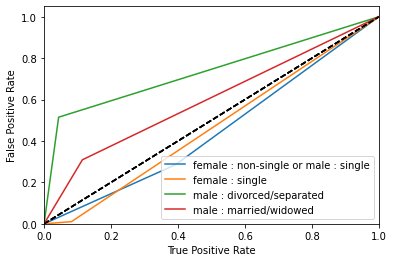

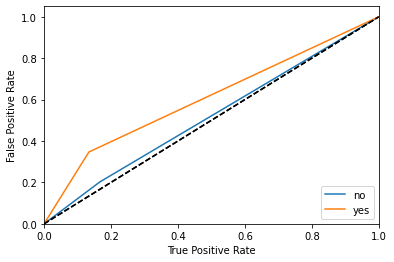

In [996]:
_ = [xai.roc_plot(
    y_test, 
    y_pred_LR, 
    df=x_test_display, 
    cross_cols=[p],
    categorical_cols=categorical_cols) for p in protected_cols]

In [997]:
#d2 = xai.smile_imbalance(y_test,y_pred_gnb,threshold=0.75,display_breakdown=True)

In [998]:
#d2 = xai.smile_imbalance(
#    y_test, 
#    y_pred_gnb,
#    bins=1,
#    threshold=0.75,
#    manual_review=0.00001,
#    display_breakdown=True)

In [999]:
perm_LR = PermutationImportance(LR, random_state=seed).fit(x,y)
eli5.show_weights(perm_LR, feature_names = x.columns.tolist())

Weight,Feature
0.0128 ± 0.0033,duration
0.0075 ± 0.0054,amount
0.0074 ± 0.0038,credit_history
0.0061 ± 0.0006,number_credits
0.0045 ± 0.0012,checking_account
0.0033 ± 0.0017,job
0.0032 ± 0.0027,savings_account
0.0020 ± 0.0030,employment_duration
0.0010 ± 0.0061,other_installment_plans
0.0010 ± 0.0006,foreign_worker


,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
0,0.004266,0.007379,-0.002114,0.003113,0.003344,-0.001537,-0.004881,-0.004304,-0.011376,-0.009108,0.001384,0.000538,0.005419,0.001422,0.000576,-0.009493,0.00196,0.009992,0.009454,-0.00761


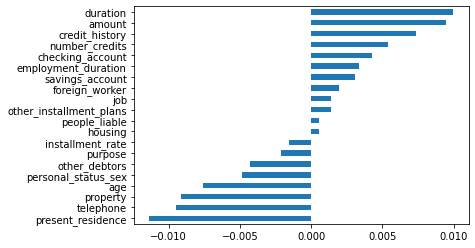

In [1000]:
def get_avg_lr(x, y):
    return accuracy_score(np.array([1 if a >= 0.5 else 0 for a in LR.predict(x)]), y)

#Shapley values - showing importance of features for this model.
imp2 = xai.feature_importance(x, y, get_avg_lr)
imp2.head()

Model 8 LR Global Explainations

Permutation explainer: 2603it [00:48, 56.35it/s]                                                                                                                                                                                                                           


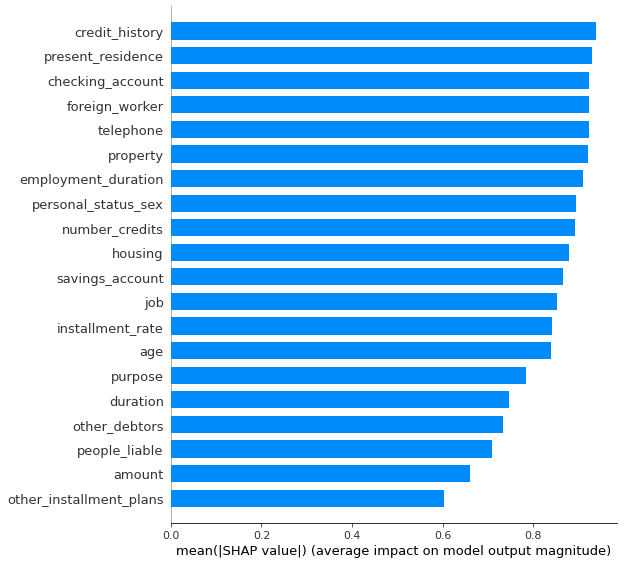

In [1001]:
LR_explainer =  shap.PermutationExplainer(LR.predict,x)
LR_shap_values = LR_explainer.shap_values(x.values,npermutations=5)
shap.summary_plot(LR_shap_values.data, x.values, plot_type="bar", feature_names = x.columns)

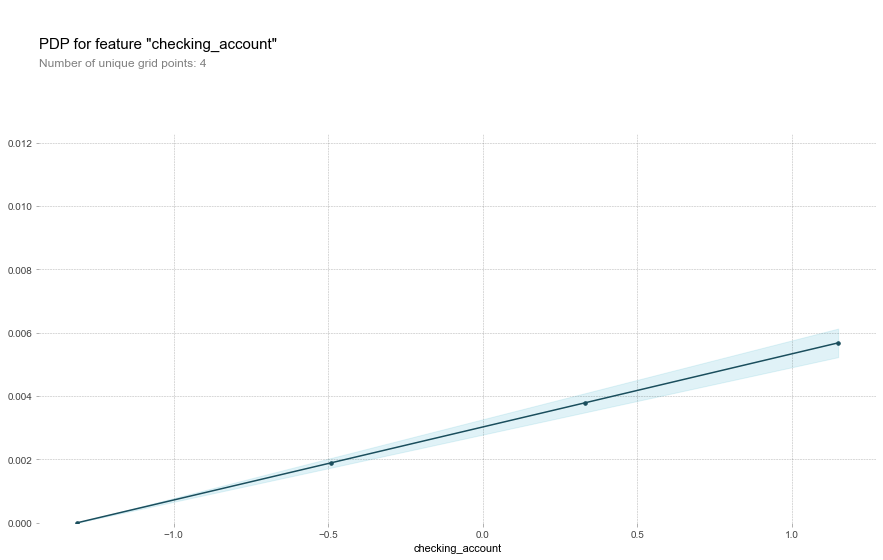

In [1002]:
# Create the data that we will plot
pdp_CheckingAccount_LR = pdp.pdp_isolate(model=LR, dataset=x, model_features=x.columns, feature='checking_account')

# plot it
pdp.pdp_plot(pdp_CheckingAccount_LR, 'checking_account')
plt.show()

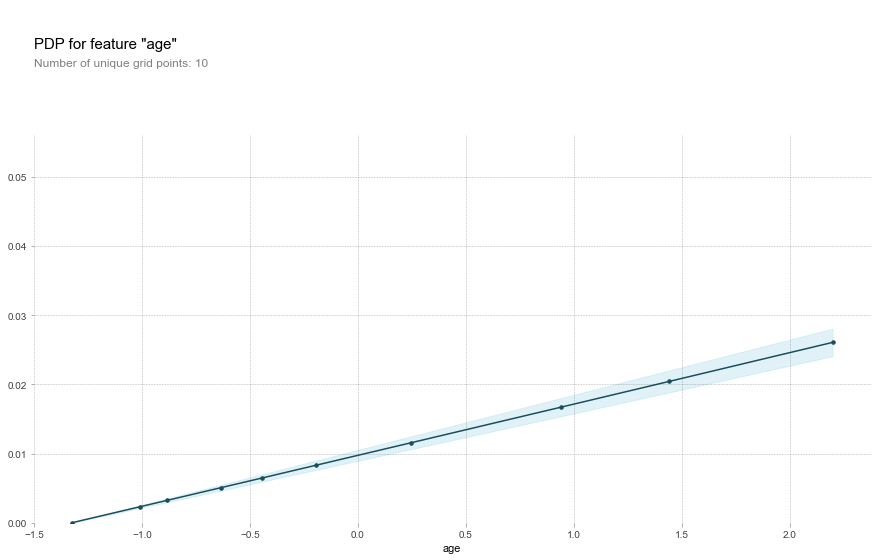

In [1003]:
# Create the data that we will plot
pdp_Age_LR = pdp.pdp_isolate(model=LR, dataset=x, model_features=x.columns, feature='age')

# plot it
pdp.pdp_plot(pdp_Age_LR, 'age')
plt.show()

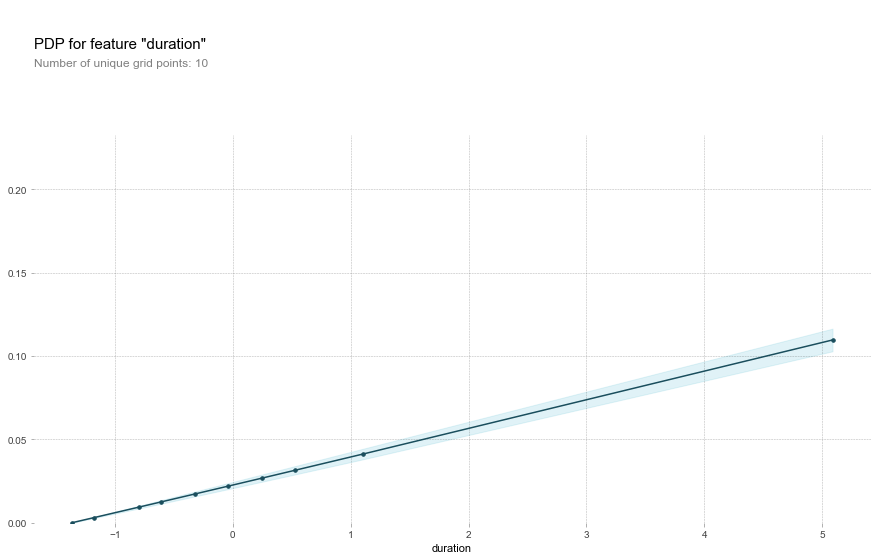

In [1004]:
# Create the data that we will plot
pdp_Duration_LR = pdp.pdp_isolate(model=LR, dataset=x, model_features=x.columns, feature='duration')

# plot it
pdp.pdp_plot(pdp_Duration_LR, 'duration')
plt.show()

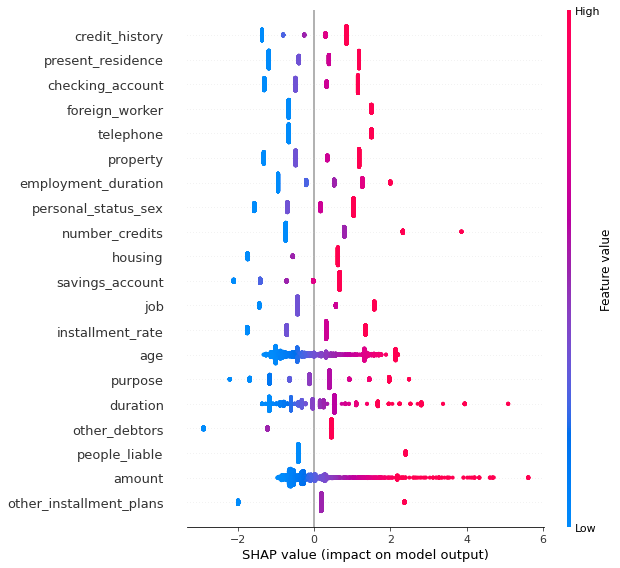

In [1005]:
shap.summary_plot(LR_shap_values.data, x)

In [1006]:
LR_shap_values.base_values

array([0.23, 0.23, 0.23, ..., 0.23, 0.23, 0.23])

In [1007]:
LR_shap_values.data

array([[ 1.1488124 ,  0.8448553 , -1.16862051, ..., -0.03853577,
        -0.34652777, -1.26342089],
       [-1.31144264,  0.8448553 ,  0.39877669, ...,  1.10089688,
        -0.30614035, -1.01163664],
       [ 1.1488124 , -1.36895486, -1.16862051, ...,  1.67061321,
         1.17800655, -1.0745827 ],
       ...,
       [ 0.32872739, -1.36895486,  0.39877669, ..., -1.17796842,
        -0.61577727,  2.13566659],
       [ 0.32872739, -1.36895486,  0.39877669, ..., -1.17796842,
        -0.61577727,  2.13566659],
       [ 0.32872739, -1.36895486,  0.39877669, ..., -1.17796842,
        -0.61577727,  2.13566659]])

Model 8 LR Local Explainations

In [1008]:
idx = 7
shap.initjs()
shap.force_plot(LR_shap_values.base_values[idx], LR_shap_values.data[idx], features=x_train.columns)

In [1009]:
test_idx = 5
#names = xGB.get_booster().feature_names
#predict_fn_xGB(test_value)
#pd.DataFrame(x_test.values[test_idx]).T
#x_test.iloc[[test_idx]]
#pd.DataFrame(x_test.values[test_idx].reshape(1,-1)).rename(columns={0:'Age',1:'Sex',2:'Job',3:'Housing',4:'Saving accounts',5:'Checking account',6:'Credit amount',7:'Duration',8:'Purpose',9:'Job_lvl'})
predict_fn_LR = lambda a: LR.predict(a)
x_test.iloc[test_idx]

checking_account           1.148812
credit_history             0.844855
purpose                    0.398777
savings_account           -1.416869
employment_duration       -0.212180
installment_rate          -0.721069
personal_status_sex        1.036061
other_debtors             -2.902509
present_residence         -1.191297
property                   1.177538
other_installment_plans    0.185375
housing                    0.623639
number_credits            -0.745881
job                        1.577131
people_liable             -0.416088
telephone                 -0.665094
foreign_worker             1.502189
duration                   0.246322
amount                     0.280751
age                       -1.011637
Name: 1937, dtype: float64

In [1010]:
y_pred_LR = predict_fn_LR(x_test)
y_pred_LR

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0,
       1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1,
       0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0,
       1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0,
       1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0,

In [1011]:
expLR = limeExplainer.explain_instance(x_test.values[test_idx], predict_fn_LR, num_features=20)

Intercept 0.32763534914264425
Prediction_local [-0.04765806]
Right: 0


In [1012]:
expLR.show_in_notebook(show_table=True)

In [1013]:
score_LR, closest_class_LR = ts.score(x_test,
                                y_pred_LR,
                                k=2,
                                dist_type='point')

In [1014]:
#score_LR, closest_class_LR

Trust Scores for models

In [1015]:
def run_RF(X_train, y_train, X_test):
    y_pred = RF.predict(X_test)
    y_pred_proba = RF.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred, probas
def run_GNB(X_train, y_train, X_test):
    y_pred = GNB.predict(X_test)
    y_pred_proba = GNB.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred,probas
def run_xGB(X_train, y_train, X_test):
    y_pred_proba =  np.array([a[1] for a in xGB.predict_proba(X_test)])
    y_pred = np.array([1 if a > 0.5 else 0 for a in y_pred_proba]).astype('int8')
    return y_pred,y_pred_proba
def run_KNN(X_train, y_train, X_test):
    y_pred = KNN.predict(X_test)
    y_pred_proba = KNN.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred,probas
def run_LDA(X_train, y_train, X_test):
    y_pred = LDA.predict(X_test)
    y_pred_proba = LDA.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred,probas
def run_SVM(X_train, y_train, X_test):
    y_pred = SVM.predict(X_test)
    y_pred_proba = SVM.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred,probas
def run_CART(X_train, y_train, X_test):
    y_pred = CART.predict(X_test)
    y_pred_proba = CART.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred, probas
def run_LR(X_train, y_train, X_test):
    y_pred = LR.predict(X_test)
    y_pred_proba = LR.predict_proba(X_test)
    probas = y_pred_proba[range(len(y_pred)), y_pred]  # probabilities of predicted class
    return y_pred, probas

In [1016]:
run_RF(x_train,y_train,x_test)

(array([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0,
        1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
        0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1,
        1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1,
        0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0,
        1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0,
        0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0,
        0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0,
        1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0,
        0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1,
        0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
        0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1,
        0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 

In [1017]:
run_xGB(x_train,y_train,x_test)

(array([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1,
        1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
        0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1,
        0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1,
        0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0,
        1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0,
        0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0,
        0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0,
        1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0,
        0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1,
        0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
        0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1,
        1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 

In [1018]:
run_GNB(x_train,y_train,x_test)

(array([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0,
        1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1,
        0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1,
        0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1,
        0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0,
        1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0,
        0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0,
        0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0,
        1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0,
        0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0,
        0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
        0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1,
        1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 

In [1019]:
run_KNN(x_train,y_train,x_test)

(array([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1,
        1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
        0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1,
        1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1,
        0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0,
        1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0,
        0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0,
        0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0,
        1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0,
        0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1,
        0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
        0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1,
        0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 

In [1020]:
run_LDA(x_train,y_train,x_test)

(array([0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0,
        1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1,
        0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1,
        0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1,
        0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0,
        1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0,
        0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0,
        0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0,
        0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0,
        1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0,
        0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1,
        0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1,
        1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 

In [1021]:
run_SVM(x_train,y_train,x_test)

(array([0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0,
        1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
        0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1,
        0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1,
        0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0,
        1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0,
        0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0,
        0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0,
        1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0,
        0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1,
        0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
        0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1,
        0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 

In [1022]:
run_CART(x_train,y_train,x_test)

(array([0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0,
        1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0,
        0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1,
        0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1,
        0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1,
        0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1,
        0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0,
        1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0,
        0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0,
        1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0,
        1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1,
        0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0,
        0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1,
        1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 

In [1023]:
run_LR(x_train,y_train,x_test)

(array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
        0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0,
        0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0,
        1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1,
        0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0,
        1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0,
        0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0,
        0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0,
        1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 

In [1024]:
def plot_precision_curve(plot_title,
                         percentiles,
                         labels,
                         final_tp,
                         final_stderr,
                         final_misclassification,
                         colors = ['blue', 'darkorange', 'brown', 'red', 'purple']):

    plt.title(plot_title, fontsize=18)
    colors = colors + list(cm.rainbow(np.linspace(0, 1, len(final_tp))))
    plt.xlabel("Percentile", fontsize=14)
    plt.ylabel("Precision", fontsize=14)

    for i, label in enumerate(labels):
        ls = "--" if ("Model" in label) else "-"
        plt.plot(percentiles, final_tp[i], ls, c=colors[i], label=label)
        plt.fill_between(percentiles,
                         final_tp[i] - final_stderr[i],
                         final_tp[i] + final_stderr[i],
                         color=colors[i],
                         alpha=.1)

    if 0. in percentiles:
        plt.legend(loc="lower right", fontsize=14)
    else:
        plt.legend(loc="upper left", fontsize=14)
    model_acc = 100 * (1 - final_misclassification)
    plt.axvline(x=model_acc, linestyle="dotted", color="black")
    plt.show()

In [1025]:
def run_precision_plt(X, y, nfolds, percentiles, run_model, test_size=.5,
                      plt_title="", plt_names=[], predict_correct=True, classes=2):

    def stderr(L):
        return np.std(L) / np.sqrt(len(L))

    all_tp = [[[] for p in percentiles] for _ in plt_names]
    misclassifications = []
    mult = 1 if predict_correct else -1

    folds = StratifiedShuffleSplit(n_splits=nfolds, test_size=test_size, random_state=0)
    for tn_idx, tst_idx in folds.split(X, y):
        #create train and test folds, train model and make predictions
        X_train, y_train = X[tn_idx, :], y[tn_idx]
        X_test, y_test = X[tst_idx, :], y[tst_idx]
        
        y_pred, probas = run_model(X_train, y_train, X_test)
        # target points are the correctly classified points
        target_points = np.where(y_pred == y_test)[0] if predict_correct else np.where(y_pred != y_test)[0]
        final_curves = [probas]
        #calculate trust scores
        ts = TrustScore()
        ts.fit(X_train, y_train, classes=classes)
        scores, _ = ts.score(X_test, y_pred, k=2, dist_type='point')
        final_curves.append(scores)  # contains prediction probabilities and trust scores
        # check where prediction probabilities and trust scores are above a certain percentage level
        for p, perc in enumerate(percentiles):
            high_proba = [np.where(mult * curve >= np.percentile(mult * curve, perc))[0] for curve in final_curves]
            if 0 in map(len, high_proba):
                continue
            # calculate fraction of values above percentage level that are correctly (or incorrectly) classified
            tp = [len(np.intersect1d(hp, target_points)) / (1. * len(hp)) for hp in high_proba]
            for i in range(len(plt_names)):
                all_tp[i][p].append(tp[i])  # for each percentile, store fraction of values above cutoff value
        misclassifications.append(len(target_points) / (1. * len(X_test)))

    # average over folds for each percentile
    final_tp = [[] for _ in plt_names]
    final_stderr = [[] for _ in plt_names]
    for p, perc in enumerate(percentiles):
        for i in range(len(plt_names)):
            final_tp[i].append(np.mean(all_tp[i][p]))
            final_stderr[i].append(stderr(all_tp[i][p]))

    for i in range(len(all_tp)):
        final_tp[i] = np.array(final_tp[i])
        final_stderr[i] = np.array(final_stderr[i])

    final_misclassification = np.mean(misclassifications)
    #print(final_misclassification)
    # create plot
    plot_precision_curve(plt_title, percentiles, plt_names, final_tp, final_stderr, final_misclassification)

In [1026]:
from sklearn.model_selection import StratifiedShuffleSplit
import matplotlib.cm as cm

In [1027]:
percentiles = [0 + 0.5 * i for i in range(0,200)]
plt_names = ['Model Confidence', 'Trust Score']
nfolds = 10

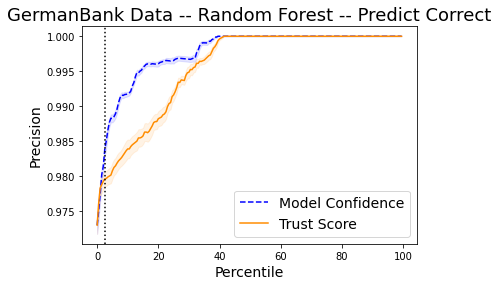

In [1028]:
plt_title = 'GermanBank Data -- Random Forest -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_RF, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

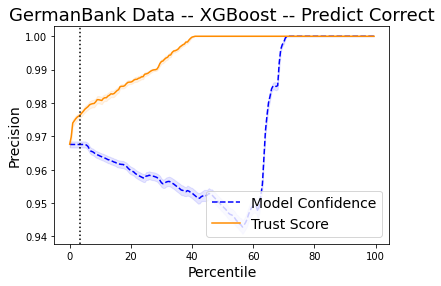

In [1029]:
plt_title = 'GermanBank Data -- XGBoost -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_xGB, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

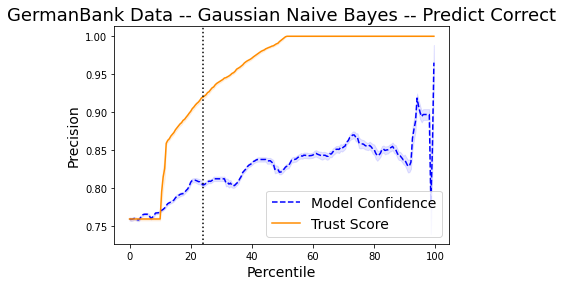

In [1030]:
plt_title = 'GermanBank Data -- Gaussian Naive Bayes -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_GNB, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

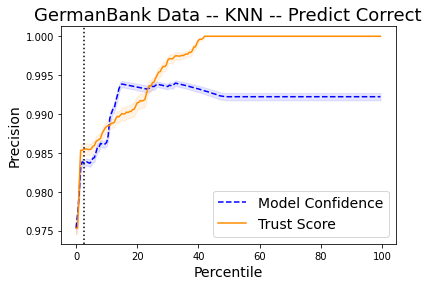

In [1031]:
plt_title = 'GermanBank Data -- KNN -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_KNN, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

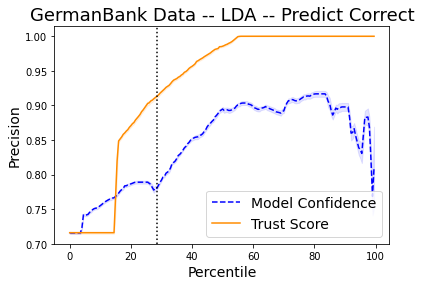

In [1032]:
plt_title = 'GermanBank Data -- LDA -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_LDA, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

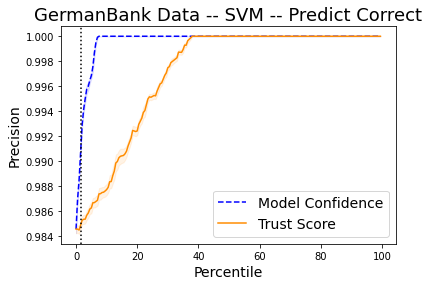

In [1033]:
plt_title = 'GermanBank Data -- SVM -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_SVM, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

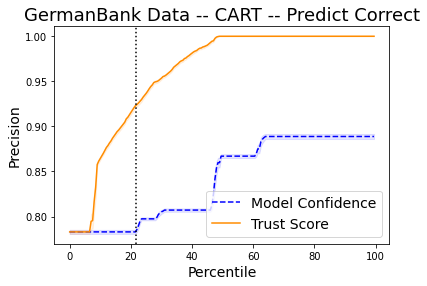

In [1034]:
plt_title = 'GermanBank Data -- CART -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_CART, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

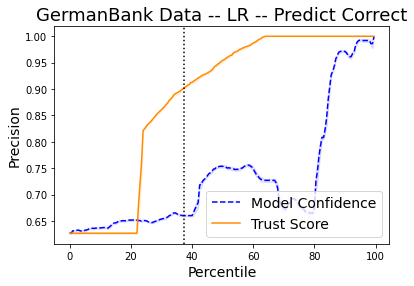

In [1035]:
plt_title = 'GermanBank Data -- LR -- Predict Correct'
run_precision_plt(x.values, y, nfolds, percentiles, run_LR, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=True)

Trust score for Incorrect values.

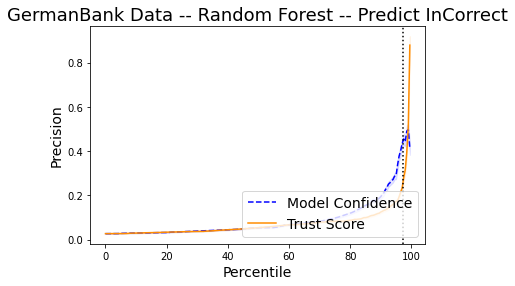

In [1036]:
plt_title = 'GermanBank Data -- Random Forest -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_RF, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

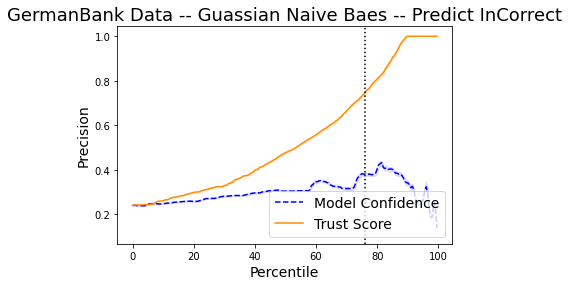

In [1037]:
plt_title = 'GermanBank Data -- Guassian Naive Baes -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_GNB, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

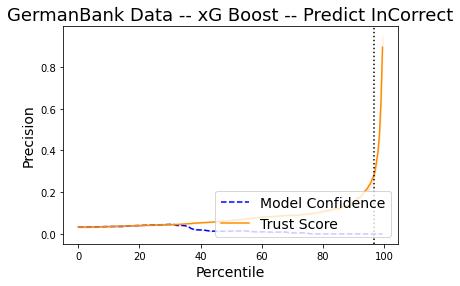

In [1038]:
plt_title = 'GermanBank Data -- xG Boost -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_xGB, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

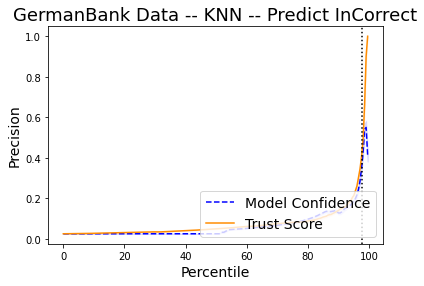

In [1039]:
plt_title = 'GermanBank Data -- KNN -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_KNN, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

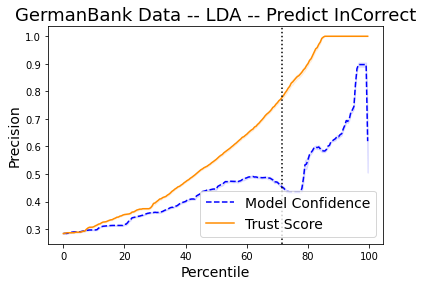

In [1040]:
plt_title = 'GermanBank Data -- LDA -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_LDA, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

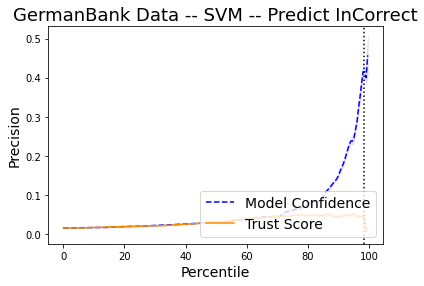

In [1041]:
plt_title = 'GermanBank Data -- SVM -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_SVM, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

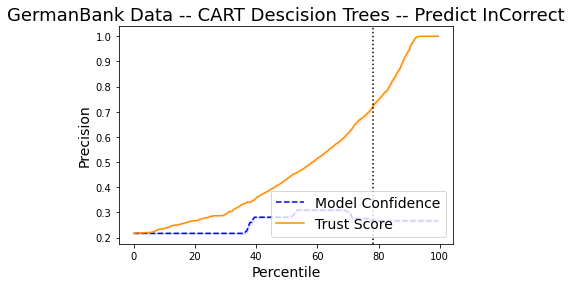

In [1042]:
plt_title = 'GermanBank Data -- CART Descision Trees -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_CART, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

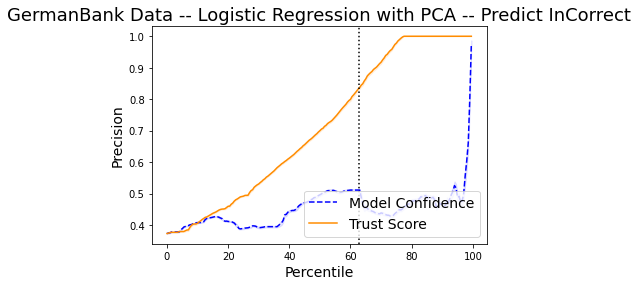

In [1043]:
plt_title = 'GermanBank Data -- Logistic Regression with PCA -- Predict InCorrect'
run_precision_plt(x.values, y, nfolds, percentiles, run_LR, plt_title=plt_title,
                  plt_names=plt_names, predict_correct=False)

In [1044]:
from explainerdashboard import ExplainerDashboard, ClassifierExplainer, RegressionExplainer

In [1045]:
import scipy as sp
from iml.datatypes import DenseData
def _summarize_data(X, k=30, to_round_values=True):
    """Summarize a dataset.

    For dense dataset, use k mean samples weighted by the number of data points they
    each represent.
    For sparse dataset, use a sparse row for the background with calculated
    median for dense columns.

    :param X: Matrix of data samples to summarize (# samples x # features).
    :type X: numpy.array or pandas.DataFrame or scipy.sparse.csr_matrix
    :param k: Number of cluster centroids to use for approximation.
    :type k: int
    :param to_round_values: When using kmeans, for each element of every cluster centroid to match the nearest value
        from X in the corresponding dimension. This ensures discrete features
        always get a valid value.  Ignored for sparse data sample.
    :type to_round_values: bool
    :return: DenseData or SparseData object.
    :rtype: iml.datatypes.DenseData or iml.datatypes.SparseData
    """
    is_sparse = sp.sparse.issparse(X)
    if not isinstance(X, DenseData):
        if is_sparse:
            #module_logger.debug('Creating sparse data summary as csr matrix')
            # calculate median of sparse background data
            median_dense = csc_median_axis_0(X.tocsc())
            return sp.sparse.csr_matrix(median_dense)
        elif len(X) > 10 * k:
            #module_logger.debug('Create dense data summary with k-means')
            # use kmeans to summarize the examples for initialization
            # if there are more than 10 x k of them
            return shap.kmeans(X, k, to_round_values)
    return X

In [1046]:
data_df = x.copy(deep=True)
data_df['credit_risk'] = y
#_summarize_data(data).group_names
#_summarize_data(data).data
dta = _summarize_data(data_df)
x_k_means = pd.DataFrame(data=dta.data[:,0:20], columns =dta.group_names.tolist()[0:20])#, columns=_summarize_data(x_dash).group_names.tolist()[0:20])
y_k_means = pd.Series(dta.data[:,20])
x_k_means.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30 entries, 0 to 29
Data columns (total 20 columns):
checking_account           30 non-null float64
credit_history             30 non-null float64
purpose                    30 non-null float64
savings_account            30 non-null float64
employment_duration        30 non-null float64
installment_rate           30 non-null float64
personal_status_sex        30 non-null float64
other_debtors              30 non-null float64
present_residence          30 non-null float64
property                   30 non-null float64
other_installment_plans    30 non-null float64
housing                    30 non-null float64
number_credits             30 non-null float64
job                        30 non-null float64
people_liable              30 non-null float64
telephone                  30 non-null float64
foreign_worker             30 non-null float64
duration                   30 non-null float64
amount                     30 non-null float64
age 

In [1047]:
y_k_means.name = 'credit_risk'
y_k_means = y_k_means.astype('int64')

# Explainer Dashboard with Shap

In [1048]:
labels=['Good', 'Bad']

In [1049]:
db_RF = ExplainerDashboard(ClassifierExplainer(RF, x_test, y_test, labels=labels),title="Explainer for - Random Forest for credit risk model",
                    whatif=True, # you can switch off tabs with bools
                    shap_interaction=True)

Note: shap=='guess' so guessing for RandomForestClassifier shap='tree'...
Detected RandomForestClassifier model: Changing class type to RandomForestClassifierExplainer...
Note: model_output=='probability', so assuming that raw shap output of RandomForestClassifier is in probability space...
Generating self.shap_explainer = shap.TreeExplainer(model)
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
Generating layout...
Calculating shap values...
Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating categorical permutation importances (if slow, try setting n_jobs parameter)...
Calculating pred_percentiles...
Calculating prediction probabilities...
Calculating predictions...
Calculating shap interaction values...
Reminder: TreeShap computational complexity is O(TLD^2), where T is 

In [1050]:
#ClassifierExplainer(GNB,x_test,y_test,shap='permut')
db_GNB = ExplainerDashboard(ClassifierExplainer(GNB, x_k_means, y_k_means, shap='kernel',labels = labels),title="Explainer for - Gaussian Naive Baes for credit risk model",
                    whatif=True, # you can switch off tabs with bools
                    shap_interaction=True)

Note: shap values for shap='kernel' normally get calculated against X_background, but paramater X_background=None, so using X instead...
Generating self.shap_explainer = shap.KernelExplainer(model, X, link='identity')
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating layout...
Calculating shap values...



Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating categorical permutation importances (if slow, try setting n_jobs parameter)...
Calculating pred_percentiles...
Calculating prediction probabilities...
Calculating predictions...
Calculating shap interaction values...
Calculating shap interaction values...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...


In [1051]:
db_xGB = ExplainerDashboard(ClassifierExplainer(xGB, x, y, labels=labels),title="Explainer for - XG Boost for credit risk model",
                    whatif=True, # you can switch off tabs with bools
                    shap_interaction=True)

Note: shap=='guess' so guessing for XGBClassifier shap='tree'...
Detected XGBClassifier model: Changing class type to XGBClassifierExplainer...
Note: model_output=='probability'. For XGBClassifier shap values normally get calculated against X_background, but paramater X_background=None, so using X instead
Generating self.shap_explainer = shap.TreeExplainer(model, X, model_output='probability', feature_perturbation='interventional')...
Note: Shap interaction values will not be available. If shap values in probability space are not necessary you can pass model_output='logodds' to get shap values in logodds without the need for a background dataset and also working shap interaction values...
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
For this type of model and model_output interactions don't work, so setting shap_interaction=False...
Gen

In [1052]:
db_KNN = ExplainerDashboard(ClassifierExplainer(KNN, x_k_means, y_k_means, shap='kernel', labels=labels),title="Explainer for - K-Nearest Neigbour for credit risk model",
                    whatif=True, # you can switch off tabs with bools
                    shap_interaction=True)

Note: shap values for shap='kernel' normally get calculated against X_background, but paramater X_background=None, so using X instead...
Generating self.shap_explainer = shap.KernelExplainer(model, X, link='identity')
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating layout...
Calculating shap values...



Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating categorical permutation importances (if slow, try setting n_jobs parameter)...
Calculating pred_percentiles...
Calculating prediction probabilities...
Calculating predictions...
Calculating shap interaction values...
Calculating shap interaction values...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...


In [1053]:
db_LDA = ExplainerDashboard(ClassifierExplainer(LDA, x, y, shap='linear', labels=labels),title="Explainer for - LDA for credit risk model",
                    whatif=True, # you can switch off tabs with bools
                    shap_interaction=True)

Note: model_output='probability' is currently not supported for linear classifiers models with shap. So defaulting to model_output='logodds' If you really need probability outputs use shap='kernel' instead.
Note: shap values for shap='linear' get calculated against X_background, but paramater X_background=None, so using X instead...
Generating self.shap_explainer = shap.LinearExplainer(model, X)...
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating layout...
Calculating shap values...
Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating categorical permutation importances (if slow, try setting n_jobs parameter)...
Calculating pred_percentiles...
Calculating prediction probabilitie

In [1054]:
db_SVM = ExplainerDashboard(ClassifierExplainer(SVM, x_k_means, y_k_means, shap='kernel', labels=labels),title="Explainer for - Support Vector Machines for credit risk model",
                    whatif=True, # you can switch off tabs with bools
                    shap_interaction=True)

Note: shap values for shap='kernel' normally get calculated against X_background, but paramater X_background=None, so using X instead...
Generating self.shap_explainer = shap.KernelExplainer(model, X, link='identity')
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating layout...
Calculating shap values...



Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating categorical permutation importances (if slow, try setting n_jobs parameter)...
Calculating pred_percentiles...
Calculating prediction probabilities...
Calculating predictions...
Calculating shap interaction values...
Calculating shap interaction values...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...


In [1055]:
db_CART = ExplainerDashboard(ClassifierExplainer(CART, x, y, labels=labels ),title="Explainer for - CART(Descision Trees) for credit risk model",
                    whatif=True, # you can switch off tabs with bools
                    shap_interaction=True)

Note: shap=='guess' so guessing for DecisionTreeClassifier shap='tree'...
Note: model_output=='probability', so assuming that raw shap output of DecisionTreeClassifier is in probability space...
Generating self.shap_explainer = shap.TreeExplainer(model)
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating layout...
Calculating shap values...
Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating categorical permutation importances (if slow, try setting n_jobs parameter)...
Calculating pred_percentiles...
Calculating prediction probabilities...
Calculating predictions...
Calculating shap interaction values...
Reminder: TreeShap computational complexity is O(TLD^2), where T is the numbe

In [1056]:
LR_grid_search.estimator[2].fit(x_train,y_train)

LogisticRegression()

In [1057]:
db_LR = ExplainerDashboard(ClassifierExplainer(LR_grid_search.estimator[2], x_k_means, y_k_means, shap='kernel', labels=labels),title="Explainer for - Logistic Regresiion for credit risk model",
                    whatif=True, # you can switch off tabs with bools
                    shap_interaction=True)

Note: shap values for shap='kernel' normally get calculated against X_background, but paramater X_background=None, so using X instead...
Generating self.shap_explainer = shap.KernelExplainer(model, X, link='identity')
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating layout...
Calculating shap values...



Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating categorical permutation importances (if slow, try setting n_jobs parameter)...
Calculating pred_percentiles...
Calculating prediction probabilities...
Calculating predictions...
Calculating shap interaction values...
Calculating shap interaction values...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...


In [1058]:
db_RF.run( mode='external', port=8050)
db_GNB.run( mode='external', port=8051)
db_xGB.run( mode='external', port=8052)
db_KNN.run( mode='external', port=8053)
db_LDA.run( mode='external', port=8054)
db_SVM.run( mode='external', port=8055)
db_CART.run( mode='external', port=8056)
db_LR.run( mode='external', port=8057)

Building ExplainerDashboard..
Generating layout...
Calculating dependencies...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...
Starting ExplainerDashboard on http://localhost:8050
You can terminate the dashboard with ExplainerDashboard.terminate(8050)
Dash app running on http://127.0.0.1:8050/
Building ExplainerDashboard..
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating layout...
Calculating dependencies...
Calculating shap interaction values...
Calculating shap interaction values...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...
Starting ExplainerDashboard on http://localhost:8051
You can terminate the dashboard wit

<p>Random Forest : <a href=http://127.0.0.1:8050/ >http://127.0.0.1:8050/</a></p>
<p>Gaussian Naive-Beas : <a href=http://127.0.0.1:8051/ >http://127.0.0.1:8051/</a></p>
<p>XG Boost : <a href=http://127.0.0.1:8052/ >http://127.0.0.1:8052/</a></p>
<p>K-Neaest Neighbour : <a href=http://127.0.0.1:8053/ >http://127.0.0.1:8053/</a></p>
<p>Linear Discriminant Analysis : <a href=http://127.0.0.1:8054/ >http://127.0.0.1:8054/</a></p>
<p>Support Vector Machines : <a href=http://127.0.0.1:8055/ >http://127.0.0.1:8055/</a></p>
<p>CART (Descision trees) : <a href=http://127.0.0.1:8056/ >http://127.0.0.1:8056/</a></p>
<p>Logisitic Regression : <a href=http://127.0.0.1:8057/ >http://127.0.0.1:8057/</a></p>

In [1059]:
#ExplainerDashboard.terminate(9050)
#ExplainerDashboard.terminate(8050)
#ExplainerDashboard.terminate(8051)
#ExplainerDashboard.terminate(8052)
#ExplainerDashboard.terminate(8053)
#ExplainerDashboard.terminate(8054)
#ExplainerDashboard.terminate(8055)
#ExplainerDashboard.terminate(8056)
#ExplainerDashboard.terminate(8057)

In [1060]:
#proc_df['Risk'] = y
proc_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2602 entries, 0 to 2601
Data columns (total 21 columns):
checking_account           2602 non-null int32
credit_history             2602 non-null int32
purpose                    2602 non-null int32
savings_account            2602 non-null int32
employment_duration        2602 non-null int32
installment_rate           2602 non-null int32
personal_status_sex        2602 non-null int32
other_debtors              2602 non-null int32
present_residence          2602 non-null int32
property                   2602 non-null int32
other_installment_plans    2602 non-null int32
housing                    2602 non-null int32
number_credits             2602 non-null int32
job                        2602 non-null int32
people_liable              2602 non-null int32
telephone                  2602 non-null int32
foreign_worker             2602 non-null int32
duration                   2602 non-null int64
amount                     2602 non-null int64


In [1061]:
from witwidget.notebook.visualization import WitConfigBuilder
from witwidget.notebook.visualization import WitWidget

In [1062]:
# Set the column in the dataset you wish for the model to predict
#label_column = 'Risk'

# Make the label column numeric (0 and 1), for use in our model.
# In this case, examples with a target value of '>50K' are considered to be in
# the '1' (positive) class and all other examples are considered to be in the
# '0' (negative) class.
make_label_column_numeric(proc_df, label, lambda val: val == 1)

# Set list of all columns from the dataset we will use for model input.
#input_features = ['Age','Sex','Job','Housing','Saving accounts','Checking account','Credit amount','Duration','Purpose']
input_features = categorical_cols + ordinal_cols

# Create a list containing all input features and the label column
features_and_labels = input_features + [label]

In [1063]:
num_datapoints = 1000
tool_height_in_px = 1000

examples = df_to_examples(proc_df)
feature_spec = create_feature_spec(proc_df, features_and_labels)
# Setup the tool with the test examples and the trained classifier
config_builder = WitConfigBuilder(examples).set_estimator_and_feature_spec(
    RF, feature_spec).set_compare_estimator_and_feature_spec(
    GNB, feature_spec).set_compare_estimator_and_feature_spec(
    xGB, feature_spec).set_compare_estimator_and_feature_spec(
    KNN, feature_spec).set_compare_estimator_and_feature_spec(
    LDA, feature_spec).set_compare_estimator_and_feature_spec(
    SVM, feature_spec).set_compare_estimator_and_feature_spec(
    CART, feature_spec).set_compare_estimator_and_feature_spec(
    LR, feature_spec).set_label_vocab([0, 1])
a = WitWidget(config_builder, height=tool_height_in_px)

# 3. Production monitoring/explainations using XAI

In [1064]:
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from alibi.explainers import AnchorTabular
from alibi.explainers import CEM

Explainer pattern - using Anchors

In [1065]:
ordinal_transformer = Pipeline(steps=[('scaler', scaler)])

In [1066]:
categorical_transformer = Pipeline(steps=[('imputer', SimpleImputer(strategy='constant')),
                                          ('onehot', OneHotEncoder(handle_unknown='ignore'))])

In [1067]:
#proc_df.info()
#ordinal_cols = ['Age','Credit amount','Duration']
#categorical_cols  = ['Sex', 'Job' ,'Housing' ,'Saving accounts','Checking account','Purpose']

In [1068]:
preprocessor = ColumnTransformer(transformers=[('num', ordinal_transformer, ordinal_cols),
                                               ('cat', categorical_transformer, categorical_cols)])
preprocessor.fit(proc_df)

ColumnTransformer(transformers=[('num',
                                 Pipeline(steps=[('scaler', StandardScaler())]),
                                 ['duration', 'amount', 'age']),
                                ('cat',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(strategy='constant')),
                                                 ('onehot',
                                                  OneHotEncoder(handle_unknown='ignore'))]),
                                 ['checking_account', 'credit_history',
                                  'purpose', 'savings_account',
                                  'employment_duration', 'installment_rate',
                                  'personal_status_sex', 'other_debtors',
                                  'present_residence', 'property',
                                  'other_installment_plans', 'housing',
                                  'number_credi

In [1069]:
#RF.fit(x_train,y_train)

In [1070]:
#GNB.fit(x_train,y_train)

In [1071]:
#RF_predict_fn = lambda x: RF.predict(x)
#GNB_predict_fn = lambda x: GNB.predict(x)

In [1249]:
RF_explainer = AnchorTabular(predict_fn_LR, x.columns,seed=seed)
GNB_explainer = AnchorTabular(predict_fn_GNB, x.columns,seed=seed)
xGB_explainer = AnchorTabular(predict_fn_xGB, x.columns,seed=seed)
KNN_explainer = AnchorTabular(predict_fn_KNN, x.columns,seed=seed)
LDA_explainer = AnchorTabular(predict_fn_LDA, x.columns,seed=seed)
SVM_explainer = AnchorTabular(predict_fn_SVM, x.columns,seed=seed)
CART_explainer = AnchorTabular(predict_fn_CART, x.columns,seed=seed)
LR_explainer = AnchorTabular(predict_fn_LR, x.columns,seed=seed)

In [1250]:
RF_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

AnchorTabular(meta={'name': 'AnchorTabular', 'type': ['blackbox'], 'explanations': ['local'], 'params': {'seed': 42, 'disc_perc': [15, 25, 35, 45, 55, 65, 75, 85]}})

In [1251]:
GNB_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

AnchorTabular(meta={'name': 'AnchorTabular', 'type': ['blackbox'], 'explanations': ['local'], 'params': {'seed': 42, 'disc_perc': [15, 25, 35, 45, 55, 65, 75, 85]}})

In [1252]:
xGB_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

AnchorTabular(meta={'name': 'AnchorTabular', 'type': ['blackbox'], 'explanations': ['local'], 'params': {'seed': 42, 'disc_perc': [15, 25, 35, 45, 55, 65, 75, 85]}})

In [1253]:
KNN_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

AnchorTabular(meta={'name': 'AnchorTabular', 'type': ['blackbox'], 'explanations': ['local'], 'params': {'seed': 42, 'disc_perc': [15, 25, 35, 45, 55, 65, 75, 85]}})

In [1254]:
LDA_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

AnchorTabular(meta={'name': 'AnchorTabular', 'type': ['blackbox'], 'explanations': ['local'], 'params': {'seed': 42, 'disc_perc': [15, 25, 35, 45, 55, 65, 75, 85]}})

In [1255]:
SVM_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

AnchorTabular(meta={'name': 'AnchorTabular', 'type': ['blackbox'], 'explanations': ['local'], 'params': {'seed': 42, 'disc_perc': [15, 25, 35, 45, 55, 65, 75, 85]}})

In [1256]:
CART_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

AnchorTabular(meta={'name': 'AnchorTabular', 'type': ['blackbox'], 'explanations': ['local'], 'params': {'seed': 42, 'disc_perc': [15, 25, 35, 45, 55, 65, 75, 85]}})

In [1257]:
LR_explainer.fit(x.values, disc_perc=[15, 25, 35, 45, 55, 65, 75, 85])

AnchorTabular(meta={'name': 'AnchorTabular', 'type': ['blackbox'], 'explanations': ['local'], 'params': {'seed': 42, 'disc_perc': [15, 25, 35, 45, 55, 65, 75, 85]}})

# Explainations

In [1081]:
cols_list_ordered = ['checking_account','credit_history','purpose','savings_account','employment_duration','installment_rate','personal_status_sex','other_debtors','present_residence','property','other_installment_plans','housing','number_credits','job','people_liable','telephone','foreign_worker','duration','amount','age']

In [1082]:
def get_encoded_input_list(value,col):
    myList = []
    for i in range(0,len(cols_list_ordered)):
        if cols_list_ordered[i] == col :
            myList.append(float(value))
        else:
            myList.append(0)
    return myList

In [1083]:
#get_encoded_input_list(8,'checking_account')

In [1084]:
import re
def reconstruct_values(a):
    numeric_regex = ''
    attribute = ''
    value = ''
    comparator = ''
    print(a)        
    #extract value
    value = re.findall(r"[-+]?\d*\.*\d+", a)
    #print(value)    
    #match comparator
    if '=' in a:
        comparator = ' = '
    if '<' in a:
        comparator = ' < '
    if '>' in a:
        comparator = ' > '
    if '<=' in a:
        comparator = ' <= '
    if '>=' in a:
        comparator = ' >= '
    
    #match attribute
    if 'job' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'job')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_job.inverse_transform(value['job'])
        value = value[0]
        attribute = 'job'
        comparator = ' = '
    if 'housing' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'housing')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_housing.inverse_transform(value['housing'])
        value = value[0]
        attribute = 'housing'
        comparator = ' = '
    if 'age' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'age')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = value['age'][0]
        attribute = 'age'
    if 'personal_status_sex' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'personal_status_sex')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_personal_status_sex.inverse_transform(value['personal_status_sex'])
        value = value[0]
        attribute = 'personal_status_sex'
        comparator = ' = '
    if 'savings_account' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'savings_account')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_savings_account.inverse_transform(value['savings_account'])  
        value = value[0]
        attribute = 'saving_account'
        comparator = ' = '
    if 'checking_account' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'checking_account')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_checking_account.inverse_transform(value['checking_account']) 
        value = value[0]
        attribute = 'checking_account'
        comparator = ' = '
    if 'amount' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'amount')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = value['amount'][0]
        attribute = 'amount'
    if 'duration' in a:
        value = value[0]                             
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'duration')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = value['duration'][0]
        attribute = 'duration'
    if 'purpose' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'purpose')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_purpose.inverse_transform(value['purpose'])
        value = value[0]
        attribute = 'purpose'
        comparator = ' = '
    if 'people_liable' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'people_liable')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_people_liable.inverse_transform(value['people_liable'])
        value = value[0]
        attribute = 'people_liable'
        comparator = ' = '
    if 'employment_duration' in a:
        value = value
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'employment_duration')]),columns = cols_list_ordered)
        value = value.astype(int)
        #print(value)
        value = label_encoder_employment_duration.inverse_transform(value['employment_duration'])
        value = value[0]
        attribute = 'employment_duration'
        comparator = ' = '
    if 'property' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'property')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_property.inverse_transform(value['property'])
        value = value[0]
        attribute = 'property'
        comparator = ' = '
    if 'present_residence' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'present_residence')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_present_residence.inverse_transform(value['present_residence'])
        value = value[0]
        attribute = 'present_residence'
        comparator = ' = '
    if 'other_debtors' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'other_debtors')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_other_debtors.inverse_transform(value['other_debtors'])
        value = value[0]
        attribute = 'other_debtors'
        comparator = ' = '
    if 'other_installment_plans' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'other_installment_plans')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_other_installment_plans.inverse_transform(value['other_installment_plans'])
        value = value[0]
        attribute = 'other_installment_plans'
        comparator = ' = '
    if 'number_credits' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'number_credits')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_number_credits.inverse_transform(value['number_credits'])
        value = value[0]
        attribute = 'number_credits'
        comparator = ' = '
    if 'foreign_worker' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'foreign_worker')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_foreign_worker.inverse_transform(value['foreign_worker'])
        value = value[0]
        attribute = 'foreign_worker'
        comparator = ' = '
    if 'telephone' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'telephone')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_telephone.inverse_transform(value['telephone'])
        value = value[0]
        attribute = 'telephone'
        comparator = ' = '
    if 'installment_rate' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'installment_rate')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_installment_rate.inverse_transform(value['installment_rate'])
        value = value[0]
        attribute = 'installment_rate'
        comparator = ' = '        
    if 'credit_history' in a:
        value = value[0]
        value = pd.DataFrame(scaler.inverse_transform([get_encoded_input_list(value,'credit_history')]),columns = cols_list_ordered)
        value = value.astype(int)
        value = label_encoder_credit_history.inverse_transform(value['credit_history'])
        value = value[0]
        attribute = 'credit_history'
        comparator = ' = '           
    #print(attribute + comparator + value)
    return attribute + comparator + str(value)
#people_liable	telephone	foreign_worker number_credits other_installment_plans	other_debtors	present_residence	property employment_duration	installment_rate credit_history 

User Input

In [1222]:
#selecting random test index for Explainations - (simulating production environment)
def decode_input(x_test = x_test, idx = 100):
    x_test[idx:idx+1]
    x_df = pd.DataFrame(scaler.inverse_transform(x_test[idx:idx+1].values),columns = cols_list_ordered)
    x_df = x_df.astype(int)
    
    x_df['personal_status_sex'] = label_encoder_personal_status_sex.inverse_transform(x_df['personal_status_sex']) 
    x_df['job'] = label_encoder_job.inverse_transform(x_df['job']) 
    x_df['housing'] = label_encoder_housing.inverse_transform(x_df['housing']) 
    x_df['savings_account'] = label_encoder_savings_account.inverse_transform(x_df['savings_account']) 
    x_df['checking_account'] = label_encoder_checking_account.inverse_transform(x_df['checking_account']) 
    x_df['purpose'] = label_encoder_purpose.inverse_transform(x_df['purpose']) 
    x_df['credit_history'] = label_encoder_credit_history.inverse_transform(x_df['credit_history'])
    x_df['employment_duration'] = label_encoder_employment_duration.inverse_transform(x_df['employment_duration'])
    x_df['installment_rate'] = label_encoder_installment_rate.inverse_transform(x_df['installment_rate'])
    x_df['property'] = label_encoder_property.inverse_transform(x_df['property'])
    x_df['other_installment_plans'] = label_encoder_other_installment_plans.inverse_transform(x_df['other_installment_plans'])
    x_df['number_credits'] = label_encoder_number_credits.inverse_transform(x_df['number_credits'])
    x_df['people_liable'] = label_encoder_people_liable.inverse_transform(x_df['people_liable'])
    x_df['telephone'] = label_encoder_telephone.inverse_transform(x_df['telephone'])
    x_df['foreign_worker'] = label_encoder_foreign_worker.inverse_transform(x_df['foreign_worker'])
    x_df['other_debtors'] = label_encoder_other_debtors.inverse_transform(x_df['other_debtors'])
    x_df['present_residence'] = label_encoder_present_residence.inverse_transform(x_df['present_residence'])
    
    return x_df
# we shall try to explain the predictions by two different models for the below input from user

In [1086]:
x_test[idx:idx+1]

,checking_account,credit_history,purpose,savings_account,employment_duration,installment_rate,personal_status_sex,other_debtors,present_residence,property,other_installment_plans,housing,number_credits,job,people_liable,telephone,foreign_worker,duration,amount,age
2008,1.148812,-1.368955,0.398777,0.670332,-0.948304,0.312662,-0.703185,-1.224959,-1.191297,-0.487202,-1.997185,-1.74528,0.790764,-0.436458,-0.416088,-0.665094,1.502189,0.15137,-0.275213,-0.445122


In [1087]:
len(x_train)

1951

In [1088]:
y_test[idx]

1

In [1227]:
m = decode_input(idx=7)
m.iloc[0]

checking_account                                   no checking account
credit_history             no credits taken/all credits paid back duly
purpose                                                     car (used)
savings_account                                         ... >= 1000 DM
employment_duration                                             < 1 yr
installment_rate                                                 >= 35
personal_status_sex               female : non-single or male : single
other_debtors                                                     none
present_residence                                     1 <= ... < 4 yrs
property                                                  car or other
other_installment_plans                                           none
housing                                                           rent
number_credits                                                       1
job                                          skilled employee/official
people

Intercept 0.3855171372571306
Prediction_local [0.49122675]
Right: 0
Intercept 0.2221051546158894
Prediction_local [0.37294292]
Right: 0
Intercept 0.2706716868738822
Prediction_local [0.45622039]
Right: 1
Intercept 0.05988503616219071
Prediction_local [0.76112104]
Right: 1
Intercept -0.0006788802326068396
Prediction_local [0.5009953]
Right: 1
Intercept 0.30651358044995686
Prediction_local [0.27312485]
Right: 1
Intercept -0.12852027311708383
Prediction_local [0.7473877]
Right: 1


In [1237]:
y_test.iloc[idx]

0

In [1090]:
predict_fn_RF(x_test.values[[idx]])

array([1], dtype=int64)

Model 1: RF exlaination for the user input

In [1259]:
explanation_RF = RF_explainer.explain(x_test.values[idx], threshold=0.95,use_proba=True, batch_size=30)
print('Predicted Risk : {0}, Actaul Risk : {1}'.format('Good' if predict_fn_RF(x_test.values[[idx]]) == 0 else 'Bad',('Good' if y_test.iloc[idx] == 0 else 'Bad')))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Predicted Risk : Good, Actaul Risk : Good
telephone <= -0.67
amount <= -0.28
Anchor: telephone = no AND amount <= 2408
Precision: 1.00
Coverage: 0.69


Model 2: GNB exlaination for the user input

In [1260]:
explanation = GNB_explainer.explain(x_test.values[idx], threshold=0.95)
print('Predicted Risk : {0}, Actaul Risk : {1}'.format('Good' if predict_fn_GNB(x_test.values[[idx]]) == 0 else 'Bad',('Good' if y_test.iloc[idx] == 0 else 'Bad')))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Predicted Risk : Bad, Actaul Risk : Good
amount > 1.11
telephone > -0.70
foreign_worker > -0.66
Anchor: amount > 6293 AND telephone = no AND foreign_worker = no
Precision: 0.97
Coverage: 0.33


Model 3: xGB exlaination for the user input

In [1261]:
explanation = xGB_explainer.explain(x_test.values[idx], threshold=0.95)
print('Predicted Risk : {0}, Actaul Risk : {1}'.format('Good' if predict_fn_xGB(x_test.values[[idx]]) == 0 else 'Bad',('Good' if y_test.iloc[idx] == 0 else 'Bad')))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Predicted Risk : Bad, Actaul Risk : Good
checking_account > 0.29
amount > 1.11
foreign_worker > -0.66
Anchor: checking_account = 0<= ... < 200 DM AND amount > 6293 AND foreign_worker = no
Precision: 1.00
Coverage: 0.39


Model 4: KNN exlaination for the user input

In [1262]:
explanation = KNN_explainer.explain(x_test.values[idx], threshold=0.95)
print('Predicted Risk : {0}, Actaul Risk : {1}'.format('Good' if predict_fn_KNN(x_test.values[[idx]]) == 0 else 'Bad',('Good' if y_test.iloc[idx] == 0 else 'Bad')))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Predicted Risk : Good, Actaul Risk : Good
purpose <= -1.14
personal_status_sex <= -1.57
foreign_worker > -0.66
Anchor: purpose = car (used) AND personal_status_sex = female : non-single or male : single AND foreign_worker = no
Precision: 1.00
Coverage: 0.25


Model 5: LDA exlaination for the user input

In [1263]:
explanation = LDA_explainer.explain(x_test.values[idx], threshold=0.95)
print('Predicted Risk : {0}, Actaul Risk : {1}'.format('Good' if predict_fn_LDA(x_test.values[[idx]]) == 0 else 'Bad',('Good' if y_test.iloc[idx] == 0 else 'Bad')))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Predicted Risk : Bad, Actaul Risk : Good
amount > 1.11
personal_status_sex <= -1.57
duration > 0.25
Anchor: amount > 6293 AND personal_status_sex = female : non-single or male : single AND duration > 20
Precision: 0.96
Coverage: 0.19


Model 6: SVM exlaination for the user input

In [1264]:
explanation = SVM_explainer.explain(x_test.values[idx], threshold=0.95)
print('Predicted Risk : {0}, Actaul Risk : {1}'.format('Good' if predict_fn_SVM(x_test.values[[idx]]) == 0 else 'Bad',('Good' if y_test.iloc[idx] == 0 else 'Bad')))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Predicted Risk : Good, Actaul Risk : Good
savings_account <= -1.50
foreign_worker > -0.66
Anchor: saving_account = ... <  100 DM AND foreign_worker = no
Precision: 1.00
Coverage: 0.22


Model 7: CART exlaination for the user input

In [1265]:
explanation = CART_explainer.explain(x_test.values[idx], threshold=0.95)
print('Predicted Risk : {0}, Actaul Risk : {1}'.format('Good' if predict_fn_CART(x_test.values[[idx]]) == 0 else 'Bad',('Good' if y_test.iloc[idx] == 0 else 'Bad')))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Predicted Risk : Bad, Actaul Risk : Good
amount > 1.11
personal_status_sex <= -0.70
duration > -0.32
foreign_worker > -0.66
Anchor: amount > 6293 AND personal_status_sex = female : non-single or male : single AND duration > 14 AND foreign_worker = no
Precision: 0.97
Coverage: 0.39


Model 8: LR with PCA exlaination for the user input

In [1266]:
explanation = LR_explainer.explain(x_test.values[idx], threshold=0.95)
print('Predicted Risk : {0}, Actaul Risk : {1}'.format('Good' if predict_fn_LR(x_test.values[[idx]]) == 0 else 'Bad',('Good' if y_test.iloc[idx] == 0 else 'Bad')))
print('Anchor: %s' % (' AND '.join([reconstruct_values(expltn) for expltn in explanation['anchor']])))
print('Precision: %.2f' % explanation['precision'])
print('Coverage: %.2f' % explanation['coverage'])

Predicted Risk : Good, Actaul Risk : Good
savings_account <= -1.50
foreign_worker > -0.66
Anchor: saving_account = ... <  100 DM AND foreign_worker = no
Precision: 0.96
Coverage: 0.22

                so no dtreeviz visualisation of decision trees will be shown on the shadow trees tab.

                See https://github.com/parrt/dtreeviz for info on how to properly install graphviz 
                for dtreeviz. 
                
No graphviz 'dot' executable available!


# Production deployment Demo

In [1209]:
import plotly.express as exp
from jupyter_dash import JupyterDash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output, State
import dash
import dash_html_components as html
import dash_core_components as dcc
from dash.dependencies import Input, Output, State
import lime.lime_text as explainer 
import nltk
#from lime.lime_text import IndexedString
# Load Data
df = exp.data.tips()
# Build App
app = JupyterDash(__name__)

In [1210]:
# ======== App layout ======== 
app.layout = html.Div([
    html.H3('''
        Explainer Dashboard for Credit-risk classification
    ''', style={'text-align': 'center','color': 'white','backgroundColor': 'blue'}),
    html.Label('''
        0: Good 1: Bad
    ''', style={'text-align': 'center', 'color': 'green','backgroundColor': 'white'}),
    html.Br(),
#    html.Label('Enter your text:'),
#    html.Div(
#        dcc.Textarea(
#            id='text-input',
#            placeholder='Enter text to make class prediction and generate explanations for',
#            className='textarea',
#            style={
#                'width': '100%', 'height': 50, 'verticalAlign': 'top',
#                'fontFamily': 'Arial', 'fontColor': '#515151',
#            }
#        ),
#        style={'display': 'flex', 'justifyContent': 'center'}
#    ),
    html.Br(),
    html.Label('Enter the index from data:'),
    dcc.Input(
        id='index-input',
        type='number',
        value=7,
    ),
    html.Br(),
    html.Br(),
    html.Br(),
    html.Br(),
    html.Br(),
    html.Br(),
    html.Label('Choose classifier:'),
    dcc.Dropdown(
        id='case-dropdown',
        options=[
            {'label': value, 'value': value} for value in names_xai
        ],
        value='RF_grid',
    ),
    html.Br(),
    html.Div(
        [html.Button(id='submit-button', n_clicks=0, children='Explain results'),
         html.Button(id='reset-button', n_clicks=0, children='Reset', style={'backgroundColor': 'white', 'color': '#515151'})],
        style={'display': 'flex', 'justifyContent': 'center'}
    ),
    html.Br(),
    dcc.Loading(
        id='explainer-obj',
        type="default"
    ),
], style={'padding': '15px 15px 15px 15px',
          'marginLeft': 'auto', 'marginRight': 'auto', "width": "900px",
          'boxShadow': '0px 0px 5px 5px rgba(204,204,204,0.4)',
          'backgroundColor': 'rgba(0,0, 139, 0.05)'})

In [1211]:
estimators_fn = {
 'LDA_grid' : predict_fn_LDA,
 'KNN_grid' : predict_fn_KNN,
 'CART_grid': predict_fn_CART,
 'GNB_grid' : predict_fn_GNB,
 'RF_grid'  : predict_fn_RF,
 'SVM_grid' : predict_fn_SVM,
 'XG_grid'  : predict_fn_xGB,
 'LR_grid'  : predict_fn_LR
}

print(estimators_fn.get('LR_grid'))

<function <lambda> at 0x000001669CE5E510>


In [1212]:
#@app.callback(Output('input_index', 'value'),
#              Input('reset-button', 'n_clicks'))

def clear_form(n_clicks):
    """Empty input textarea"""
    return ""


@app.callback(Output('explainer-obj', 'children'),
              Input('submit-button', 'n_clicks'),
              Input('reset-button', 'n_clicks'),
              State('case-dropdown', 'value'),
              State('index-input', 'value'))

def generate_explainer_html(submit_n_clicks, reset_n_clicks, case, idx):
    ctx = dash.callback_context  # Capture callback context to track button clicks
    
    
    explainer = limeExplainer.explain_instance(x.values[idx], estimators_fn.get(case) , num_features=6)
    empty_obj = html.Iframe(
        srcDoc='''<div>Enter input text to see LIME explanations.</div>''',
        width='100%',
        height='100px',
        style={'border': '2px #d3d3d3 solid'},
        hidden=True,
    )
    if not idx or "reset" in ctx.triggered[0]["prop_id"]:
        # Return empty Iframe
        obj = empty_obj
    else:
        #tokenizer(text)IndexedString(raw_string, split_expression=u'\W+', bow=True)
        # Tokenize text using spaCy
        #text = nltk.word_tokenize(text)
#        exp = explainer(case,
#                        path_to_file=METHODS[case]['file'],
#                        text=text,
#                        lowercase=METHODS[case]['lowercase'],
#                        num_samples=int(n_samples))
        exp = explainer
        obj = html.Iframe(
            # Javascript is disabled from running in an Iframe for security reasons
            # Static HTML only!!!
            srcDoc=exp.as_html(),
            width='100%',
            height='600px',
            style={'border': '2px #d3d3d3 solid'},
        )
    return obj

In [1213]:
# Run app and display result inline in the notebook
app.run_server(mode='external',port=9050)

Dash app running on http://127.0.0.1:9050/
Intercept 0.1583426807229678
Prediction_local [0.15116432]
Right: 1
Intercept 0.3833919536869268
Prediction_local [0.4876374]
Right: 0


In [1103]:
#ExplainerDashboard.terminate(9050)

#                                                 ---END---

# Utilities

In [1104]:
import streamlit as st
import streamlit.components.v1 as components
import lime
from lime import lime_text
from lime.lime_text import LimeTextExplainer
def format_dropdown_labels(val):
    return ''

# Build app
title_text = 'Credit Risk - Explainer App'
subheader_text = '''0: Good &nbsp 1:Bad'''
explainer = LimeTextExplainer()
st.markdown(f"<h2 style='text-align: center;'><b>{title_text}</b></h2>", unsafe_allow_html=True)
st.markdown(f"<h5 style='text-align: center;'>{subheader_text}</h5>", unsafe_allow_html=True)
st.text("")
input_text = st.text_input('Enter The Index number:', "")
n_samples = st.text_input('Number of samples to generate for LIME explainer: (For really long input text, go up to 5000)', value=1000)
method_list = tuple(name for name in names)
method = st.selectbox(
    'Choose classifier:',
    method_list,
    index=4,)
    #format_func=format_dropdown_labels)

if st.button("Explain Results"):
    with st.spinner('Calculating...'):
        text = input_text.split(input_text)
        exp = expRF
        # Display explainer HTML object
        components.html(exp.as_html(), height=800)

In [1105]:
import streamlit as st
import streamlit.components.v1 as components
from lime_explainer import explainer, tokenizer, METHODS

def format_dropdown_labels(val):
    return METHODS[val]['name']

# Build app
title_text = 'LIME Explainer Dashboard for Fine-grained Sentiment'
subheader_text = '''1: Strongly Negative &nbsp 2: Weakly Negative &nbsp  3: Neutral &nbsp  4: Weakly Positive &nbsp  5: Strongly Positive'''

st.markdown(f"<h2 style='text-align: center;'><b>{title_text}</b></h2>", unsafe_allow_html=True)
st.markdown(f"<h5 style='text-align: center;'>{subheader_text}</h5>", unsafe_allow_html=True)
st.text("")
input_text = st.text_input('Enter your text:', "")
n_samples = st.text_input('Number of samples to generate for LIME explainer: (For really long input text, go up to 5000)', value=1000)
method_list = tuple(label for label, val in METHODS.items())
method = st.selectbox(
    'Choose classifier:',
    method_list,
    index=4,
    format_func=format_dropdown_labels,
)

if st.button("Explain Results"):
    with st.spinner('Calculating...'):
#        text = tokenizer(input_text)
#        exp = explainer(method,
#                        path_to_file=METHODS[method]['file'],
#                        text=text,
#                        lowercase=METHODS[method]['lowercase'],
#                        num_samples=int(n_samples))
        # Display explainer HTML object
        components.html(exp.as_html(), height=800)

ModuleNotFoundError: No module named 'lime_explainer'

In [ ]:
import plotly.express as exp
from jupyter_dash import JupyterDash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
# Load Data
df = exp.data.tips()
# Build App
app = JupyterDash(__name__)
app.layout = html.Div([
    html.H1("Loan Application Demo"),
    dcc.Graph(id='graph'),
    html.Div(id='my-output')
    html.Label([
        "Select Estimator",
        dcc.Dropdown(
            id='colorscale-dropdown', clearable=True,
            value='plasma', options=[
                {'label': c, 'value': c}
                for c in exp.colors.named_colorscales()
            ])
    ]),
])
# Define callback to update graph
@app.callback(
    Output('graph', 'figure'),
    [Input("colorscale-dropdown", "value")]
)
def update_graph():
    return exp.scatter(
        df, x="total_bill", y="tip", color="size",
        color_continuous_scale=colorscale,
        render_mode="webgl", title="Tips"
    )
def update_output_div(colorscale):
    return exp.scatter(
        df, x="total_bill", y="tip", color="size",
        color_continuous_scale=colorscale,
        render_mode="webgl", title="Tips"
    )
# Run app and display result inline in the notebook
app.run_server(mode='external',port=9050)

In [ ]:
#explanation['anchor']

In [ ]:
#[reconstruct_values(expltn) for expltn in explanation['anchor']]

In [ ]:
bal_df.head()

Age                 1963 non-null int64
Sex                 1963 non-null object
Job                 1963 non-null object
Housing             1963 non-null object
Saving accounts     1963 non-null object
Checking account    1963 non-null object
Credit amount       1963 non-null int64
Duration            1963 non-null int64
Purpose             1963 non-null object
Risk                1963 non-null object
Age_cat             1963 non-null category
Job_lvl             1963 non-null int64
credit_cat          1963 non-null category

In [ ]:
#from sklearn import preprocessing
## label_encoder object knows how to understand word labels. 
#label_encoder_sex = preprocessing.LabelEncoder()
#label_encoder_job = preprocessing.LabelEncoder()
#label_encoder_housing = preprocessing.LabelEncoder()
#label_encoder_saving = preprocessing.LabelEncoder()
#label_encoder_checking = preprocessing.LabelEncoder()
#label_encoder_purpose = preprocessing.LabelEncoder()
#label_encoder_risk = preprocessing.LabelEncoder()
## Encode labels in column . 
#proc1_df = bal_df.copy(deep=True)
#proc1_df['Sex'] = label_encoder_sex.fit_transform(proc1_df['Sex']) 
#proc1_df['Job'] = label_encoder_job.fit_transform(proc1_df['Job']) 
#proc1_df['Housing'] = label_encoder_housing.fit_transform(proc1_df['Housing']) 
#proc1_df['Saving accounts'] = label_encoder_saving.fit_transform(proc1_df['Saving accounts']) 
#proc1_df['Checking account'] =label_encoder_checking.fit_transform(proc1_df['Checking account']) 
#proc1_df['Purpose'] = label_encoder_purpose.fit_transform(proc1_df['Purpose']) 
#proc1_df['Risk'] = label_encoder_risk.fit_transform(proc1_df['Risk']) 
#proc1_df.head()

In [ ]:
#from sklearn.preprocessing import StandardScaler
#
#del proc1_df['Job_lvl']
#del proc1_df['Age_cat']
#del proc1_df['credit_cat']
#
#scaler = StandardScaler()
#scaler.fit(proc1_df)
#proc1_df = pd.DataFrame(scaler.transform(proc1_df),columns = ['Age','Sex','Job','Housing','Saving accounts','Checking account','Credit amount','Duration','Purpose','Risk'])
#proc1_df.head()

In [ ]:
#proc1_df = pd.DataFrame(scaler.inverse_transform(proc1_df.values),columns = ['Age','Sex','Job','Housing','Saving accounts','Checking account','Credit amount','Duration','Purpose','Risk'])
#proc1_df = proc1_df.astype(int)
#proc1_df.head()

In [ ]:
##proc1_df = label_encoder.inverse_transform(proc1_df)
#proc1_df['Sex'] = label_encoder_sex.inverse_transform(proc1_df['Sex']) 
#proc1_df['Job'] = label_encoder_job.inverse_transform(proc1_df['Job']) 
#proc1_df['Housing'] = label_encoder_housing.inverse_transform(proc1_df['Housing']) 
#proc1_df['Saving accounts'] = label_encoder_saving.inverse_transform(proc1_df['Saving accounts']) 
#proc1_df['Checking account'] = label_encoder_checking.inverse_transform(proc1_df['Checking account']) 
#proc1_df['Purpose'] = label_encoder_purpose.inverse_transform(proc1_df['Purpose']) 
#proc1_df['Risk'] = label_encoder_risk.inverse_transform(proc1_df['Risk']) 
#proc1_df.head()

In [ ]:
bal_df.head()

Intercept 0.08013319913330991
Prediction_local [0.30740129]
Right: 1
